## Data Transformations + EDA

In [3]:
# IMPORTS
import numpy as np
import pandas as pd

#Fin Data Sources
import yfinance as yf
import pandas_datareader as pdr

#Data viz
import plotly.graph_objs as go
import plotly.express as px

import time
from datetime import date

In [4]:
# truncated
# df = pd.read_parquet("/content/stocks_df_combined_trunc_2014_2023.parquet.brotli", )

# full dataset for 25 stocks
df_full = pd.read_parquet(r"C:\Users\msofy\Downloads\stock-markets-analytics-zoomcamp-project\Project\Source data with new feature\stocks_df_combined_2024_07_05_20+_new_features.parquet.brotli", )

In [5]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
Index: 205208 entries, 0 to 8063
Columns: 238 entries, Open to growth_btc_usd_365d
dtypes: datetime64[ns](3), float64(163), int32(68), int64(3), object(1)
memory usage: 321.0+ MB


In [6]:
df_full.keys()

Index(['Open', 'High', 'Low', 'Close', 'Adj Close_x', 'Volume', 'Ticker',
       'Year', 'Month', 'Weekday',
       ...
       'growth_brent_oil_7d', 'growth_brent_oil_30d', 'growth_brent_oil_90d',
       'growth_brent_oil_365d', 'growth_btc_usd_1d', 'growth_btc_usd_3d',
       'growth_btc_usd_7d', 'growth_btc_usd_30d', 'growth_btc_usd_90d',
       'growth_btc_usd_365d'],
      dtype='object', length=238)

In [7]:
df_full.shape

(205208, 238)

In [8]:
# growth indicators (but not future growth)
GROWTH = [g for g in df_full.keys() if (g.find('growth_')==0)&(g.find('future')<0)]
GROWTH

['growth_1d',
 'growth_3d',
 'growth_7d',
 'growth_30d',
 'growth_90d',
 'growth_365d',
 'growth_dax_1d',
 'growth_dax_3d',
 'growth_dax_7d',
 'growth_dax_30d',
 'growth_dax_90d',
 'growth_dax_365d',
 'growth_snp500_1d',
 'growth_snp500_3d',
 'growth_snp500_7d',
 'growth_snp500_30d',
 'growth_snp500_90d',
 'growth_snp500_365d',
 'growth_ftse_1d',
 'growth_ftse_3d',
 'growth_ftse_7d',
 'growth_ftse_30d',
 'growth_ftse_90d',
 'growth_ftse_365d',
 'growth_dji_1d',
 'growth_dji_3d',
 'growth_dji_7d',
 'growth_dji_30d',
 'growth_dji_90d',
 'growth_dji_365d',
 'growth_smh_1d',
 'growth_smh_3d',
 'growth_smh_7d',
 'growth_smh_30d',
 'growth_smh_90d',
 'growth_smh_365d',
 'growth_gold_1d',
 'growth_gold_3d',
 'growth_gold_7d',
 'growth_gold_30d',
 'growth_gold_90d',
 'growth_gold_365d',
 'growth_wti_oil_1d',
 'growth_wti_oil_3d',
 'growth_wti_oil_7d',
 'growth_wti_oil_30d',
 'growth_wti_oil_90d',
 'growth_wti_oil_365d',
 'growth_brent_oil_1d',
 'growth_brent_oil_3d',
 'growth_brent_oil_7d',
 '

In [9]:
# leaving only Volume ==> generate ln(Volume)
OHLCV = ['Open','High','Low','Close','Adj Close_x','Volume']
OHLCV

['Open', 'High', 'Low', 'Close', 'Adj Close_x', 'Volume']

In [10]:
CATEGORICAL = ['Month', 'Weekday', 'Ticker']

In [11]:
TO_PREDICT = [g for g in df_full.keys() if (g.find('future')>=0)]
TO_PREDICT

['growth_future_5d',
 'growth_future_10d',
 'growth_future_20d',
 'is_positive_growth_5d_future',
 'is_positive_growth_10d_future',
 'is_positive_growth_20d_future']

In [12]:
TO_DROP = ['Year','Date','index_x', 'index_y', 'index', 'Quarter','Adj Close_y'] + CATEGORICAL + OHLCV
TO_DROP

['Year',
 'Date',
 'index_x',
 'index_y',
 'index',
 'Quarter',
 'Adj Close_y',
 'Month',
 'Weekday',
 'Ticker',
 'Open',
 'High',
 'Low',
 'Close',
 'Adj Close_x',
 'Volume']

In [13]:
# let's define on more custom numerical features
df_full['ln_volume'] = df_full.Volume.apply(lambda x: np.log(x))

In [14]:
# manually defined features
CUSTOM_NUMERICAL = ['SMA10', 'SMA20', 'growing_moving_average', 'high_minus_low_relative','volatility', 'ln_volume', 'EMA10', 'EMA20',
 'RSI14', 'BB_upper', 'BB_middle', 'BB_lower', 'BB_width', 'MACD', 'MACD_signal', 'MACD_diff', 'Volume_SMA10', 'Volume_SMA20', 'OBV',
 'MFI14', 'TR', 'ATR14', 'CCI14', 'ADX14', '+DI14', '-DI14', 'Stoch_K', 'Stoch_D', 'Momentum_10d', 'Williams_%R', 'CMO', 'ROC_10d',
 'SAR']

In [15]:
# All Supported Ta-lib indicators: https://github.com/TA-Lib/ta-lib-python/blob/master/docs/funcs.md

TECHNICAL_INDICATORS = ['adx', 'adxr', 'apo', 'aroon_1','aroon_2', 'aroonosc',
 'bop', 'cci', 'cmo','dx', 'macd', 'macdsignal', 'macdhist', 'macd_ext',
 'macdsignal_ext', 'macdhist_ext', 'macd_fix', 'macdsignal_fix',
 'macdhist_fix', 'mfi', 'minus_di', 'mom', 'plus_di', 'dm', 'ppo',
 'roc', 'rocp', 'rocr', 'rocr100', 'rsi', 'slowk', 'slowd', 'fastk',
 'fastd', 'fastk_rsi', 'fastd_rsi', 'trix', 'ultosc', 'willr',
 'ad', 'adosc', 'obv', 'atr', 'natr', 'ht_dcperiod', 'ht_dcphase',
 'ht_phasor_inphase', 'ht_phasor_quadrature', 'ht_sine_sine', 'ht_sine_leadsine',
 'ht_trendmod', 'avgprice', 'medprice', 'typprice', 'wclprice']

In [16]:
TECHNICAL_PATTERNS = [g for g in df_full.keys() if g.find('cdl')>=0]
print(f'Technical patterns count = {len(TECHNICAL_PATTERNS)}, examples = {TECHNICAL_PATTERNS[0:5]}')

Technical patterns count = 61, examples = ['cdl2crows', 'cdl3blackrows', 'cdl3inside', 'cdl3linestrike', 'cdl3outside']


In [17]:
MACRO = ['gdppot_us_yoy', 'gdppot_us_qoq', 'cpi_core_yoy', 'cpi_core_mom', 'FEDFUNDS',
 'DGS1', 'DGS5', 'DGS10']

In [18]:
NUMERICAL = GROWTH + TECHNICAL_INDICATORS + TECHNICAL_PATTERNS + CUSTOM_NUMERICAL + MACRO

In [19]:
# CHECK: NO OTHER INDICATORS LEFT
OTHER = [k for k in df_full.keys() if k not in OHLCV + CATEGORICAL + NUMERICAL + TO_DROP]
OTHER

['growth_future_5d',
 'growth_future_10d',
 'growth_future_20d',
 'is_positive_growth_5d_future',
 'is_positive_growth_10d_future',
 'is_positive_growth_20d_future']

In [20]:
df_full.Ticker.nunique()

25

In [21]:
# tickers, min-max date, count of daily observations
df_full.groupby(['Ticker'])['Date'].agg(['min','max','count'])

,min,max,count
Ticker,,,
AAPL,1980-12-12,2024-07-05,10981
ADBE,1986-08-13,2024-07-05,9549
AMD,1980-03-17,2024-07-05,11169
AMGN,1983-06-17,2024-07-05,10346
AMZN,1997-05-15,2024-07-05,6829
AVGO,2009-08-06,2024-07-05,3753
CMCSA,1980-03-17,2024-07-05,11169
COST,1986-07-09,2024-07-05,9574
CSCO,1990-02-16,2024-07-05,8660


In [22]:
# truncated df_full with 25 years of data (and defined growth variables)
df = df_full[df_full.Date>='2000-01-01']
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 239 entries, Open to ln_volume
dtypes: datetime64[ns](3), float64(164), int32(68), int64(3), object(1)
memory usage: 217.4+ MB


In [23]:
# let look at the features count and size:
df[NUMERICAL].info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 217 entries, growth_1d to DGS10
dtypes: float64(154), int32(63)
memory usage: 196.9 MB


## New relevant features are generated from transformations (at least 5. One dummy set is one feature): it can be binned variables from numeric features or manual transformations.

## 1. Generating dummies

In [24]:
# what are the categorical features?
CATEGORICAL

['Month', 'Weekday', 'Ticker']

In [25]:
# dummy variables are not generated from Date and numeric variables
df.loc[:,'Month'] = df.Month.dt.strftime('%B')
df.loc[:,'Weekday'] = df.Weekday.astype(str)

In [26]:
# Generate dummy variables (no need for bool, let's have int32 instead)
dummy_variables = pd.get_dummies(df[CATEGORICAL], dtype='int32')

In [27]:
dummy_variables.info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Data columns (total 42 columns):
 #   Column           Non-Null Count   Dtype
---  ------           --------------   -----
 0   Month_April      138356 non-null  int32
 1   Month_August     138356 non-null  int32
 2   Month_December   138356 non-null  int32
 3   Month_February   138356 non-null  int32
 4   Month_January    138356 non-null  int32
 5   Month_July       138356 non-null  int32
 6   Month_June       138356 non-null  int32
 7   Month_March      138356 non-null  int32
 8   Month_May        138356 non-null  int32
 9   Month_November   138356 non-null  int32
 10  Month_October    138356 non-null  int32
 11  Month_September  138356 non-null  int32
 12  Weekday_0        138356 non-null  int32
 13  Weekday_1        138356 non-null  int32
 14  Weekday_2        138356 non-null  int32
 15  Weekday_3        138356 non-null  int32
 16  Weekday_4        138356 non-null  int32
 17  Ticker_AAPL      138356 non-null 

In [28]:
# get dummies names in a list
DUMMIES = dummy_variables.keys().to_list()

In [29]:
# Concatenate the dummy variables with the original DataFrame
df_with_dummies = pd.concat([df, dummy_variables], axis=1)

In [30]:
df_with_dummies[NUMERICAL+DUMMIES].info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 259 entries, growth_1d to Ticker_TXN
dtypes: float64(154), int32(105)
memory usage: 219.0 MB


## 2. Create a new string column 'month_wom' (month_week_of_month)

In [31]:
# define week of month
df.loc[:,'wom'] = df.Date.apply(lambda d: (d.day-1)//7 + 1)
# convert to string
df.loc[:,'wom'] = df.loc[:,'wom'].astype(str)

C:\TEMP\ipykernel_65208\1081537706.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,'wom'] = df.Date.apply(lambda d: (d.day-1)//7 + 1)


In [32]:
# check values for week-of-month (should be between 1 and 5)
df.wom.value_counts()

wom
2    32756
3    31663
4    31534
1    31333
5    11070
Name: count, dtype: int64

In [33]:
df.loc[:,'month_wom'] = df.Month + '_w' + df.wom

C:\TEMP\ipykernel_65208\2190039872.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,'month_wom'] = df.Month + '_w' + df.wom


In [34]:
# examples of encoding
df.month_wom.value_counts()[0:2]

month_wom
June_w4    2810
June_w1    2805
Name: count, dtype: int64

In [35]:
# del wom temp variable
del df['wom']

## Generate all dummies

In [36]:
# what are the categorical features?
CATEGORICAL.append('month_wom')
CATEGORICAL

['Month', 'Weekday', 'Ticker', 'month_wom']

In [37]:
# Generate dummy variables (no need for bool, let's have int32 instead)
dummy_variables = pd.get_dummies(df[CATEGORICAL], dtype='int32')

In [38]:
dummy_variables.info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 102 entries, Month_April to month_wom_September_w5
dtypes: int32(102)
memory usage: 54.9 MB


In [39]:
# get dummies names in a list
DUMMIES = dummy_variables.keys().to_list()
DUMMIES

['Month_April',
 'Month_August',
 'Month_December',
 'Month_February',
 'Month_January',
 'Month_July',
 'Month_June',
 'Month_March',
 'Month_May',
 'Month_November',
 'Month_October',
 'Month_September',
 'Weekday_0',
 'Weekday_1',
 'Weekday_2',
 'Weekday_3',
 'Weekday_4',
 'Ticker_AAPL',
 'Ticker_ADBE',
 'Ticker_AMD',
 'Ticker_AMGN',
 'Ticker_AMZN',
 'Ticker_AVGO',
 'Ticker_CMCSA',
 'Ticker_COST',
 'Ticker_CSCO',
 'Ticker_GOOGL',
 'Ticker_HON',
 'Ticker_INTC',
 'Ticker_INTU',
 'Ticker_ISRG',
 'Ticker_META',
 'Ticker_MSFT',
 'Ticker_NFLX',
 'Ticker_NVDA',
 'Ticker_PEP',
 'Ticker_PYPL',
 'Ticker_QCOM',
 'Ticker_SBUX',
 'Ticker_TMUS',
 'Ticker_TSLA',
 'Ticker_TXN',
 'month_wom_April_w1',
 'month_wom_April_w2',
 'month_wom_April_w3',
 'month_wom_April_w4',
 'month_wom_April_w5',
 'month_wom_August_w1',
 'month_wom_August_w2',
 'month_wom_August_w3',
 'month_wom_August_w4',
 'month_wom_August_w5',
 'month_wom_December_w1',
 'month_wom_December_w2',
 'month_wom_December_w3',
 'month_wom_D

## 3. Binned variables from numeric features

In [40]:
df['Adj_Close_bin'] = pd.qcut(df['Adj Close_x'], q=4, labels=False)

C:\TEMP\ipykernel_65208\1076171816.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Adj_Close_bin'] = pd.qcut(df['Adj Close_x'], q=4, labels=False)


In [41]:
# Combine all features
CATEGORICAL.append('Adj_Close_bin')
CATEGORICAL

['Month', 'Weekday', 'Ticker', 'month_wom', 'Adj_Close_bin']

## 4. Interaction features

In [42]:
df['SMA10_SMA20_interaction'] = df['SMA10'] * df['SMA20']
df['EMA10_EMA20_interaction'] = df['EMA10'] * df['EMA20']

C:\TEMP\ipykernel_65208\302608451.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['SMA10_SMA20_interaction'] = df['SMA10'] * df['SMA20']
C:\TEMP\ipykernel_65208\302608451.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['EMA10_EMA20_interaction'] = df['EMA10'] * df['EMA20']


In [43]:
# Combine all features
CATEGORICAL.append('SMA10_SMA20_interaction')
CATEGORICAL

['Month',
 'Weekday',
 'Ticker',
 'month_wom',
 'Adj_Close_bin',
 'SMA10_SMA20_interaction']

In [44]:
# Combine all features
CATEGORICAL.append('EMA10_EMA20_interaction')
CATEGORICAL

['Month',
 'Weekday',
 'Ticker',
 'month_wom',
 'Adj_Close_bin',
 'SMA10_SMA20_interaction',
 'EMA10_EMA20_interaction']

## 5. Lag features

In [45]:
df['Adj_Close_lag_1'] = df['Adj Close_x'].shift(1)
df['Volume_lag_1'] = df['Volume'].shift(1)

C:\TEMP\ipykernel_65208\1502838582.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Adj_Close_lag_1'] = df['Adj Close_x'].shift(1)
C:\TEMP\ipykernel_65208\1502838582.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Volume_lag_1'] = df['Volume'].shift(1)


In [46]:
# Combine all features
CATEGORICAL.append('Adj_Close_lag_1')
CATEGORICAL

['Month',
 'Weekday',
 'Ticker',
 'month_wom',
 'Adj_Close_bin',
 'SMA10_SMA20_interaction',
 'EMA10_EMA20_interaction',
 'Adj_Close_lag_1']

In [47]:
# Combine all features
CATEGORICAL.append('Volume_lag_1')
CATEGORICAL

['Month',
 'Weekday',
 'Ticker',
 'month_wom',
 'Adj_Close_bin',
 'SMA10_SMA20_interaction',
 'EMA10_EMA20_interaction',
 'Adj_Close_lag_1',
 'Volume_lag_1']

In [48]:
# Generate dummy variables (no need for bool, let's have int32 instead)
dummy_variables = pd.get_dummies(df[CATEGORICAL], dtype='int32')

In [49]:
dummy_variables.info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 107 entries, Adj_Close_bin to month_wom_September_w5
dtypes: float64(4), int32(102), int64(1)
memory usage: 60.2 MB


In [50]:
# get dummies names in a list
DUMMIES = dummy_variables.keys().to_list()
DUMMIES

['Adj_Close_bin',
 'SMA10_SMA20_interaction',
 'EMA10_EMA20_interaction',
 'Adj_Close_lag_1',
 'Volume_lag_1',
 'Month_April',
 'Month_August',
 'Month_December',
 'Month_February',
 'Month_January',
 'Month_July',
 'Month_June',
 'Month_March',
 'Month_May',
 'Month_November',
 'Month_October',
 'Month_September',
 'Weekday_0',
 'Weekday_1',
 'Weekday_2',
 'Weekday_3',
 'Weekday_4',
 'Ticker_AAPL',
 'Ticker_ADBE',
 'Ticker_AMD',
 'Ticker_AMGN',
 'Ticker_AMZN',
 'Ticker_AVGO',
 'Ticker_CMCSA',
 'Ticker_COST',
 'Ticker_CSCO',
 'Ticker_GOOGL',
 'Ticker_HON',
 'Ticker_INTC',
 'Ticker_INTU',
 'Ticker_ISRG',
 'Ticker_META',
 'Ticker_MSFT',
 'Ticker_NFLX',
 'Ticker_NVDA',
 'Ticker_PEP',
 'Ticker_PYPL',
 'Ticker_QCOM',
 'Ticker_SBUX',
 'Ticker_TMUS',
 'Ticker_TSLA',
 'Ticker_TXN',
 'month_wom_April_w1',
 'month_wom_April_w2',
 'month_wom_April_w3',
 'month_wom_April_w4',
 'month_wom_April_w5',
 'month_wom_August_w1',
 'month_wom_August_w2',
 'month_wom_August_w3',
 'month_wom_August_w4',
 'mo

In [51]:
# Concatenate the dummy variables with the original DataFrame
df_with_dummies = pd.concat([df, dummy_variables], axis=1)

In [52]:
df_with_dummies[NUMERICAL+DUMMIES].info()

<class 'pandas.core.frame.DataFrame'>
Index: 138356 entries, 4816 to 8063
Columns: 329 entries, growth_1d to month_wom_September_w5
dtypes: float64(162), int32(165), int64(2)
memory usage: 261.3 MB


In [53]:
# # 3. Binned variables from numeric features
# df['Adj_Close_bin'] = pd.qcut(df['Adj Close_x'], q=4, labels=False)

# # 4. Interaction features
# df['SMA10_SMA20_interaction'] = df['SMA10'] * df['SMA20']
# df['EMA10_EMA20_interaction'] = df['EMA10'] * df['EMA20']

# # 5. Lag features
# df['Adj_Close_lag_1'] = df['Adj Close_x'].shift(1)
# df['Volume_lag_1'] = df['Volume'].shift(1)

# # 6. Rolling statistics
# df['Adj_Close_rolling_mean_7'] = df['Adj Close_x'].rolling(window=7).mean()
# df['Volume_rolling_std_7'] = df['Volume'].rolling(window=7).std()

# # 7. Custom transformations
# df['price_diff'] = df['Adj Close_x'] - df['Open']
# df['high_low_spread'] = df['High'] - df['Low']

# # Combine all features
# NUMERICAL = CUSTOM_NUMERICAL + ['Adj_Close_bin', 'SMA10_SMA20_interaction', 'EMA10_EMA20_interaction', 'Adj_Close_lag_1', 'Volume_lag_1', 'Adj_Close_rolling_mean_7', 'Volume_rolling_std_7', 'price_diff', 'high_low_spread']
# NUMERICAL

## Exploratory Data Analysis: describe variables you want to predict, run correlation analysis between features and TO_PREDICT, etc.

In [54]:
TO_PREDICT

['growth_future_5d',
 'growth_future_10d',
 'growth_future_20d',
 'is_positive_growth_5d_future',
 'is_positive_growth_10d_future',
 'is_positive_growth_20d_future']

In [55]:
corr_is_positive_growth_5d_future = df_with_dummies[NUMERICAL+DUMMIES+TO_PREDICT].corr()['is_positive_growth_5d_future']

In [56]:
# create a dataframe for an easy way to sort
corr_is_positive_growth_5d_future_df = pd.DataFrame(corr_is_positive_growth_5d_future)

In [57]:
corr_is_positive_growth_5d_future_df.sort_values(by='is_positive_growth_5d_future').head(5)

,is_positive_growth_5d_future
DGS10,-0.052345
DGS5,-0.048021
growth_brent_oil_365d,-0.040418
month_wom_September_w3,-0.037745
gdppot_us_yoy,-0.037744


In [58]:
corr_is_positive_growth_5d_future_df.sort_values(by='is_positive_growth_5d_future').tail(8)

,is_positive_growth_5d_future
is_positive_growth_10d_future,0.484202
growth_future_5d,0.664854
is_positive_growth_5d_future,1.000000
cdlconcealbabyswall,NaN
cdlkicking,NaN
cdlkickingbylength,NaN
cdlmathold,NaN
MFI14,NaN


In [59]:
corr_growth_future_5d = df_with_dummies[NUMERICAL+DUMMIES+TO_PREDICT].corr()['growth_future_5d']

In [60]:
corr_growth_future_5d_df = pd.DataFrame(corr_growth_future_5d)

In [61]:
corr_growth_future_5d_df.sort_values(by='growth_future_5d').head(5)

,growth_future_5d
growth_brent_oil_365d,-0.060443
growth_wti_oil_365d,-0.044608
growth_brent_oil_90d,-0.039729
fastd,-0.037691
slowk,-0.037674


In [62]:
corr_growth_future_5d_df.sort_values(by='growth_future_5d').tail(8)

,growth_future_5d
is_positive_growth_5d_future,0.664854
growth_future_10d,0.696689
growth_future_5d,1.000000
cdlconcealbabyswall,NaN
cdlkicking,NaN
cdlkickingbylength,NaN
cdlmathold,NaN
MFI14,NaN


In [63]:
print(f'We have {len(dummy_variables.columns)} dummy')

We have 107 dummy


## Temporal split of ~25 years of data (by date)

In [64]:
def temporal_split(df, min_date, max_date, train_prop=0.7, val_prop=0.15, test_prop=0.15):
    """
    Splits a DataFrame into three buckets based on the temporal order of the 'Date' column.

    Args:
        df (DataFrame): The DataFrame to split.
        min_date (str or Timestamp): Minimum date in the DataFrame.
        max_date (str or Timestamp): Maximum date in the DataFrame.
        train_prop (float): Proportion of data for training set (default: 0.6).
        val_prop (float): Proportion of data for validation set (default: 0.2).
        test_prop (float): Proportion of data for test set (default: 0.2).

    Returns:
        DataFrame: The input DataFrame with a new column 'split' indicating the split for each row.
    """
    # Define the date intervals
    train_end = min_date + pd.Timedelta(days=(max_date - min_date).days * train_prop)
    val_end = train_end + pd.Timedelta(days=(max_date - min_date).days * val_prop)

    # Assign split labels based on date ranges
    split_labels = []
    for date in df['Date']:
        if date <= train_end:
            split_labels.append('train')
        elif date <= val_end:
            split_labels.append('validation')
        else:
            split_labels.append('test')

    # Add 'split' column to the DataFrame
    df['split'] = split_labels

    return df

In [65]:
min_date_df = df_with_dummies.Date.min()
max_date_df = df_with_dummies.Date.max()

df_with_dummies = temporal_split(df_with_dummies,
                                 min_date = min_date_df,
                                 max_date = max_date_df)

In [66]:
df_with_dummies['split'].value_counts()/len(df_with_dummies)

split
train         0.665717
validation    0.167503
test          0.166780
Name: count, dtype: float64

In [67]:
# remove the "segmentation" problem (warning message on df performance after many joins and data transformations)
new_df = df_with_dummies.copy()

In [68]:
new_df.groupby(by='split')['growth_future_5d'].describe()

,count,mean,std,min,25%,50%,75%,max
split,,,,,,,,
test,22950.0,1.003771,0.048679,0.569117,0.978188,1.003638,1.028466,1.366068
train,92106.0,1.004051,0.059813,0.412383,0.977363,1.003193,1.029456,2.551286
validation,23175.0,1.006144,0.047070,0.569541,0.984966,1.006656,1.027882,1.564756


## 1) Modeling: "rule of thumb" or hand-predictions

In [69]:
# let's have a time-series or one ticker
df_nflx = new_df[new_df.Ticker=='NFLX']

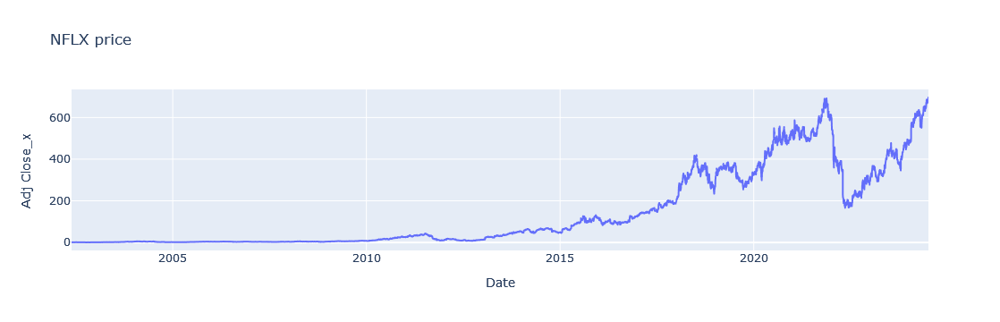

In [70]:
fig = px.line(df_nflx, x="Date", y="Adj Close_x", title='NFLX price')
fig.show()

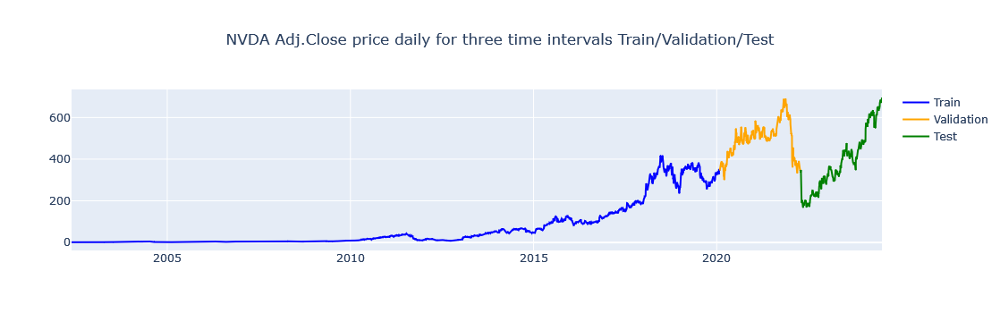

In [71]:
# TRAIN / VALIDATION/ TEST split

# Calculate the lengths of each split -- this is not temporal split, but based on the number of observations --> "classic" split with no shuffle
total_length = len(df_nflx)
train_length = int(0.8 * total_length)
val_length = int(0.1 * total_length)

# Split the data
train_data = df_nflx.iloc[:train_length]
val_data = df_nflx.iloc[train_length:train_length+val_length]
test_data = df_nflx.iloc[train_length+val_length:]

# Plot the data
fig = px.line(title='NVDA Adj.Close price daily for three time intervals Train/Validation/Test')
fig.add_scatter(x=train_data['Date'], y=train_data['Adj Close_x'], mode='lines', name='Train', line=dict(color='blue'))
fig.add_scatter(x=val_data['Date'], y=val_data['Adj Close_x'], mode='lines', name='Validation', line=dict(color='orange'))
fig.add_scatter(x=test_data['Date'], y=test_data['Adj Close_x'], mode='lines', name='Test', line=dict(color='green'))

# Update layout to center the title
fig.update_layout(title=dict(x=0.5))

fig.show()

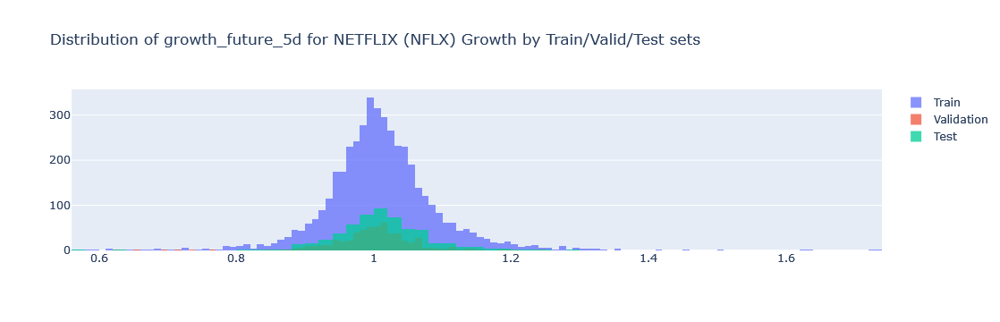

In [72]:
# HIST ON Netflix DATA Train/Test/Validation
import plotly.graph_objects as go

# Plot the data
fig = go.Figure()

# Add histograms for each split
fig.add_trace(go.Histogram(x=train_data['growth_future_5d'], name='Train', opacity=0.75))
fig.add_trace(go.Histogram(x=val_data['growth_future_5d'], name='Validation', opacity=0.75))
fig.add_trace(go.Histogram(x=test_data['growth_future_5d'], name='Test', opacity=0.75))

fig.update_layout(barmode='overlay', title='Distribution of growth_future_5d for NETFLIX (NFLX) Growth by Train/Valid/Test sets')
fig.update_traces(opacity=0.75)

fig.show()

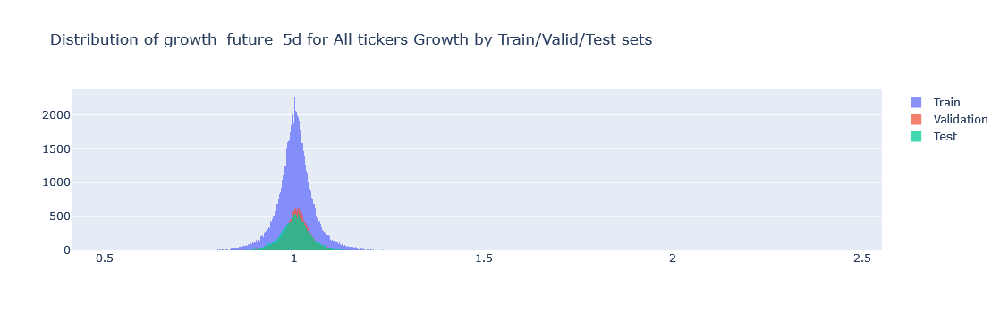

In [73]:
# HIST ON ALL DATA Train/Test/Validation
# comment: there are some outliers and hard co compare the distributions
import plotly.graph_objects as go

# Plot the data
fig = go.Figure()

# Add histograms for each split
fig.add_trace(go.Histogram(x=df_with_dummies[df_with_dummies.split=='train']['growth_future_5d'], name='Train', opacity=0.75))
fig.add_trace(go.Histogram(x=df_with_dummies[df_with_dummies.split=='validation']['growth_future_5d'], name='Validation', opacity=0.75))
fig.add_trace(go.Histogram(x=df_with_dummies[df_with_dummies.split=='test']['growth_future_5d'], name='Test', opacity=0.75))

fig.update_layout(barmode='overlay', title='Distribution of growth_future_5d for All tickers Growth by Train/Valid/Test sets')
fig.update_traces(opacity=0.75)

fig.show()

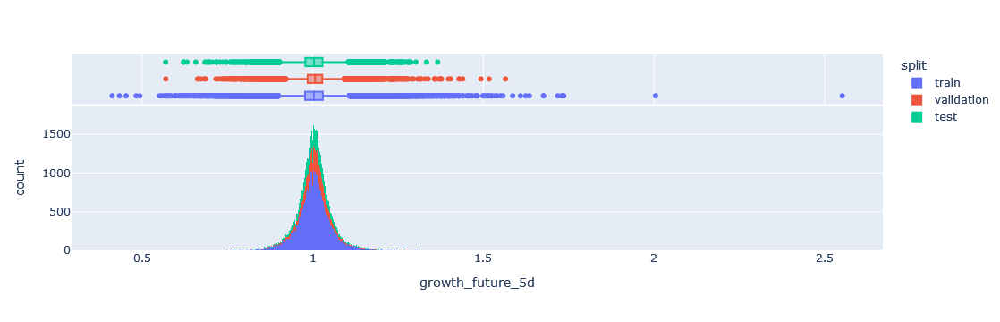

In [74]:
# Assuming df_with_dummies is your DataFrame containing the 'growth_future_5d' variable and 'split' column

# Create the histogram
fig = px.histogram(new_df,
                   x="growth_future_5d",
                   color="split",
                   marginal="box", # or violin, rug
                   )
                  #  hover_data=new_df.growth_future_5d)

# Show the histogram
fig.show()

In [75]:
new_df.groupby(by='split')['growth_future_5d'].describe()

,count,mean,std,min,25%,50%,75%,max
split,,,,,,,,
test,22950.0,1.003771,0.048679,0.569117,0.978188,1.003638,1.028466,1.366068
train,92106.0,1.004051,0.059813,0.412383,0.977363,1.003193,1.029456,2.551286
validation,23175.0,1.006144,0.047070,0.569541,0.984966,1.006656,1.027882,1.564756


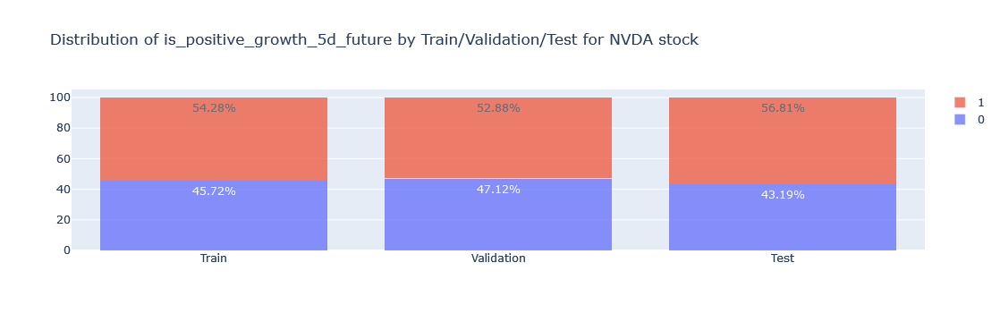

In [76]:
# is_positive_growth_5d_future: ONLY NFLX stock

# Count occurrences of 0 and 1 for each split
train_counts = train_data['is_positive_growth_5d_future'].value_counts(normalize=True)*100
val_counts = val_data['is_positive_growth_5d_future'].value_counts(normalize=True)*100
test_counts = test_data['is_positive_growth_5d_future'].value_counts(normalize=True)*100

# Plot the data
fig = go.Figure()

# # Add stacked bar charts for each split
# fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[0], val_counts[0], test_counts[0]], name='0'))
# fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[1], val_counts[1], test_counts[1]], name='1'))


# Add stacked bar charts for each split
fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[0], val_counts[0], test_counts[0]], name='0',
                     text=[f'{count:.2f}%' for count in [train_counts[0], val_counts[0], test_counts[0]]], textposition='auto'))
fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[1], val_counts[1], test_counts[1]], name='1',
                     text=[f'{count:.2f}%' for count in [train_counts[1], val_counts[1], test_counts[1]]], textposition='auto'))


fig.update_layout(barmode='stack', title='Distribution of is_positive_growth_5d_future by Train/Validation/Test for NVDA stock')
fig.update_traces(opacity=0.75)

fig.show()

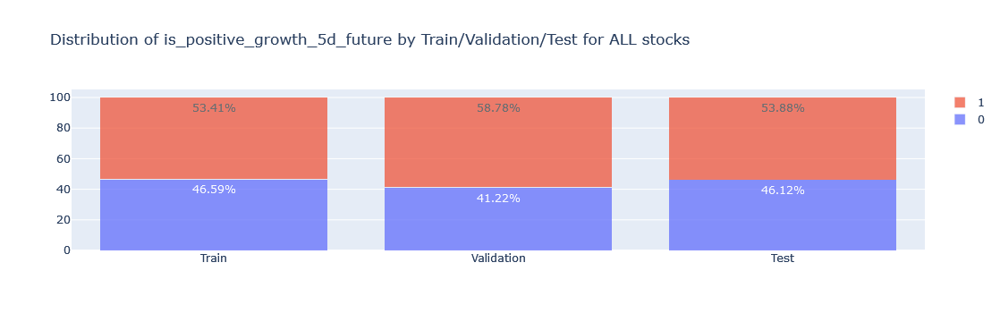

In [77]:
# ALL STOCKS: train/test/validation is more similar

# Count occurrences of 0 and 1 for each split
train_counts = df_with_dummies[df_with_dummies.split=='train']['is_positive_growth_5d_future'].value_counts(normalize=True)*100
val_counts = df_with_dummies[df_with_dummies.split=='validation']['is_positive_growth_5d_future'].value_counts(normalize=True)*100
test_counts = df_with_dummies[df_with_dummies.split=='test']['is_positive_growth_5d_future'].value_counts(normalize=True)*100

# Plot the data
fig = go.Figure()


# Add stacked bar charts for each split
fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[0], val_counts[0], test_counts[0]], name='0',
                     text=[f'{count:.2f}%' for count in [train_counts[0], val_counts[0], test_counts[0]]], textposition='auto'))
fig.add_trace(go.Bar(x=['Train', 'Validation', 'Test'], y=[train_counts[1], val_counts[1], test_counts[1]], name='1',
                     text=[f'{count:.2f}%' for count in [train_counts[1], val_counts[1], test_counts[1]]], textposition='auto'))


fig.update_layout(barmode='stack', title='Distribution of is_positive_growth_5d_future by Train/Validation/Test for ALL stocks')
fig.update_traces(opacity=0.75)

fig.show()

## Define dataframes for Modeling (ML) and cleane them

In [78]:
# Features to be used in predictions (incl. new dummies)

features_list = NUMERICAL+DUMMIES

to_predict = 'is_positive_growth_5d_future'

train_df = new_df[new_df.split.isin(['train'])].copy(deep=True)
valid_df = new_df[new_df.split.isin(['validation'])].copy(deep=True)
train_valid_df = new_df[new_df.split.isin(['train','validation'])].copy(deep=True)

test_df =  new_df[new_df.split.isin(['test'])].copy(deep=True)

# ONLY numerical Separate features and target variable for training and testing sets
X_train = train_df[features_list+[to_predict]]
X_valid = valid_df[features_list+[to_predict]]

X_train_valid = train_valid_df[features_list+[to_predict]]

X_test = test_df[features_list+[to_predict]]

# this to be used for predictions and join to the original dataframe new_df
X_all =  new_df[features_list+[to_predict]].copy(deep=True)

print(f'length: X_train {X_train.shape},  X_validation {X_valid.shape}, X_test {X_test.shape}, X_train_valid = {X_train_valid.shape},  all combined: X_all {X_all.shape}')

length: X_train (92106, 330),  X_validation (23175, 330), X_test (23075, 330), X_train_valid = (115281, 330),  all combined: X_all (138356, 330)


In [79]:
# Prepare a dataframe for ML:
  # +-inf to NaN, all NaNs to 0s
def clean_dataframe_from_inf_and_nan(df:pd.DataFrame):
  df.replace([np.inf, -np.inf], np.nan, inplace=True)
  df.fillna(0, inplace=True)
  return df

In [80]:
# Clean from +-inf and NaNs:

X_train = clean_dataframe_from_inf_and_nan(X_train)
X_valid = clean_dataframe_from_inf_and_nan(X_valid)
X_train_valid = clean_dataframe_from_inf_and_nan(X_train_valid)
X_test = clean_dataframe_from_inf_and_nan(X_test)
X_all = clean_dataframe_from_inf_and_nan(X_all)

C:\TEMP\ipykernel_65208\1289846688.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\TEMP\ipykernel_65208\1289846688.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
y_train = X_train[to_predict]

y_valid = X_valid[to_predict]

y_train_valid = X_train_valid[to_predict]
y_test = X_test[to_predict]
y_all =  X_all[to_predict]

# remove y_train, y_test from X_ dataframes
del X_train[to_predict]
del X_valid[to_predict]
del X_train_valid[to_predict]

del X_test[to_predict]

del X_all[to_predict]

## 1) Modeling

## 1.1) Manual 'rule of thumb' predictions

    (pred0) CCI>200 (binary, on technical indicator CCI)
    (pred1) growth_1d>1
    (pred2) (growth_1d>1) & (growth_snp500_1d>1)
    (pred3) (gdppot_us_yoy <= 0.027) & (fastd >= 0.251)
    (pred4) (gdppot_us_yoy >= 0.027) & (growth_wti_oil_30d <= 1.005)


In [82]:
# generate manual predictions
# Let's label all prediction features with prefix "pred"
new_df['pred0_manual_cci'] = (new_df.cci>200).astype(int)
new_df['pred1_manual_prev_g1'] = (new_df.growth_1d>1).astype(int)
new_df['pred2_manual_prev_g1_and_snp'] = ((new_df['growth_1d'] > 1) & (new_df['growth_snp500_1d'] > 1)).astype(int)
new_df['pred3_manual_gdp_and_fastd'] = ((new_df['gdppot_us_yoy'] <= 0.027) & (new_df['fastd'] >=0.251)).astype(int)
new_df['pred4_manual_gdp_and_wti30d'] = ((new_df['gdppot_us_yoy'] >= 0.027) & (new_df['growth_wti_oil_30d'] <= 1.005)).astype(int)

In [83]:
# example output manual predictions:
new_df[['cci','growth_1d','growth_snp500_1d','pred0_manual_cci','pred1_manual_prev_g1','pred2_manual_prev_g1_and_snp','pred3_manual_gdp_and_fastd','pred4_manual_gdp_and_wti30d', to_predict]]

,cci,growth_1d,growth_snp500_1d,pred0_manual_cci,pred1_manual_prev_g1,pred2_manual_prev_g1_and_snp,pred3_manual_gdp_and_fastd,pred4_manual_gdp_and_wti30d,is_positive_growth_5d_future
4816,233.615996,1.088753,0.990451,1,1,0,0,0,0
4817,111.233581,0.915690,0.961655,0,0,0,0,0,0
4818,123.026926,1.014633,1.001922,0,1,1,0,0,0
4819,-77.807849,0.913461,1.000956,0,0,0,0,0,1
4820,-81.712636,1.047369,1.027090,0,1,1,0,0,1
...,...,...,...,...,...,...,...,...,...
8059,-195.203031,0.982458,0.995916,0,0,0,1,0,0
8060,-218.834274,0.990751,1.002676,0,0,0,1,0,0
8061,-191.190475,0.996111,1.006195,0,0,0,1,0,0
8062,-158.440392,0.992581,1.005084,0,0,0,1,0,0


In [84]:
# Function to find all predictions (starting from 'pred'), generate is_correct (correctness of each prediction)
# and precision on TEST dataset (assuming there is df["split"] column with values 'train','validation','test'

# returns 2 lists of features: PREDICTIONS and IS_CORRECT

def get_predictions_correctness(df:pd.DataFrame, to_predict:str):
  PREDICTIONS = [k for k in df.keys() if k.startswith('pred')]
  print(f'Prediction columns founded: {PREDICTIONS}')

  # add columns is_correct_
  for pred in PREDICTIONS:
    part1 = pred.split('_')[0] # first prefix before '_'
    df[f'is_correct_{part1}'] =  (new_df[pred] == new_df[to_predict]).astype(int)

  # IS_CORRECT features set
  IS_CORRECT =  [k for k in df.keys() if k.startswith('is_correct_')]
  print(f'Created columns is_correct: {IS_CORRECT}')

  print('Precision on TEST set for each prediction:')
  # define "Precision" for ALL predictions on a Test dataset (~4 last years of trading)
  for i,column in enumerate(IS_CORRECT):
    prediction_column = PREDICTIONS[i]
    is_correct_column = column
    filter = (new_df.split=='test') & (new_df[prediction_column]==1)
    print(f'Prediction column:{prediction_column} , is_correct_column: {is_correct_column}')
    print(new_df[filter][is_correct_column].value_counts())
    print(new_df[filter][is_correct_column].value_counts()/len(new_df[filter]))
    print('---------')

  return PREDICTIONS, IS_CORRECT

In [85]:
PREDICTIONS, IS_CORRECT = get_predictions_correctness(df = new_df, to_predict = to_predict)

Prediction columns founded: ['pred0_manual_cci', 'pred1_manual_prev_g1', 'pred2_manual_prev_g1_and_snp', 'pred3_manual_gdp_and_fastd', 'pred4_manual_gdp_and_wti30d']
Created columns is_correct: ['is_correct_pred0', 'is_correct_pred1', 'is_correct_pred2', 'is_correct_pred3', 'is_correct_pred4']
Precision on TEST set for each prediction:
Prediction column:pred0_manual_cci , is_correct_column: is_correct_pred0
is_correct_pred0
1    321
0    251
Name: count, dtype: int64
is_correct_pred0
1    0.561189
0    0.438811
Name: count, dtype: float64
---------
Prediction column:pred1_manual_prev_g1 , is_correct_column: is_correct_pred1
is_correct_pred1
1    6370
0    5620
Name: count, dtype: int64
is_correct_pred1
1    0.531276
0    0.468724
Name: count, dtype: float64
---------
Prediction column:pred2_manual_prev_g1_and_snp , is_correct_column: is_correct_pred2
is_correct_pred2
1    4650
0    4260
Name: count, dtype: int64
is_correct_pred2
1    0.521886
0    0.478114
Name: count, dtype: float64
-

In [86]:
# run prediction correctness for 'is_positive_growth_5d_future' (should be lower)
new_df[PREDICTIONS+IS_CORRECT+[to_predict]]

,pred0_manual_cci,pred1_manual_prev_g1,pred2_manual_prev_g1_and_snp,pred3_manual_gdp_and_fastd,pred4_manual_gdp_and_wti30d,is_correct_pred0,is_correct_pred1,is_correct_pred2,is_correct_pred3,is_correct_pred4,is_positive_growth_5d_future
4816,1,1,0,0,0,0,0,1,1,1,0
4817,0,0,0,0,0,1,1,1,1,1,0
4818,0,1,1,0,0,1,0,0,1,1,0
4819,0,0,0,0,0,0,0,0,0,0,1
4820,0,1,1,0,0,0,1,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...
8059,0,0,0,1,0,1,1,1,0,1,0
8060,0,0,0,1,0,1,1,1,0,1,0
8061,0,0,0,1,0,1,1,1,0,1,0
8062,0,0,0,1,0,1,1,1,0,1,0


## 1.2) Decision Tree Classifier

### 1.2.1) Defining Functions to clean_df(), fit_decision_tree(), predict_decision_tree()
* here we discuss only the Decision Tree Classifier for binary predictions (and not the Regressor)

In [87]:
# ML models and utils
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score

# Disable SettingWithCopyWarning
pd.options.mode.chained_assignment = None  # default='warn'

In [88]:
# Estimation/fit function (using dataframe of features X and what to predict y) --> optimising total accuracy
# max_depth is hyperParameter
def fit_decision_tree(X, y, max_depth=20):
# Initialize the Decision Tree Classifier
  clf = DecisionTreeClassifier(max_depth=max_depth,
                               random_state=42)

  # Fit the classifier to the training data
  clf.fit(X, y)
  return clf, X.columns

In [89]:
%%time
clf_10, train_columns = fit_decision_tree(X=X_train_valid,
                           y=y_train_valid,
                           max_depth=10)

CPU times: total: 14.5 s
Wall time: 17.5 s


In [90]:
# predict on a full dataset
y_pred_all = clf_10.predict(X_all)

In [91]:
# defining a new prediction vector is easy now, as the dimensions will match
new_df['pred5_clf_10'] = y_pred_all

In [92]:
# new prediction is added --> need to recalculate the correctness
PREDICTIONS, IS_CORRECT = get_predictions_correctness(df = new_df, to_predict=to_predict)

Prediction columns founded: ['pred0_manual_cci', 'pred1_manual_prev_g1', 'pred2_manual_prev_g1_and_snp', 'pred3_manual_gdp_and_fastd', 'pred4_manual_gdp_and_wti30d', 'pred5_clf_10']
Created columns is_correct: ['is_correct_pred0', 'is_correct_pred1', 'is_correct_pred2', 'is_correct_pred3', 'is_correct_pred4', 'is_correct_pred5']
Precision on TEST set for each prediction:
Prediction column:pred0_manual_cci , is_correct_column: is_correct_pred0
is_correct_pred0
1    321
0    251
Name: count, dtype: int64
is_correct_pred0
1    0.561189
0    0.438811
Name: count, dtype: float64
---------
Prediction column:pred1_manual_prev_g1 , is_correct_column: is_correct_pred1
is_correct_pred1
1    6370
0    5620
Name: count, dtype: int64
is_correct_pred1
1    0.531276
0    0.468724
Name: count, dtype: float64
---------
Prediction column:pred2_manual_prev_g1_and_snp , is_correct_column: is_correct_pred2
is_correct_pred2
1    4650
0    4260
Name: count, dtype: int64
is_correct_pred2
1    0.521886
0    0.

## 1.2.2 Hyperparams tuning for a Decision Tree Classifier

In [93]:
# visualisation: decision tree for a few levels (max_depth variable)
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# https://stackoverflow.com/questions/20156951/how-do-i-find-which-attributes-my-tree-splits-on-when-using-scikit-learn
from sklearn.tree import export_text

In [94]:
%%time
# hyper params tuning for a Decision Tree

precision_by_depth = {}
best_precision = 0
best_depth = 0

for depth in range(1,21):
  print(f'Working with a tree of a max depth= {depth}')
  # fitting the tree on X_train, y_train
  clf,train_columns = fit_decision_tree(X=X_train_valid,
                           y=y_train_valid,
                           max_depth=depth) #applying custom hyperparam
  # getting the predictions for TEST and accuracy score
  y_pred_valid = clf.predict(X_valid)
  precision_valid = precision_score(y_valid, y_pred_valid)
  y_pred_test = clf.predict(X_test)
  precision_test = precision_score(y_test, y_pred_test)
  print(f'  Precision on test is {precision_test}, (precision on valid is {precision_valid} - tend to overfit)')
  # saving to the dict
  precision_by_depth[depth] = round(precision_test,4)
  # updating the best precision
  if precision_test >= best_precision:
    best_precision = round(precision_test,4)
    best_depth = depth
  # plot tree - long
  # plt.figure(figsize=(20,10))  # Set the size of the figure
  # plot_tree(clf,
  #           filled=True,
  #           feature_names=train_columns,
  #           class_names=['Negative', 'Positive'],
  #           max_depth=2)
  # plt.show()
  # plot tree - short
  tree_rules = export_text(clf, feature_names=list(X_train), max_depth=3)
  print(tree_rules)
  print('------------------------------')

print(f'All precisions by depth: {precision_by_depth}')
print(f'The best precision is {best_precision} and the best depth is {best_depth} ')

Working with a tree of a max depth= 1
  Precision on test is 0.5388082340195016, (precision on valid is 0.5877885652642935 - tend to overfit)
|--- DGS10 <= 2.98
|   |--- class: 1
|--- DGS10 >  2.98
|   |--- class: 1

------------------------------
Working with a tree of a max depth= 2
  Precision on test is 0.5398581560283688, (precision on valid is 0.5900896860986548 - tend to overfit)
|--- DGS10 <= 2.98
|   |--- growth_smh_30d <= 1.01
|   |   |--- class: 1
|   |--- growth_smh_30d >  1.01
|   |   |--- class: 1
|--- DGS10 >  2.98
|   |--- cpi_core_yoy <= 0.02
|   |   |--- class: 1
|   |--- cpi_core_yoy >  0.02
|   |   |--- class: 0

------------------------------
Working with a tree of a max depth= 3
  Precision on test is 0.5398581560283688, (precision on valid is 0.5900896860986548 - tend to overfit)
|--- DGS10 <= 2.98
|   |--- growth_smh_30d <= 1.01
|   |   |--- growth_smh_365d <= 1.21
|   |   |   |--- class: 1
|   |   |--- growth_smh_365d >  1.21
|   |   |   |--- class: 1
|   |--- 

In [95]:
# UNCOMMENT TO RUN SEE THE RESULTS
# Results of Hyper parameters tuning for a Decision Tree
print(precision_by_depth)

{1: 0.5388, 2: 0.5399, 3: 0.5399, 4: 0.5317, 5: 0.5336, 6: 0.5331, 7: 0.5284, 8: 0.5465, 9: 0.5433, 10: 0.5469, 11: 0.5342, 12: 0.5453, 13: 0.533, 14: 0.5365, 15: 0.5484, 16: 0.5434, 17: 0.5477, 18: 0.5488, 19: 0.5549, 20: 0.5426}


In [96]:
# pre-calculated results of Hyperparameter tuning: full dataset (300 features) and is_positive_growth_5d
precision_by_depth = {1: 0.5388, 2: 0.5399, 3: 0.5399, 4: 0.5317, 5: 0.5336, 6: 0.5331, 7: 0.5284, 8: 0.5465, 9: 0.5433, 10: 0.5469, 11: 0.5342, 12: 0.5453, 13: 0.533, 14: 0.5365, 15: 0.5484, 16: 0.5434, 17: 0.5477, 18: 0.5488, 19: 0.5549, 20: 0.5426}
best_depth = 19
best_precision = 0.5549

In [97]:
print(f'Best precision and depth = {best_depth}, precision (on test)={best_precision}')

Best precision and depth = 19, precision (on test)=0.5549


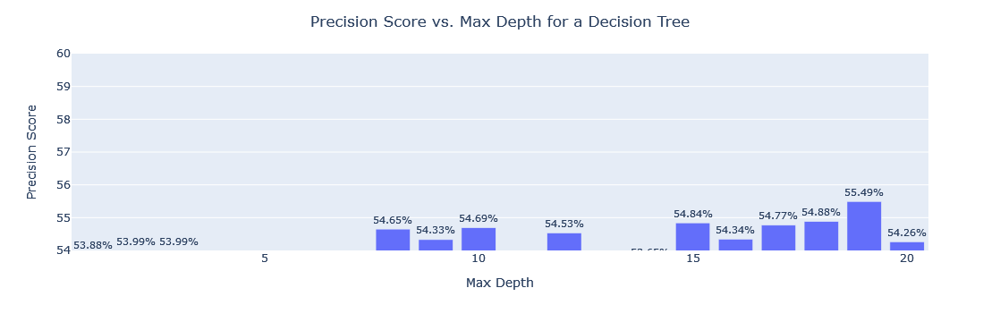

In [98]:
# Convert the dictionary to a DataFrame
df = pd.DataFrame(list(precision_by_depth.items()), columns=['max_depth', 'precision_score'])
df.loc[:,'precision_score'] = df.precision_score*100.0 # need for % visualisation

# Create the bar chart using Plotly Express
fig = px.bar(df,
             x='max_depth',
             y='precision_score',
            #  title='Precision Score vs. Max Depth for a Decision Tree',
             labels={'max_depth': 'Max Depth', 'precision_score': 'Precision Score'},
             range_y=[54, 60],
             text='precision_score')

# Update the text format to display as percentages
fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside')

# Center the title
fig.update_layout(title={'text': 'Precision Score vs. Max Depth for a Decision Tree', 'x': 0.5, 'xanchor': 'center'})


# Show the figure
fig.show()

In [99]:
%%time
clf_best,train_columns = fit_decision_tree(X=X_train_valid,
                           y=y_train_valid,
                           max_depth=best_depth)

CPU times: total: 19.9 s
Wall time: 27.4 s


In [100]:
# For a DecisionTreeClassifier in scikit-learn, the concept of trainable parameters differs from that of neural networks.
# In decision trees, the parameters are the structure of the tree itself (nodes and splits) rather than weights.
# However, you can still get a sense of the model's complexity by looking at the number of nodes and leaves.

# Here's how you can get this information for your trained DecisionTreeClassifier (referred to as clf_best):

# Get the number of nodes and leaves in the tree
n_nodes = clf_best.tree_.node_count
n_leaves = clf_best.get_n_leaves()

print(f"Number of nodes: {n_nodes}")
print(f"Number of leaves: {n_leaves}")

Number of nodes: 16477
Number of leaves: 8239


In [101]:
clf_best

DecisionTreeClassifier(max_depth=19, random_state=42)

In [102]:
# predict on a full dataset
y_pred_clf_best = clf_best.predict(X_all)

In [103]:
# defining a new prediction vector is easy now, as the dimensions will match
new_df['pred6_clf_best'] = y_pred_clf_best

In [104]:
# new prediction is added --> need to recalculate the correctness
PREDICTIONS, IS_CORRECT = get_predictions_correctness(df = new_df, to_predict=to_predict)

Prediction columns founded: ['pred0_manual_cci', 'pred1_manual_prev_g1', 'pred2_manual_prev_g1_and_snp', 'pred3_manual_gdp_and_fastd', 'pred4_manual_gdp_and_wti30d', 'pred5_clf_10', 'pred6_clf_best']
Created columns is_correct: ['is_correct_pred0', 'is_correct_pred1', 'is_correct_pred2', 'is_correct_pred3', 'is_correct_pred4', 'is_correct_pred5', 'is_correct_pred6']
Precision on TEST set for each prediction:
Prediction column:pred0_manual_cci , is_correct_column: is_correct_pred0
is_correct_pred0
1    321
0    251
Name: count, dtype: int64
is_correct_pred0
1    0.561189
0    0.438811
Name: count, dtype: float64
---------
Prediction column:pred1_manual_prev_g1 , is_correct_column: is_correct_pred1
is_correct_pred1
1    6370
0    5620
Name: count, dtype: int64
is_correct_pred1
1    0.531276
0    0.468724
Name: count, dtype: float64
---------
Prediction column:pred2_manual_prev_g1_and_snp , is_correct_column: is_correct_pred2
is_correct_pred2
1    4650
0    4260
Name: count, dtype: int64


## 1.3) Random Forest
https://scikit-learn.org/stable/modules/ensemble.html#random-forests-and-other-randomized-tree-ensembles

In [105]:
# (ALMOST 3 HOURS) UNCOMMENT BELOW TO RUN HYPERPARAMs optimisation again
# The best precision is 0.5538 and the best depth is 15
# CPU times: total: 2h 30min 39s
# Wall time: 11min

In [106]:
%%time
# hyper params tuning

precision_matrix = {}
best_precision = 0
best_depth = 0
best_estimators = 1

for depth in [15, 16, 17, 18, 19, 20]:
  for estimators in [50,100,200,500]:
    print(f'Working with HyperParams: depth = {depth}, estimators = {estimators}')

    # Start timing
    start_time = time.time()
    # fitting the tree on X_train, y_train
    rf = RandomForestClassifier(n_estimators = estimators,
                                max_depth = depth,
                                random_state = 42,
                                n_jobs = -1)

    rf = rf.fit(X_train_valid, y_train_valid)

    # getting the predictions for TEST and accuracy score
    y_pred_valid = rf.predict(X_valid)
    precision_valid = precision_score(y_valid, y_pred_valid)
    y_pred_test = rf.predict(X_test)
    precision_test = precision_score(y_test, y_pred_test)
    print(f'  Precision on test is {precision_test}, (precision on valid is {precision_valid} - tend to overfit)')

    # saving to the dict
    precision_matrix[depth, estimators] = round(precision_test,4)

    # Measure elapsed time
    elapsed_time = time.time() - start_time
    print(f'Time for training: {elapsed_time:.2f} seconds, or {elapsed_time/60:.2f} minutes')

    # updating the best precision
    if precision_test >= best_precision:
      best_precision = round(precision_test,4)
      best_depth = depth
      best_estimators = estimators
      print(f'New best precision found for depth={depth}, estimators = {estimators}')

    print('------------------------------')

print(f'Matrix of precisions: {precision_matrix}')
print(f'The best precision is {best_precision} and the best depth is {best_depth} ')

Working with HyperParams: depth = 15, estimators = 50
  Precision on test is 0.5479560526576265, (precision on valid is 0.7967039504997621 - tend to overfit)
Time for training: 6.03 seconds, or 0.10 minutes
New best precision found for depth=15, estimators = 50
------------------------------
Working with HyperParams: depth = 15, estimators = 100
  Precision on test is 0.5512877245773963, (precision on valid is 0.8010624328518563 - tend to overfit)
Time for training: 11.96 seconds, or 0.20 minutes
New best precision found for depth=15, estimators = 100
------------------------------
Working with HyperParams: depth = 15, estimators = 200
  Precision on test is 0.5538490530481485, (precision on valid is 0.7988703923900119 - tend to overfit)
Time for training: 21.62 seconds, or 0.36 minutes
New best precision found for depth=15, estimators = 200
------------------------------
Working with HyperParams: depth = 15, estimators = 500
  Precision on test is 0.5468933707153839, (precision on val

In [107]:
print(precision_matrix)

{(15, 50): 0.548, (15, 100): 0.5513, (15, 200): 0.5538, (15, 500): 0.5469, (16, 50): 0.5419, (16, 100): 0.5451, (16, 200): 0.5456, (16, 500): 0.5483, (17, 50): 0.5476, (17, 100): 0.5437, (17, 200): 0.5441, (17, 500): 0.5479, (18, 50): 0.5326, (18, 100): 0.5383, (18, 200): 0.5388, (18, 500): 0.545, (19, 50): 0.5422, (19, 100): 0.5489, (19, 200): 0.5519, (19, 500): 0.5471, (20, 50): 0.545, (20, 100): 0.5458, (20, 200): 0.5465, (20, 500): 0.5506}


In [108]:
# pre-calculated best precision matrix (max_depth, n_estimators) for Random Forest for a full dataset (300 features) and is_positive_future_growth_5d
best_precision_matrix_random_forest = {(15, 50): 0.548, (15, 100): 0.5513, (15, 200): 0.5538, (15, 500): 0.5469, (16, 50): 0.5419, (16, 100): 0.5451, (16, 200): 0.5456, (16, 500): 0.5483, (17, 50): 0.5476, (17, 100): 0.5437, (17, 200): 0.5441, (17, 500): 0.5479, (18, 50): 0.5326, (18, 100): 0.5383, (18, 200): 0.5388, (18, 500): 0.545, (19, 50): 0.5422, (19, 100): 0.5489, (19, 200): 0.5519, (19, 500): 0.5471, (20, 50): 0.545, (20, 100): 0.5458, (20, 200): 0.5465, (20, 500): 0.5506}


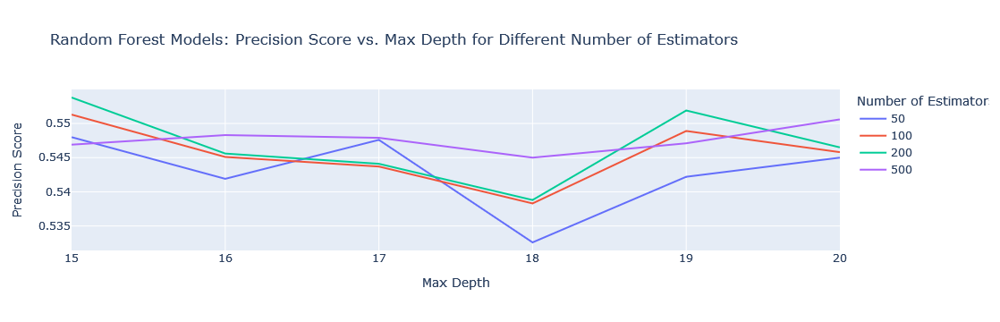

In [109]:
# Convert data to DataFrame
df = pd.DataFrame.from_dict(best_precision_matrix_random_forest, orient='index', columns=['precision_score']).reset_index()

# Rename the columns for clarity
df.columns = ['max_depth_and_metric', 'precision_score']

# Separate the tuple into two columns
df[['max_depth', 'n_estimators']] = pd.DataFrame(df['max_depth_and_metric'].tolist(), index=df.index)

# Drop the combined column
df = df.drop(columns=['max_depth_and_metric'])

# Create line plot using Plotly Express
fig = px.line(df, x='max_depth', y='precision_score', color='n_estimators',
              labels={'max_depth': 'Max Depth', 'precision_score': 'Precision Score', 'n_estimators': 'Number of Estimators'},
              title='Random Forest Models: Precision Score vs. Max Depth for Different Number of Estimators')

# Adjust x-axis range
fig.update_xaxes(range=[15, 20])

# Show the figure
fig.show()

In [110]:
%%time

# Suboptimal Predictor with less (than optimal) Estimators (200) and lower Max_Depth (17)
# several minutes to compute (6 min)

rf_best = RandomForestClassifier(n_estimators = 200,
                                 max_depth = 17,
                                 random_state = 42,
                                 n_jobs = -1)

rf_best = rf_best.fit(X_train_valid, y_train_valid)

CPU times: total: 5min 54s
Wall time: 24.7 s


## 1.4 Logistic Regression

https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html

There can be many reasons when Logistic Regression does not converge: https://forecastegy.com/posts/how-to-solve-logistic-regression-not-converging-in-scikit-learn/

In [111]:
from sklearn.linear_model import LogisticRegression

precision_matrix = {}
best_precision = 0
best_C = 0
best_iter = 0

for c in [1, 0.1, 0.01]:
  for iter in [50, 100, 200]:
    print(f'Working with HyperParams: C = {c} (positive float, smaller = stronger regularization), max_iter={iter}')
    # fitting the tree on X_train, y_train
      # hyperParam C should be between 0 and 1
    lr = LogisticRegression(C=c,
                            random_state=42,
                            max_iter=iter,
                            solver='sag',
                            n_jobs=-1)

    lr = lr.fit(X_train_valid, y_train_valid)

    # getting the predictions for TEST and accuracy score
    y_pred_valid = lr.predict(X_valid)
    precision_valid = precision_score(y_valid, y_pred_valid)
    y_pred_test = lr.predict(X_test)
    precision_test = precision_score(y_test, y_pred_test)
    print(f'  Precision on test is {precision_test}, (precision on valid is {precision_valid} - tend to overfit)')
    # saving to the dict
    precision_matrix[(c,iter)] = round(precision_test,4)
    # updating the best precision
    if precision_test >= best_precision:
      best_precision = round(precision_test,4)
      best_C = c
      best_iter = iter
      print(f'New best precision found for C={c}')
      print('------------------------------')

print(f'Matrix of precisions: {precision_matrix}')
print(f'The best precision is {best_precision} and the best C is {best_C}, best max_iter = {best_iter}  ')

Working with HyperParams: C = 1 (positive float, smaller = stronger regularization), max_iter=50


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.541640120141986, (precision on valid is 0.586360266864344 - tend to overfit)
New best precision found for C=1
------------------------------
Working with HyperParams: C = 1 (positive float, smaller = stronger regularization), max_iter=100


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.5418833835203942, (precision on valid is 0.5861039869433434 - tend to overfit)
New best precision found for C=1
------------------------------
Working with HyperParams: C = 1 (positive float, smaller = stronger regularization), max_iter=200


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.5422628571428572, (precision on valid is 0.5863911148601153 - tend to overfit)
New best precision found for C=1
------------------------------
Working with HyperParams: C = 0.1 (positive float, smaller = stronger regularization), max_iter=50


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.541640120141986, (precision on valid is 0.586360266864344 - tend to overfit)
Working with HyperParams: C = 0.1 (positive float, smaller = stronger regularization), max_iter=100


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.5418833835203942, (precision on valid is 0.5861039869433434 - tend to overfit)
Working with HyperParams: C = 0.1 (positive float, smaller = stronger regularization), max_iter=200


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.5422628571428572, (precision on valid is 0.5863911148601153 - tend to overfit)
Working with HyperParams: C = 0.01 (positive float, smaller = stronger regularization), max_iter=50


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.541640120141986, (precision on valid is 0.586360266864344 - tend to overfit)
Working with HyperParams: C = 0.01 (positive float, smaller = stronger regularization), max_iter=100


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



  Precision on test is 0.5418833835203942, (precision on valid is 0.5861039869433434 - tend to overfit)
Working with HyperParams: C = 0.01 (positive float, smaller = stronger regularization), max_iter=200
  Precision on test is 0.5422628571428572, (precision on valid is 0.5863911148601153 - tend to overfit)
Matrix of precisions: {(1, 50): 0.5416, (1, 100): 0.5419, (1, 200): 0.5423, (0.1, 50): 0.5416, (0.1, 100): 0.5419, (0.1, 200): 0.5423, (0.01, 50): 0.5416, (0.01, 100): 0.5419, (0.01, 200): 0.5423}
The best precision is 0.5423 and the best C is 1, best max_iter = 200  


C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



In [112]:
# UNCOMMENT TO SEE THE RESULTS OF THE RUN
print(precision_matrix)

{(1, 50): 0.5416, (1, 100): 0.5419, (1, 200): 0.5423, (0.1, 50): 0.5416, (0.1, 100): 0.5419, (0.1, 200): 0.5423, (0.01, 50): 0.5416, (0.01, 100): 0.5419, (0.01, 200): 0.5423}


In [113]:
# Params on C, iter
best_precision_matrix_logistic_regression = {(1, 50): 0.5416, (1, 100): 0.5419, (1, 200): 0.5423, (0.1, 50): 0.5416, (0.1, 100): 0.5419, (0.1, 200): 0.5423, (0.01, 50): 0.5416, (0.01, 100): 0.5419, (0.01, 200): 0.5423}

In [114]:
list(best_precision_matrix_logistic_regression.items())[2]

((1, 200), 0.5423)

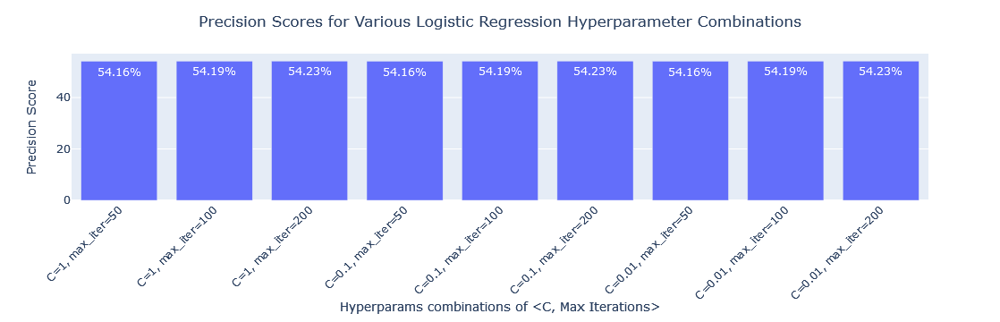

In [115]:
# Visualise precision scores

# Prepare the data
rows = []
for key, value in list(best_precision_matrix_logistic_regression.items()):
    C, max_iter = key
    combination_label = f'C={C}, max_iter={max_iter}'
    rows.append({'Combination': combination_label, 'Precision': value})

df = pd.DataFrame(rows)
df.loc[:,'Precision'] = df.Precision*100.0 # need for % visualisation

# Create the bar chart
fig = px.bar(df,
             x='Combination',
             y='Precision',
             text='Precision'
             )

# Customize the layout for better readability
fig.update_layout(
    xaxis_title='Hyperparams combinations of <C, Max Iterations>',
    yaxis_title='Precision Score',
    xaxis_tickangle=-45,
    title={
        'text': 'Precision Scores for Various Logistic Regression Hyperparameter Combinations',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)


# Update the text position
fig.update_traces(texttemplate='%{text:.2f}%',
                  textposition='inside',
                  textfont_color='white')

# Show the figure
fig.show()

## 1.5) ADVANCED: Deep Neural Network (DNN) and hyperparams tuning¶

    Tutorial from Tensorflow.org
    TowardsDataScience Hyperparameter Optimization with Keras
    Machine Learning Mastery tutorial with Keras Deep Learning

In [116]:
# https://towardsdatascience.com/hyperparameter-optimization-with-keras-b82e6364ca53

# Extended params set

# p = {'lr': [0.01, 0.03,0.1, 0.3,1,3,10],
#      'first_neuron': [0,16,32,64,128,256],
#      'second_neuron':[0,16,32,64,128,256],
#      'first_dropout':[0,0.2,0.3],
#      'second_dropout':[0,0.2,0.3],
#      'activation_first':['relu','sigmoid','linear'],
#      'activation_second':['relu','sigmoid','linear'],
#     #  'activation_first':('relu','elu','tanh','sigmoid','linear','softplus','selu', 'softsign','exponential'),
#     #  'activation_second':('relu','elu','tanh','sigmoid','linear','softplus','selu', 'softsign','exponential'),
#     #  'batch_size':(2,30,10),
#     #  'loss': ('mse','mae'),
#     #  'epochs':[150],
#     #  'shape': ['brick','long_funnel'],
#      'optimizer':['adam', 'nadam', 'rmaprop','sgd'],
#     #  'losses': [logcosh, binary_crossentropy],
#     #  'last_activation':[sigmoid]
#      }


# Reduced params set and available options
p = {'lr': [0.1],
     'first_neuron': [12,24,32,48,96, 128, 196, 256],
     'second_neuron':[12,24,32,48,96, 128, 196, 256],
     'first_dropout':[0.1],
     'second_dropout':[0.1],
     'activation_first':['relu','sigmoid','softplus','tanh'],
     'activation_second':['relu'],
    #  'activation_first':('relu','elu','tanh','sigmoid','linear','softplus','selu', 'softsign','exponential'),
    #  'activation_second':('relu','elu','tanh','sigmoid','linear','softplus','selu', 'softsign','exponential'),
    #  'batch_size':(2,30,10),
    #  'loss': ('mse','mae'),
    #  'epochs':[150],
    #  'shape': ['brick','long_funnel'],
     'optimizer':['adam','nadam','sgd','rmaprop'],
    #  'losses': [logcosh, binary_crossentropy],
    #  'last_activation':[sigmoid]
     }


# Number of models to run and write to SHEETS:
count_models=0

nn_params = {}

for lr in p['lr']:
  for first_neuron in p['first_neuron']:
    for second_neuron in p['second_neuron']:
      for first_dropout in p['first_dropout']:
        for second_dropout in p['second_dropout']:
          for activation_first in p['activation_first']:
            for activation_second in p['activation_second']:
              for optimizer in p['optimizer']:
                # print(lr,first_neuron,second_neuron,first_dropout,second_dropout,activation_first,activation_second,optimizer,sep='/')
                count_models=count_models+1
                nn_params['learning_rate'] = lr
                nn_params['first_layer_neurons'] = first_neuron
                nn_params['first_layer_dropout'] = first_dropout
                nn_params['second_layer_neurons'] = second_neuron
                nn_params['second_layer_dropout'] = second_dropout
                nn_params['activation_first_layer'] = activation_first
                nn_params['activation_second_layer'] = activation_second
                nn_params['optimizer'] = optimizer
                # features count as an input shape
                nn_params['input_shape'] = len(X_train.keys())

# Current set of models to try
print(count_models)

1024


In [117]:
nn_params

{'learning_rate': 0.1,
 'first_layer_neurons': 256,
 'first_layer_dropout': 0.1,
 'second_layer_neurons': 256,
 'second_layer_dropout': 0.1,
 'activation_first_layer': 'tanh',
 'activation_second_layer': 'relu',
 'optimizer': 'rmaprop',
 'input_shape': 329}

In [118]:
import tensorflow as tf
import keras
from keras import layers
# from keras.models import Sequential
# from keras.layers import Dense, Input, Dropout, Activation

In [119]:
# building one Neural Network when Parameters are known:
import datetime

# len(rez_train.keys())
def build_model(nn_params):
  # lr, first_neuron, second_neuron, first_dropout, second_dropout, activation_first, activation_second, optimizer
  model = keras.Sequential([
  layers.Dense(nn_params['first_layer_neurons'],
               activation=nn_params['activation_first_layer'],
               input_shape=[nn_params['input_shape']]),
  layers.Dropout(nn_params['first_layer_dropout']),
  layers.Dense(nn_params['second_layer_neurons'],
               activation=nn_params['activation_second_layer']),
  layers.Dropout(nn_params['second_layer_dropout']),
  layers.Dense(1, activation='sigmoid') # sigmoid is important for a Neural Network
  ])

  if optimizer == 'adam':
    opt = keras.optimizers.Adam(lr)
  elif optimizer == 'nadam':
    opt = keras.optimizers.Nadam(lr)
  elif optimizer == 'rmsprop':
    opt = keras.optimizers.RMSprop(lr)
  elif optimizer == 'sgd':
    opt = keras.optimizers.SGD(lr)
  else:
    opt = keras.optimizers.Adagrad(lr)
  model.compile(loss='binary_crossentropy', # mae/rmse for the Regression,
                optimizer=opt,
                metrics=['accuracy',keras.metrics.Precision()]) # or use [keras.metrics.Precision()] for a binary model : https://keras.io/api/metrics/classification_metrics/#precision-class
  return model

In [120]:
nn_params

{'learning_rate': 0.1,
 'first_layer_neurons': 256,
 'first_layer_dropout': 0.1,
 'second_layer_neurons': 256,
 'second_layer_dropout': 0.1,
 'activation_first_layer': 'tanh',
 'activation_second_layer': 'relu',
 'optimizer': 'rmaprop',
 'input_shape': 329}

In [121]:
model = build_model(nn_params)
model.summary()
# model.get_config()

C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 256)                 │          84,480 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │             257 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 150,529 (588.00 KB)

 Trainable params: 150,529 (588.00 KB)

 Non-trainable params: 0 (0.00 B)

In [122]:
# trainable params in the model with max params (largest hidden layers size)
model.count_params()

150529

In [123]:
# Display training progress by printing a single dot for each completed epoch
class PrintDot(keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs):
    if epoch % 100 == 0: print()
    print('.', end='')

In [124]:
# read tutorial about Binary Classification with Neural Network
# https://machinelearningmastery.com/binary-classification-tutorial-with-the-keras-deep-learning-library/
# https://www.tensorflow.org/api_docs/python/tf/keras/Model#fit


# HYPER_PARAMS_SPACE = PARAMS space
# WHEN MAX_MODELS>0: return after MAX_MODELS checked
# MAX_EPOCHS: how many epochs (periods when model weights are updated) do we need?
def train_neural_network_with_hyperparams(HYPER_PARAMS_SPACE, MAX_MODELS=0, MAX_EPOCHS=250, EARLY_STOPPING_PATIENCE=20):

  # The patience parameter is the amount of epochs to check for improvement
  early_stop = keras.callbacks.EarlyStopping(monitor='val_accuracy',  # we want accuracy to improve every single iteration (or at least in several iterations (EARLY STOPPING PARAM))
                                             patience = EARLY_STOPPING_PATIENCE)
  nn_params = {} # current hyperParams settings
  cur = 0 # models trained

  # best stats
  best_accuracy = 0
  best_model = None
  best_history = None

  for lr in HYPER_PARAMS_SPACE['lr']:
    for first_dropout in HYPER_PARAMS_SPACE['first_dropout']:
      for second_dropout in HYPER_PARAMS_SPACE['second_dropout']:
        for activation_first in HYPER_PARAMS_SPACE['activation_first']:
          for activation_second in HYPER_PARAMS_SPACE['activation_second']:
            for optimizer in HYPER_PARAMS_SPACE['optimizer']:
              for first_neuron in HYPER_PARAMS_SPACE['first_neuron']:
                for second_neuron in HYPER_PARAMS_SPACE['second_neuron']:
                  cur = cur+1

                  nn_params['learning_rate'] = lr
                  nn_params['first_layer_neurons'] = first_neuron
                  nn_params['first_layer_dropout'] = first_dropout
                  nn_params['second_layer_neurons'] = second_neuron
                  nn_params['second_layer_dropout'] = second_dropout
                  nn_params['activation_first_layer'] = activation_first
                  nn_params['activation_second_layer'] = activation_second
                  nn_params['optimizer'] = optimizer

                  # features count as an input shape
                  nn_params['input_shape'] = len(X_train.keys())

                  print(f'Using HyperParams:{nn_params}')

                  model = build_model(nn_params)
                  # model.summary()

                  frame = pd.DataFrame(data=[cur,lr,first_neuron,second_neuron,first_dropout,second_dropout, activation_first, activation_second, optimizer])

                  print(f"Training model {cur} with trainable params {model.count_params()} :")
                  t_start = datetime.datetime.now()
                  history = model.fit(
                                        X_train_valid,
                                        y_train_valid,
                                        epochs=MAX_EPOCHS,
                                        validation_data = (X_test, y_test),
                                        verbose=1, #change to 0 if you don't want to see the progress
                                        callbacks=[early_stop,PrintDot()])

                  t_diff = datetime.datetime.now() - t_start
                  frame = pd.DataFrame(data=[t_diff.seconds,
                                          len(history.epoch),
                                          history.history['val_accuracy'][0], # start of learning
                                          history.history['val_accuracy'][len(history.epoch)-1], # end of learning
                                          #  history.history['val_precision_2'][0], # start of learning
                                          #  history.history['val_precision_2'][len(history.epoch)-1], # end of learning
                                          ])

                  if history.history['val_accuracy'][len(history.epoch)-1]> best_accuracy:
                    best_accuracy = history.history['val_accuracy'][len(history.epoch)-1]
                    best_model = model
                    best_history = history

                  # early stopping of hyper params loop
                  if MAX_MODELS>0 and cur>=MAX_MODELS:
                    return best_model, best_history.history

                  print('==============================================================')

  return best_model, best_history.history #full hyper params search on all models

In [125]:
# returns best_model (trained) and best_history (history of train operations)
best_model, best_history = train_neural_network_with_hyperparams(HYPER_PARAMS_SPACE=p,
                                                                 MAX_MODELS=2, #not more than 2 models
                                                                 MAX_EPOCHS=250,
                                                                 EARLY_STOPPING_PATIENCE=10
                                                                 )

Using HyperParams:{'learning_rate': 0.1, 'first_layer_neurons': 12, 'first_layer_dropout': 0.1, 'second_layer_neurons': 12, 'second_layer_dropout': 0.1, 'activation_first_layer': 'relu', 'activation_second_layer': 'relu', 'optimizer': 'adam', 'input_shape': 329}
Training model 1 with trainable params 4129 :
Epoch 1/250
3594/3603 ━━━━━━━━━━━━━━━━━━━━ 0s 855us/step - accuracy: 0.5419 - loss: 4924309.0000 - precision_1: 0.5451
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.5419 - loss: 4912846.0000 - precision_1: 0.5451 - val_accuracy: 0.5398 - val_loss: 1167.2076 - val_precision_1: 0.5397
Epoch 2/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 989us/step - accuracy: 0.5430 - loss: 23220.8848 - precision_1: 0.5464 - val_accuracy: 0.5398 - val_loss: 363.1032 - val_precision_1: 0.5398
Epoch 3/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 995us/step - accuracy: 0.5437 - loss: 24589.4551 - precision_1: 0.5459 - val_accuracy: 0.5389 - val_loss: 428.0568 - val_precision_1: 0.5392
Epoch 4/250
3603/3603 

C:\Users\msofy\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



3595/3603 ━━━━━━━━━━━━━━━━━━━━ 0s 856us/step - accuracy: 0.5370 - loss: 9495736.0000 - precision_2: 0.5446
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.5370 - loss: 9475485.0000 - precision_2: 0.5446 - val_accuracy: 0.5389 - val_loss: 280.8173 - val_precision_2: 0.5391
Epoch 2/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 988us/step - accuracy: 0.5446 - loss: 17423.1543 - precision_2: 0.5463 - val_accuracy: 0.5389 - val_loss: 39.9263 - val_precision_2: 0.5390
Epoch 3/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 976us/step - accuracy: 0.5434 - loss: 8949.9922 - precision_2: 0.5446 - val_accuracy: 0.5388 - val_loss: 1.0080 - val_precision_2: 0.5388
Epoch 4/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 984us/step - accuracy: 0.5417 - loss: 11540.9648 - precision_2: 0.5432 - val_accuracy: 0.5388 - val_loss: 0.6904 - val_precision_2: 0.5388
Epoch 5/250
3603/3603 ━━━━━━━━━━━━━━━━━━━━ 4s 976us/step - accuracy: 0.5435 - loss: 7260.2241 - precision_2: 0.5443 - val_accuracy: 0.5388 - val_loss: 0.6902 - val

In [126]:
# UNCOMMENT WHEN RUN AGAIN

best_history_nn = best_history
best_model_nn = best_model

In [127]:
print(best_history_nn)

{'accuracy': [0.5428908467292786, 0.54167640209198, 0.5422489643096924, 0.5428995490074158, 0.5442613959312439, 0.5437235832214355, 0.5444522500038147, 0.5443568229675293, 0.5438970923423767, 0.5440185070037842, 0.5447558760643005], 'loss': [792357.4375, 26819.9609375, 15651.6337890625, 6932.64892578125, 4787.25244140625, 2282.64794921875, 773.1577758789062, 1049.0533447265625, 760.0621948242188, 375.13958740234375, 354.64697265625], 'precision_1': [0.5453096032142639, 0.5446481108665466, 0.5447010397911072, 0.5448850393295288, 0.5452718734741211, 0.5449947118759155, 0.5453680157661438, 0.5452243089675903, 0.5449956059455872, 0.5449047088623047, 0.5453396439552307], 'val_accuracy': [0.5398483276367188, 0.539804995059967, 0.5388515591621399, 0.5385482311248779, 0.5389382243156433, 0.5388082265853882, 0.5388082265853882, 0.5388082265853882, 0.5388082265853882, 0.5387648940086365, 0.5388082265853882], 'val_loss': [1167.2076416015625, 363.1031799316406, 428.0567626953125, 42.7900390625, 61

In [128]:
print(best_model_nn)

<Sequential name=sequential_1, built=True>


In [129]:
best_model_nn.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_3 (Dense)                      │ (None, 12)                  │           3,960 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 12)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 12)                  │             156 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 12)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 1)                   │              13 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 8,260 (32.27 KB)

 Trainable params: 4,129 (16.13 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,131 (16.14 KB)

In [143]:
best_history_nn = {
    'accuracy': [
        0.5428908467292786, 0.54167640209198, 0.5422489643096924, 0.5428995490074158, 0.5442613959312439, 
        0.5437235832214355, 0.5444522500038147, 0.5443568229675293, 0.5438970923423767, 0.5440185070037842, 
        0.5447558760643005
    ],
    'loss': [
        792357.4375, 26819.9609375, 15651.6337890625, 6932.64892578125, 4787.25244140625, 
        2282.64794921875, 773.1577758789062, 1049.0533447265625, 760.0621948242188, 375.13958740234375, 
        354.64697265625
    ],
    'precision_1': [
        0.5453096032142639, 0.5446481108665466, 0.5447010397911072, 0.5448850393295288, 0.5452718734741211, 
        0.5449947118759155, 0.5453680157661438, 0.5452243089675903, 0.5449956059455872, 0.5449047088623047, 
        0.5453396439552307
    ],
    'val_accuracy': [
        0.5398483276367188, 0.539804995059967, 0.5388515591621399, 0.5385482311248779, 0.5389382243156433, 
        0.5388082265853882, 0.5388082265853882, 0.5388082265853882, 0.5388082265853882, 0.5387648940086365, 
        0.5388082265853882
    ],
    'val_loss': [
        1167.2076416015625, 363.1031799316406, 428.0567626953125, 42.7900390625, 61.07721710205078, 
        69.17364501953125, 32.67719268798828, 18.833219528198242, 9.72400951385498, 13.74802017211914, 
        9.53062629699707
    ],
    'val_precision_1': [
        0.5396790504455566, 0.5397806763648987, 0.5391779541969299, 0.53935706615448, 0.5394147038459778, 
        0.5388082265853882, 0.5388116240501404, 0.5388082265853882, 0.5388116240501404, 0.5393164753913879, 
        0.5388082265853882
    ]
}

In [144]:
X_train_valid.shape

(115281, 329)

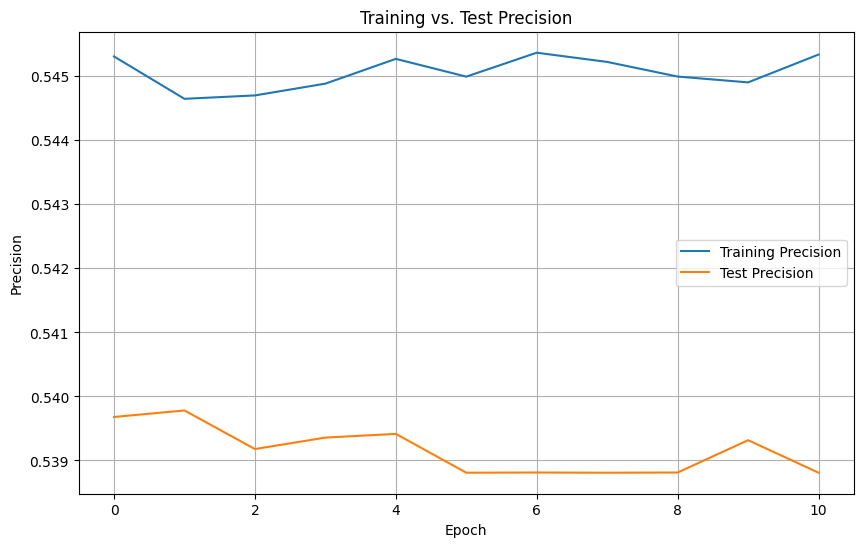

In [145]:
# Learning visualisation for the Deep Neural Network (DNN)
# The model is not actually training, as the precision and accuracy score are not improving on TRAIN/TEST with more Epochs

# Plotting accuracy
plt.figure(figsize=(10, 6))
plt.plot(best_history_nn['precision_1'], label='Training Precision')
plt.plot(best_history_nn['val_precision_1'], label='Test Precision')
plt.xlabel('Epoch')
plt.ylabel('Precision')
plt.title('Training vs. Test Precision')
plt.legend()
plt.grid(True)
plt.show()

## 2) Different Decision rules to improve precision (varying threshold)

best model1 (clf_best): Decision Tree (max_depth=19)(best precision=0.5549) best model2 (rf_best): Random Forest (n_estimators=200, max_depth=15)
(best precision=0.5538)

## 2.1. Predicting probabilities (predict_proba), getting the distribution for probabilities, and new decision rules

In [133]:
# y_pred_test = best_lr.predict_proba(X_test)

# predicting probability instead of a lable

y_pred_test = clf_best.predict_proba(X_test)
y_pred_test_class1 = [k[1] for k in y_pred_test] # k[1] is the second element in the list of Class predictions

In [134]:
# example prediction of probabilities
y_pred_test

array([[0.00566572, 0.99433428],
       [0.96296296, 0.03703704],
       [0.        , 1.        ],
       ...,
       [0.        , 1.        ],
       [1.        , 0.        ],
       [1.        , 0.        ]])

In [135]:
y_pred_test_class1_df = pd.DataFrame(y_pred_test_class1, columns=['Class1_probability'])
y_pred_test_class1_df.head()

,Class1_probability
0,0.994334
1,0.037037
2,1.000000
3,1.000000
4,1.000000


In [136]:
# Mean prediction is 0.52, median is 0.58, 75% quantile is 0.75
y_pred_test_class1_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Class1_probability,23075.0,0.453605,0.474824,0.0,0.0,0.065574,1.0,1.0


In [137]:
# Unconditional probability of a positive growth is 55.5%
y_test.sum()/y_test.count()

0.5388082340195016

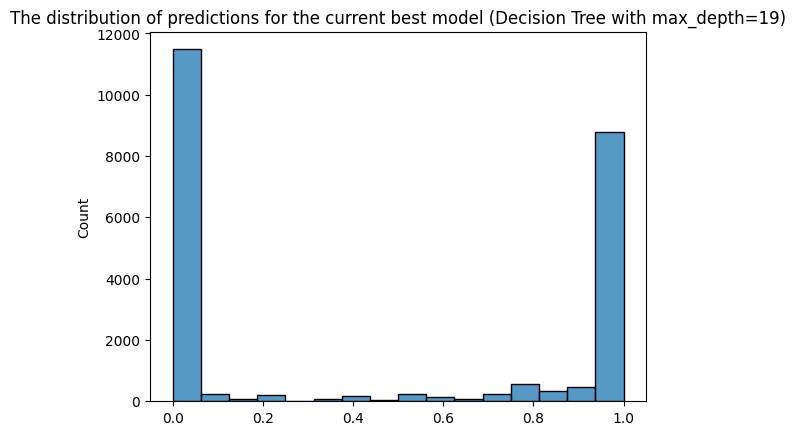

In [138]:
import seaborn as sns

sns.histplot(y_pred_test_class1)

# Add a title
plt.title('The distribution of predictions for the current best model (Decision Tree with max_depth=19)')

# Show the plot
plt.show()

In [139]:
# tpr (True Positive Rate) vs. fpr (False Positive Rate) dataframe
# tp = True Positive
# tn = True Negative
# fp = False Positive
# fn = False Negative
# Decision Rule :  "y_pred>= Threshold" for Class "1"

# when only_even=True --> we'll have a step ==0.02 and leave only even records

def tpr_fpr_dataframe(y_true, y_pred, only_even=False):
    scores = []

    if only_even==False:
      thresholds = np.linspace(0, 1, 101) #[0, 0.01, 0.02, ...0.99,1.0]
    else:
      thresholds = np.linspace(0, 1, 51) #[0, 0.02, 0.04,  ...0.98,1.0]

    for t in thresholds:

        actual_positive = (y_true == 1)
        actual_negative = (y_true == 0)

        predict_positive = (y_pred >= t)
        predict_negative = (y_pred < t)

        tp = (predict_positive & actual_positive).sum()
        tn = (predict_negative & actual_negative).sum()

        fp = (predict_positive & actual_negative).sum()
        fn = (predict_negative & actual_positive).sum()

        if tp + fp > 0:
          precision = tp / (tp + fp)

        if tp + fn > 0:
          recall = tp / (tp + fn)

        if precision+recall > 0:
          f1_score = 2*precision*recall / (precision+recall)

        accuracy = (tp+tn) / (tp+tn+fp+fn)

        scores.append((t, tp, fp, fn, tn, precision, recall, accuracy, f1_score))

    columns = ['threshold', 'tp', 'fp', 'fn', 'tn','precision','recall', 'accuracy','f1_score']
    df_scores = pd.DataFrame(scores, columns=columns)

    df_scores['tpr'] = df_scores.tp / (df_scores.tp + df_scores.fn)
    df_scores['fpr'] = df_scores.fp / (df_scores.fp + df_scores.tn)

    return df_scores

In [140]:
df_scores = tpr_fpr_dataframe(y_test,
                              y_pred_test_class1,
                              only_even=True)

In [141]:
# full df_scores
df_scores

,threshold,tp,fp,fn,tn,precision,recall,accuracy,f1_score,tpr,fpr
0,0.00,12433,10642,0,0,0.538808,1.000000,0.538808,0.700293,1.000000,1.000000
1,0.02,6495,5357,5938,5285,0.548009,0.522400,0.510509,0.534898,0.522400,0.503383
2,0.04,6412,5302,6021,5340,0.547379,0.515724,0.509296,0.531080,0.515724,0.498215
3,0.06,6361,5232,6072,5410,0.548693,0.511622,0.510119,0.529510,0.511622,0.491637
4,0.08,6320,5146,6113,5496,0.551195,0.508325,0.512069,0.528892,0.508325,0.483556
5,0.10,6262,5096,6171,5546,0.551329,0.503660,0.511723,0.526418,0.503660,0.478857
6,0.12,6260,5089,6173,5553,0.551590,0.503499,0.511939,0.526449,0.503499,0.478200
7,0.14,6250,5085,6183,5557,0.551390,0.502694,0.511679,0.525917,0.502694,0.477824
8,0.16,6247,5082,6186,5560,0.551417,0.502453,0.511679,0.525797,0.502453,0.477542
9,0.18,6247,5075,6186,5567,0.551758,0.502453,0.511983,0.525952,0.502453,0.476884


In [142]:
df_scores[(df_scores.threshold>=0.5) & (df_scores.threshold<=0.8)]

,threshold,tp,fp,fn,tn,precision,recall,accuracy,f1_score,tpr,fpr
25,0.50,6000,4813,6433,5829,0.554888,0.482587,0.512633,0.516218,0.482587,0.452265
26,0.52,5978,4799,6455,5843,0.554700,0.480817,0.512286,0.515123,0.480817,0.450949
27,0.54,5878,4694,6555,5948,0.555997,0.472774,0.512503,0.511019,0.472774,0.441083
28,0.56,5876,4689,6557,5953,0.556176,0.472613,0.512633,0.511001,0.472613,0.440613
29,0.58,5826,4610,6607,6032,0.558260,0.468592,0.513889,0.509511,0.468592,0.433189
30,0.60,5825,4608,6608,6034,0.558325,0.468511,0.513933,0.509490,0.468511,0.433001
31,0.62,5825,4608,6608,6034,0.558325,0.468511,0.513933,0.509490,0.468511,0.433001
32,0.64,5796,4602,6637,6040,0.557415,0.466179,0.512936,0.507731,0.466179,0.432438
33,0.66,5780,4582,6653,6060,0.557807,0.464892,0.513109,0.507129,0.464892,0.430558
34,0.68,5770,4577,6663,6065,0.557650,0.464088,0.512893,0.506585,0.464088,0.430088


<Axes: title={'center': 'Precision vs. Recall for the Best Model (Decision Tree with max_depth=19)'}, xlabel='threshold'>

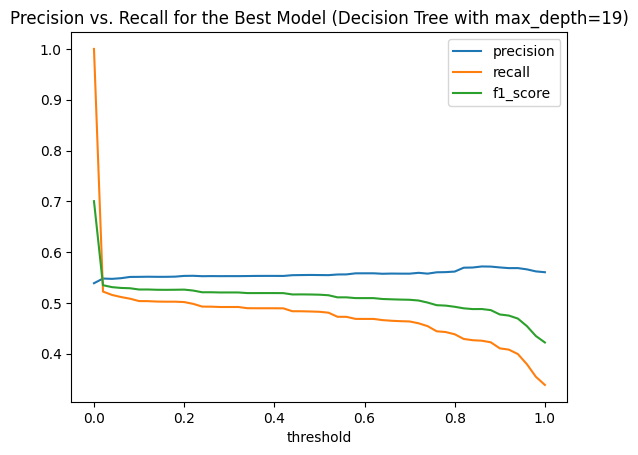

In [146]:
# Try to find high Precision score points

df_scores.plot.line(x='threshold',
                    y=['precision','recall', 'f1_score'],
                    title = 'Precision vs. Recall for the Best Model (Decision Tree with max_depth=19)')

## 2.2) [Code Snippet 6] Defining new columns with Predictions in new_df: pred7..pred10

    pred7 and pred8 are 2 decision rules for the Decision Tree (best model with max_depth=15)
    pred9 and pred10 are 2 decision rules for the Random Forest (second best model)



In [147]:
# adding Decision Tree predictors (clf_best) to the dataset for 2 new rules: Threshold = 0.66 and 0.78

y_pred_all = clf_best.predict_proba(X_all)
y_pred_all_class1 = [k[1] for k in y_pred_all] #list of predictions for class "1"
y_pred_all_class1_array = np.array(y_pred_all_class1) # (Numpy Array) np.array of predictions for class "1" , converted from a list

# defining a new prediction vector is easy now, as the dimensions will match
new_df['proba_pred7'] = y_pred_all_class1_array
new_df['pred7_clf_best_rule_66'] = (y_pred_all_class1_array >= 0.66).astype(int)

new_df['proba_pred8'] = y_pred_all_class1_array
new_df['pred8_clf_best_rule_78'] = (y_pred_all_class1_array >= 0.78).astype(int)

In [148]:
# adding Random Forest predictors (rf_best)
rf_best

RandomForestClassifier(max_depth=17, n_estimators=200, n_jobs=-1,
                       random_state=42)

In [149]:
# adding Random Forest predictors (rf_best) to the dataset for 2 new rules: Threshold = 0.66 and 0.78

y_pred_all = rf_best.predict_proba(X_all)
y_pred_all_class1 = [k[1] for k in y_pred_all] #list of predictions for class "1"
y_pred_all_class1_array = np.array(y_pred_all_class1) # (Numpy Array) np.array of predictions for class "1" , converted from a list

# defining a new prediction vector is easy now, as the dimensions will match
new_df['proba_pred9'] = y_pred_all_class1_array
new_df['pred9_rf_best_rule_55'] = (y_pred_all_class1_array >= 0.55).astype(int)

new_df['proba_pred10'] = y_pred_all_class1_array
new_df['pred10_rf_best_rule_60'] = (y_pred_all_class1_array >= 0.6).astype(int)

# new predictors
new_df['proba_pred11'] = y_pred_all_class1_array
new_df['pred12_rf_best_rule_51'] = (y_pred_all_class1_array >= 0.51).astype(int)

new_df['proba_pred12'] = y_pred_all_class1_array
new_df['pred13_rf_best_rule_52'] = (y_pred_all_class1_array >= 0.52).astype(int)

new_df['proba_pred13'] = y_pred_all_class1_array
new_df['pred14_rf_best_rule_53'] = (y_pred_all_class1_array >= 0.53).astype(int)

new_df['proba_pred14'] = y_pred_all_class1_array
new_df['pred15_rf_best_rule_54'] = (y_pred_all_class1_array >= 0.54).astype(int)

new_df['proba_pred15'] = y_pred_all_class1_array
new_df['pred15_rf_best_rule_56'] = (y_pred_all_class1_array >= 0.56).astype(int)

new_df['proba_pred16'] = y_pred_all_class1_array
new_df['pred11_rf_best_rule_57'] = (y_pred_all_class1_array >= 0.57).astype(int)

new_df['proba_pred17'] = y_pred_all_class1_array
new_df['pred11_rf_best_rule_58'] = (y_pred_all_class1_array >= 0.58).astype(int)

new_df['proba_pred18'] = y_pred_all_class1_array
new_df['pred11_rf_best_rule_59'] = (y_pred_all_class1_array >= 0.59).astype(int)


In [150]:
# new prediction is added --> need to recalculate the correctness
PREDICTIONS, IS_CORRECT = get_predictions_correctness(new_df, to_predict='is_positive_growth_5d_future')

Prediction columns founded: ['pred0_manual_cci', 'pred1_manual_prev_g1', 'pred2_manual_prev_g1_and_snp', 'pred3_manual_gdp_and_fastd', 'pred4_manual_gdp_and_wti30d', 'pred5_clf_10', 'pred6_clf_best', 'pred7_clf_best_rule_66', 'pred8_clf_best_rule_78', 'pred9_rf_best_rule_55', 'pred10_rf_best_rule_60', 'pred12_rf_best_rule_51', 'pred13_rf_best_rule_52', 'pred14_rf_best_rule_53', 'pred15_rf_best_rule_54', 'pred15_rf_best_rule_56', 'pred11_rf_best_rule_57', 'pred11_rf_best_rule_58', 'pred11_rf_best_rule_59']
Created columns is_correct: ['is_correct_pred0', 'is_correct_pred1', 'is_correct_pred2', 'is_correct_pred3', 'is_correct_pred4', 'is_correct_pred5', 'is_correct_pred6', 'is_correct_pred7', 'is_correct_pred8', 'is_correct_pred9', 'is_correct_pred10', 'is_correct_pred12', 'is_correct_pred13', 'is_correct_pred14', 'is_correct_pred15', 'is_correct_pred11']
Precision on TEST set for each prediction:
Prediction column:pred0_manual_cci , is_correct_column: is_correct_pred0
is_correct_pred0
1

In [151]:
PREDICTIONS

['pred0_manual_cci',
 'pred1_manual_prev_g1',
 'pred2_manual_prev_g1_and_snp',
 'pred3_manual_gdp_and_fastd',
 'pred4_manual_gdp_and_wti30d',
 'pred5_clf_10',
 'pred6_clf_best',
 'pred7_clf_best_rule_66',
 'pred8_clf_best_rule_78',
 'pred9_rf_best_rule_55',
 'pred10_rf_best_rule_60',
 'pred12_rf_best_rule_51',
 'pred13_rf_best_rule_52',
 'pred14_rf_best_rule_53',
 'pred15_rf_best_rule_54',
 'pred15_rf_best_rule_56',
 'pred11_rf_best_rule_57',
 'pred11_rf_best_rule_58',
 'pred11_rf_best_rule_59']

<Axes: >

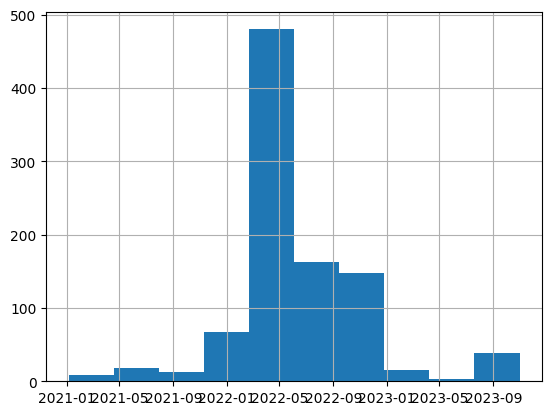

In [152]:
# When did it predict to trade for the "rare" prediction pred10? (only 2%)
new_df[(new_df.split=='test')&(new_df.pred10_rf_best_rule_60==1)].Date.hist()

In [153]:
new_df[(new_df.split=='test')&(new_df.pred10_rf_best_rule_60==1)].sort_values(by='Date')

,Open,High,Low,Close,Adj Close_x,Volume,Ticker,Year,Month,Weekday,...,pred11_rf_best_rule_59,is_correct_pred7,is_correct_pred8,is_correct_pred9,is_correct_pred10,is_correct_pred12,is_correct_pred13,is_correct_pred14,is_correct_pred15,is_correct_pred11
4123,86.254501,87.341499,85.845001,87.002502,86.902763,20360000.0,GOOGL,2021,January,1,...,1,1,1,0,0,0,0,0,0,0
10141,121.750000,123.599998,118.620003,120.129997,117.911003,178155000.0,AAPL,2021,March,3,...,1,0,0,1,1,1,1,1,1,1
5210,241.666672,242.413330,233.009995,236.389999,236.389999,2427600.0,ISRG,2021,March,3,...,1,1,1,1,1,1,1,1,1,1
7820,45.139999,45.470001,44.150002,44.560001,40.407928,24653500.0,CSCO,2021,March,3,...,1,1,1,1,1,1,1,1,1,1
7224,106.260002,107.169998,103.849998,104.889999,97.803101,7211800.0,SBUX,2021,March,3,...,1,0,0,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10998,35.470001,35.959999,34.919998,35.689999,35.325577,36656300.0,INTC,2023,October,0,...,1,1,1,1,1,1,1,1,1,1
5879,260.079987,261.149994,254.850006,258.489990,258.489990,2277800.0,ISRG,2023,October,0,...,1,1,1,1,1,1,1,1,1,1
10175,265.000000,266.350006,262.500000,263.190002,257.283813,2974600.0,AMGN,2023,October,0,...,1,1,1,1,1,1,1,1,1,1
7893,93.120003,93.709999,92.720001,93.150002,91.393509,7852700.0,SBUX,2023,October,0,...,1,1,1,1,1,1,1,1,1,1


In [154]:
# Pred 9: How many positive prediction per day (out of 25 stocks possible)
pred9_daily_positive_count = pd.DataFrame(new_df[(new_df.split=='test')&(new_df.pred9_rf_best_rule_55==1)].groupby('Date')['pred9_rf_best_rule_55'].count())

In [155]:
# Pred 10: How many positive prediction per day (out of 25 stocks possible)
pred10_daily_positive_count = pd.DataFrame(new_df[(new_df.split=='test')&(new_df.pred10_rf_best_rule_60==1)].groupby('Date')['pred10_rf_best_rule_60'].count())

In [156]:
# Unique trading days on Test (4 years)
new_df[(new_df.split=='test')].Date.nunique()

923

In [157]:
pred10_daily_positive_count

,pred10_rf_best_rule_60
Date,
2021-01-05,1
2021-03-04,7
2021-03-18,1
2021-05-11,2
2021-05-12,1
...,...
2023-10-25,2
2023-10-26,11
2023-10-27,9


array([[<Axes: title={'center': 'pred10_rf_best_rule_60'}>]], dtype=object)

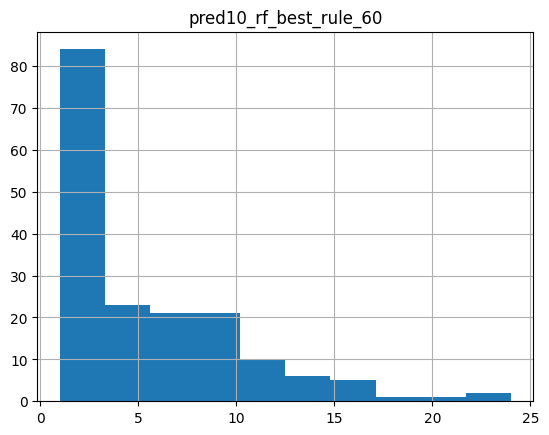

In [158]:
pred10_daily_positive_count.hist()

array([[<Axes: title={'center': 'pred9_rf_best_rule_55'}>]], dtype=object)

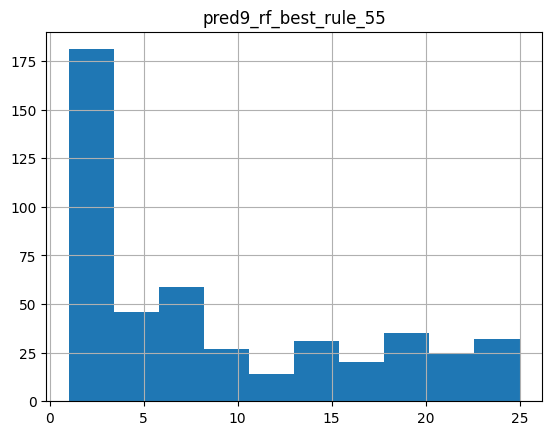

In [160]:
pred9_daily_positive_count.hist()

In [159]:
# 75% cases we have not more than 6 bets of $100
pred10_daily_positive_count.describe().T

,count,mean,std,min,25%,50%,75%,max
pred10_rf_best_rule_60,174.0,5.477011,4.734212,1.0,2.0,4.0,8.0,24.0


## 2.3) Agg. stats on ALL predictions

In [161]:
# let's review the Predictions:
PREDICTIONS, IS_CORRECT = get_predictions_correctness(new_df, to_predict=to_predict)

Prediction columns founded: ['pred0_manual_cci', 'pred1_manual_prev_g1', 'pred2_manual_prev_g1_and_snp', 'pred3_manual_gdp_and_fastd', 'pred4_manual_gdp_and_wti30d', 'pred5_clf_10', 'pred6_clf_best', 'pred7_clf_best_rule_66', 'pred8_clf_best_rule_78', 'pred9_rf_best_rule_55', 'pred10_rf_best_rule_60', 'pred12_rf_best_rule_51', 'pred13_rf_best_rule_52', 'pred14_rf_best_rule_53', 'pred15_rf_best_rule_54', 'pred15_rf_best_rule_56', 'pred11_rf_best_rule_57', 'pred11_rf_best_rule_58', 'pred11_rf_best_rule_59']
Created columns is_correct: ['is_correct_pred0', 'is_correct_pred1', 'is_correct_pred2', 'is_correct_pred3', 'is_correct_pred4', 'is_correct_pred5', 'is_correct_pred6', 'is_correct_pred7', 'is_correct_pred8', 'is_correct_pred9', 'is_correct_pred10', 'is_correct_pred12', 'is_correct_pred13', 'is_correct_pred14', 'is_correct_pred15', 'is_correct_pred11']
Precision on TEST set for each prediction:
Prediction column:pred0_manual_cci , is_correct_column: is_correct_pred0
is_correct_pred0
1

In [162]:
# Extract number from the prediction column

# Example string
example_string = "pred10_rf_best_rule_60"

# Split the string by '_'
parts = example_string.split('_')

# Extract the part with 'pred' and remove the 'pred' prefix
pred_number = parts[0].replace('pred', '')

# Print the result
print(pred_number)

# Print in one line
print(int(example_string.split('_')[0].replace('pred', '')))


10
10


In [163]:
# all predictions
PREDICTIONS

['pred0_manual_cci',
 'pred1_manual_prev_g1',
 'pred2_manual_prev_g1_and_snp',
 'pred3_manual_gdp_and_fastd',
 'pred4_manual_gdp_and_wti30d',
 'pred5_clf_10',
 'pred6_clf_best',
 'pred7_clf_best_rule_66',
 'pred8_clf_best_rule_78',
 'pred9_rf_best_rule_55',
 'pred10_rf_best_rule_60',
 'pred12_rf_best_rule_51',
 'pred13_rf_best_rule_52',
 'pred14_rf_best_rule_53',
 'pred15_rf_best_rule_54',
 'pred15_rf_best_rule_56',
 'pred11_rf_best_rule_57',
 'pred11_rf_best_rule_58',
 'pred11_rf_best_rule_59']

In [164]:
# all predictions on MODELS (not-manual predictions)
PREDICTIONS_ON_MODELS = [p for p in PREDICTIONS if int(p.split('_')[0].replace('pred', ''))>=5]
PREDICTIONS_ON_MODELS

['pred5_clf_10',
 'pred6_clf_best',
 'pred7_clf_best_rule_66',
 'pred8_clf_best_rule_78',
 'pred9_rf_best_rule_55',
 'pred10_rf_best_rule_60',
 'pred12_rf_best_rule_51',
 'pred13_rf_best_rule_52',
 'pred14_rf_best_rule_53',
 'pred15_rf_best_rule_54',
 'pred15_rf_best_rule_56',
 'pred11_rf_best_rule_57',
 'pred11_rf_best_rule_58',
 'pred11_rf_best_rule_59']

In [165]:
# all predictions on Models - correctness
IS_CORRECT_ON_MODELS = [p for p in IS_CORRECT if int(p.replace('is_correct_pred', ''))>=5]
IS_CORRECT_ON_MODELS

['is_correct_pred5',
 'is_correct_pred6',
 'is_correct_pred7',
 'is_correct_pred8',
 'is_correct_pred9',
 'is_correct_pred10',
 'is_correct_pred12',
 'is_correct_pred13',
 'is_correct_pred14',
 'is_correct_pred15',
 'is_correct_pred11']

In [166]:
# predictions on models
# pred10_rf_best_rule_60: ONLY 2% of TEST cases predicted with high confidence of growth
new_df.groupby('split')[PREDICTIONS_ON_MODELS].agg(['count','sum','mean']).T

split                                 test         train    validation
pred5_clf_10           count  23075.000000  92106.000000  23175.000000
                       sum    10668.000000  56742.000000  17095.000000
                       mean       0.462319      0.616051      0.737648
pred6_clf_best         count  23075.000000  92106.000000  23175.000000
                       sum    10781.000000  51421.000000  14643.000000
                       mean       0.467216      0.558281      0.631845
pred7_clf_best_rule_66 count  23075.000000  92106.000000  23175.000000
                       sum    10362.000000  45938.000000  13200.000000
                       mean       0.449057      0.498751      0.569579
pred8_clf_best_rule_78 count  23075.000000  92106.000000  23175.000000
                       sum     9817.000000  39134.000000  12187.000000
                       mean       0.425439      0.424880      0.525868
pred9_rf_best_rule_55  count  23075.000000  92106.000000  23175.000000
                       sum     4047.000000  47621.000000  14547.000000
                       mean       0.175385      0.517024      0.627702
pred10_rf_best_rule_60 count  23075.000000  92106.000000  23175.000000
                       sum      953.000000  39684.000000  13081.000000
                       mean       0.041300      0.430851      0.564444
pred12_rf_best_rule_51 count  23075.000000  92106.000000  23175.000000
                       sum     8712.000000  53178.000000  15641.000000
                       mean       0.377551      0.577357      0.674908
pred13_rf_best_rule_52 count  23075.000000  92106.000000  23175.000000
                       sum     7324.000000  51836.000000  15372.000000
                       mean       0.317400      0.562786      0.663301
pred14_rf_best_rule_53 count  23075.000000  92106.000000  23175.000000
                       sum     6045.000000  50530.000000  15099.000000
                       mean       0.261972      0.548607      0.651521
pred15_rf_best_rule_54 count  23075.000000  92106.000000  23175.000000
                       sum     4967.000000  49121.000000  14836.000000
                       mean       0.215255      0.533309      0.640173
pred15_rf_best_rule_56 count  23075.000000  92106.000000  23175.000000
                       sum     3216.000000  46144.000000  14295.000000
                       mean       0.139372      0.500988      0.616828
pred11_rf_best_rule_57 count  23075.000000  92106.000000  23175.000000
                       sum     2504.000000  44593.000000  14000.000000
                       mean       0.108516      0.484149      0.604099
pred11_rf_best_rule_58 count  23075.000000  92106.000000  23175.000000
                       sum     1877.000000  43040.000000  13712.000000
                       mean       0.081343      0.467288      0.591672
pred11_rf_best_rule_59 count  23075.000000  92106.000000  23175.000000
                       sum     1350.000000  41422.000000  13419.000000
                       mean       0.058505      0.449721      0.579029

In [167]:
# 10 predictions stats (check TEST set)
new_df.groupby('split')[PREDICTIONS].agg(['count','sum','mean']).T

split                                       test         train    validation
pred0_manual_cci             count  23075.000000  92106.000000  23175.000000
                             sum      572.000000   2453.000000    734.000000
                             mean       0.024789      0.026632      0.031672
pred1_manual_prev_g1         count  23075.000000  92106.000000  23175.000000
                             sum    11990.000000  46561.000000  12520.000000
                             mean       0.519610      0.505515      0.540237
pred2_manual_prev_g1_and_snp count  23075.000000  92106.000000  23175.000000
                             sum     8910.000000  34134.000000   9482.000000
                             mean       0.386132      0.370595      0.409148
pred3_manual_gdp_and_fastd   count  23075.000000  92106.000000  23175.000000
                             sum    23075.000000  79710.000000  23175.000000
                             mean       1.000000      0.865416      1.000000
pred4_manual_gdp_and_wti30d  count  23075.000000  92106.000000  23175.000000
                             sum        0.000000   4457.000000      0.000000
                             mean       0.000000      0.048390      0.000000
pred5_clf_10                 count  23075.000000  92106.000000  23175.000000
                             sum    10668.000000  56742.000000  17095.000000
                             mean       0.462319      0.616051      0.737648
pred6_clf_best               count  23075.000000  92106.000000  23175.000000
                             sum    10781.000000  51421.000000  14643.000000
                             mean       0.467216      0.558281      0.631845
pred7_clf_best_rule_66       count  23075.000000  92106.000000  23175.000000
                             sum    10362.000000  45938.000000  13200.000000
                             mean       0.449057      0.498751      0.569579
pred8_clf_best_rule_78       count  23075.000000  92106.000000  23175.000000
                             sum     9817.000000  39134.000000  12187.000000
                             mean       0.425439      0.424880      0.525868
pred9_rf_best_rule_55        count  23075.000000  92106.000000  23175.000000
                             sum     4047.000000  47621.000000  14547.000000
                             mean       0.175385      0.517024      0.627702
pred10_rf_best_rule_60       count  23075.000000  92106.000000  23175.000000
                             sum      953.000000  39684.000000  13081.000000
                             mean       0.041300      0.430851      0.564444
pred12_rf_best_rule_51       count  23075.000000  92106.000000  23175.000000
                             sum     8712.000000  53178.000000  15641.000000
                             mean       0.377551      0.577357      0.674908
pred13_rf_best_rule_52       count  23075.000000  92106.000000  23175.000000
                             sum     7324.000000  51836.000000  15372.000000
                             mean       0.317400      0.562786      0.663301
pred14_rf_best_rule_53       count  23075.000000  92106.000000  23175.000000
                             sum     6045.000000  50530.000000  15099.000000
                             mean       0.261972      0.548607      0.651521
pred15_rf_best_rule_54       count  23075.000000  92106.000000  23175.000000
                             sum     4967.000000  49121.000000  14836.000000
                             mean       0.215255      0.533309      0.640173
pred15_rf_best_rule_56       count  23075.000000  92106.000000  23175.000000
                             sum     3216.000000  46144.000000  14295.000000
                             mean       0.139372      0.500988      0.616828
pred11_rf_best_rule_57       count  23075.000000  92106.000000  23175.000000
                             sum     2504.000000  44593.000000  14000.000000
                             mean       0.108516      0.484149      0.604

## 3) Trading Simulations
create simulation 1 features: like "sim1_pred0" ... "sim1_predLast"

## 3.1) Investing $100 on every positive prediction

    fees = 0.1% for each buy and sell operation ==> 0.2% for buy+sell operation

In [168]:
# current prediction
pred = 'pred6_clf_best'

In [169]:
# Total Number of Investment Opportunities
new_df[new_df.split=='test'].Close.count()

23075

In [170]:
# Total Number of Days (~4 years of trading)
new_df[new_df.split=='test'].Date.nunique()

923

In [171]:
# check actual future growth with 'growth_future_5d', correctness of the prediction with 'is_positive_growth_5d_future'
TO_PREDICT

['growth_future_5d',
 'growth_future_10d',
 'growth_future_20d',
 'is_positive_growth_5d_future',
 'is_positive_growth_10d_future',
 'is_positive_growth_20d_future']

In [172]:
new_df[['growth_future_5d','is_positive_growth_5d_future',pred]]

,growth_future_5d,is_positive_growth_5d_future,pred6_clf_best
4816,0.873255,0,1
4817,0.904878,0,0
4818,0.838342,0,0
4819,1.018421,1,1
4820,1.009421,1,1
...,...,...,...
8059,NaN,0,0
8060,NaN,0,1
8061,NaN,0,1
8062,NaN,0,0


In [173]:
# GROSS REVENUE: ONLY when current_prediction equals to 1: invest $100 into that stock (buy), and sell in 1week (sell)
new_df['sim1_gross_rev_pred6'] = new_df[pred] * 100 * (new_df['growth_future_5d']-1)

In [174]:
# FEES: 0.1% for each operation , 0.2% for buy+sell ONLY when current_prediction equals to one
new_df['sim1_fees_pred6'] = -new_df[pred] * 100 * 0.002

In [175]:
# NET REVENUE: GROSS_REVENUE + FEES
new_df['sim1_net_rev_pred6'] = new_df['sim1_gross_rev_pred6'] + new_df['sim1_fees_pred6']

In [176]:
COLUMNS_FIN_RESULT = ['Date','Ticker','Close']+TO_PREDICT+ [pred,  'sim1_gross_rev_pred6','sim1_fees_pred6','sim1_net_rev_pred6']
new_df[(new_df.split=='test')&(new_df[pred]==1)][COLUMNS_FIN_RESULT]

,Date,Ticker,Close,growth_future_5d,growth_future_10d,growth_future_20d,is_positive_growth_5d_future,is_positive_growth_10d_future,is_positive_growth_20d_future,pred6_clf_best,sim1_gross_rev_pred6,sim1_fees_pred6,sim1_net_rev_pred6
10058,2020-11-02,AAPL,108.769997,1.071257,1.107912,1.130199,1,1,1,1,7.125749,-0.2,6.925749
10060,2020-11-04,AAPL,114.949997,1.041289,1.028566,1.071354,1,1,1,1,4.128873,-0.2,3.928873
10061,2020-11-05,AAPL,119.029999,1.003240,0.998443,1.028824,1,0,1,1,0.324008,-0.2,0.124008
10062,2020-11-06,AAPL,118.690002,1.004802,0.988626,1.042632,1,0,1,1,0.480226,-0.2,0.280226
10064,2020-11-10,AAPL,115.970001,1.029490,0.993102,1.050099,1,0,1,1,2.949028,-0.2,2.749028
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8054,2024-06-21,SBUX,79.910004,0.974221,NaN,NaN,0,0,0,1,-2.577907,-0.2,-2.777907
8055,2024-06-24,SBUX,79.730003,0.967390,NaN,NaN,0,0,0,1,-3.261013,-0.2,-3.461013
8057,2024-06-26,SBUX,79.150002,0.963487,NaN,NaN,0,0,0,1,-3.651294,-0.2,-3.851294
8060,2024-07-01,SBUX,77.129997,NaN,NaN,NaN,0,0,0,1,NaN,-0.2,NaN


In [177]:
# DAILY INVESTMENTS COUNT
filter_test_and_positive_pred = (new_df.split=='test')&(new_df[pred]==1)
df_investments_count_daily = pd.DataFrame(new_df[filter_test_and_positive_pred].groupby('Date')[pred].count())
sim1_avg_investments_per_day = df_investments_count_daily[pred].quantile(0.75)  # 75% case - how many $100 investments per day do we have?
print(sim1_avg_investments_per_day)

17.0


In [178]:
# Distribution: how many times do we trade daily (for the current Prediction)?
df_investments_count_daily.describe().T

,count,mean,std,min,25%,50%,75%,max
pred6_clf_best,912.0,11.821272,6.843384,1.0,6.0,11.0,17.0,25.0


In [179]:
new_df[(new_df.split=='test')&(new_df[pred]==1)][['sim1_gross_rev_pred6','sim1_fees_pred6','sim1_net_rev_pred6']].sum()

sim1_gross_rev_pred6    5482.592214
sim1_fees_pred6        -2156.200000
sim1_net_rev_pred6      3333.992214
dtype: float64

## 3.1.2 Calculate fin. results for all fields
    Vector simulations for at least 1 strategy (and approximate returns on capital)
    Simplified and approximate calculation

In [180]:
# Calculate fin. result for ALL predictions (manual and produced by models)

sim1_results = [] # results in Array

# Iterate over all predictions
for pred in PREDICTIONS:
  print(f'Calculating sumulation for prediction {pred}:')
  print(f"    Count times of investment {len(new_df[(new_df.split=='test')&(new_df[pred]==1)])} out of {len(new_df[(new_df.split=='test')])} TEST records")

  # Prefix: e.g. pred1 or pred10
  pred_prefix= pred.split('_')[0]

  # Fin. result columns: define new records for EACH positive prediction
  new_df['sim1_gross_rev_'+pred_prefix] = new_df[pred] * 100 * (new_df['growth_future_5d']-1)
  new_df['sim1_fees_'+pred_prefix] = -new_df[pred] * 100 * 0.002
  new_df['sim1_net_rev_'+pred_prefix] = new_df['sim1_gross_rev_'+pred_prefix] + new_df['sim1_fees_'+pred_prefix]

  # calculate agg. results for each PREDICTION columns (pred) on TEST
  filter_test_and_positive_pred = (new_df.split=='test')&(new_df[pred]==1) # filter records on TEST set, when current prediction is 1 (we invest $100 for 1 week ahead - 5 periods)
  sim1_count_investments = len(new_df[filter_test_and_positive_pred])
  sim1_gross_rev = new_df[filter_test_and_positive_pred]['sim1_gross_rev_'+pred_prefix].sum()
  sim1_fees = new_df[filter_test_and_positive_pred]['sim1_fees_'+pred_prefix].sum()
  sim1_net_rev = new_df[filter_test_and_positive_pred]['sim1_net_rev_'+pred_prefix].sum()

  if sim1_gross_rev>0:
    sim1_fees_percentage = -sim1_fees/sim1_gross_rev
  else:
    sim1_fees_percentage = None

  if sim1_count_investments>0:
    sim1_average_net_revenue = sim1_net_rev/sim1_count_investments
  else:
    sim1_average_net_revenue = None

  # APPROXIMATE CAPITAL REQUIRED and CAGR Calculation
  df_investments_count_daily = pd.DataFrame(new_df[filter_test_and_positive_pred].groupby('Date')[pred].count())
  sim1_avg_investments_per_day = df_investments_count_daily[pred].mean()
  sim1_q75_investments_per_day = df_investments_count_daily[pred].quantile(0.75)  # 75% case - how many $100 investments per day do we have?
  # df_investments_count_daily[pred].mean()
  sim1_capital = 100 * 5 * sim1_q75_investments_per_day # 5 days in a row with positive predictions
  # CAGR: average growth per year. E.g. if you have 1.5 return (50% growth in 4 years) --> (1.5)**(1/4) = 1.106 or 10.6% average
  sim1_CAGR = ((sim1_capital+sim1_net_rev)/sim1_capital)**(1/4)

  # append to DF
  sim1_results.append((pred,sim1_count_investments,sim1_gross_rev,sim1_fees,sim1_net_rev,sim1_fees_percentage,sim1_average_net_revenue,sim1_avg_investments_per_day,sim1_capital,sim1_CAGR))


  # output for all predictions with some positive predictions
  if  sim1_count_investments>1:
    print(f"    Financial Result: \n {new_df[filter_test_and_positive_pred][['sim1_gross_rev_'+pred_prefix,'sim1_fees_'+pred_prefix,'sim1_net_rev_'+pred_prefix]].sum()}")
    print(f"        Count Investments in 4 years (on TEST): {sim1_count_investments}")
    print(f"        Gross Revenue: ${int(sim1_gross_rev)}")
    print(f"        Fees (0.2% for buy+sell): ${int(-sim1_fees)}")
    print(f"        Net Revenue: ${int(sim1_net_rev)}")
    print(f"        Fees are {int(-100.0*sim1_fees/sim1_gross_rev)} % from Gross Revenue")
    print(f"        Capital Required : ${int(sim1_capital)} (Vbegin)")
    print(f"        Final value (Vbegin + Net_revenue) : ${int(sim1_capital + sim1_net_rev)} (Vfinal)")

    print(f"        Average CAGR on TEST (4 years) : {np.round(sim1_CAGR,3)}, or {np.round(100.0*(sim1_CAGR-1),1)}% ")

    print(f"        Average daily stats: ")
    print(f"            Average net revenue per investment: ${np.round(sim1_net_rev/sim1_count_investments,2)} ")
    print(f"            Average investments per day: {int(np.round(sim1_avg_investments_per_day))} ")
    print(f"            Q75 investments per day: {int(np.round(sim1_q75_investments_per_day))} ")
    print('=============================================+')


# results in a DataFrame from an Array
columns_simulation = ['prediction', 'sim1_count_investments', 'sim1_gross_rev', 'sim1_fees', 'sim1_net_rev', 'sim1_fees_percentage','sim1_average_net_revenue','sim1_avg_investments_per_day','sim1_capital','sim1_CAGR']

df_sim1_results = pd.DataFrame(sim1_results,columns=columns_simulation)

Calculating sumulation for prediction pred0_manual_cci:
    Count times of investment 572 out of 23075 TEST records
    Financial Result: 
 sim1_gross_rev_pred0    285.936248
sim1_fees_pred0        -114.400000
sim1_net_rev_pred0      172.536248
dtype: float64
        Count Investments in 4 years (on TEST): 572
        Gross Revenue: $285
        Fees (0.2% for buy+sell): $114
        Net Revenue: $172
        Fees are 40 % from Gross Revenue
        Capital Required : $1000 (Vbegin)
        Final value (Vbegin + Net_revenue) : $1172 (Vfinal)
        Average CAGR on TEST (4 years) : 1.041, or 4.1% 
        Average daily stats: 
            Average net revenue per investment: $0.3 
            Average investments per day: 2 
            Q75 investments per day: 2 
=============================================+
Calculating sumulation for prediction pred1_manual_prev_g1:
    Count times of investment 11990 out of 23075 TEST records
    Financial Result: 
 sim1_gross_rev_pred1    3241.09898

In [181]:
df_sim1_results['sim1_growth_capital_4y'] = (df_sim1_results.sim1_net_rev+df_sim1_results.sim1_capital) / df_sim1_results.sim1_capital

In [182]:
# final comparison
df_sim1_results

,prediction,sim1_count_investments,sim1_gross_rev,sim1_fees,sim1_net_rev,sim1_fees_percentage,sim1_average_net_revenue,sim1_avg_investments_per_day,sim1_capital,sim1_CAGR,sim1_growth_capital_4y
0,pred0_manual_cci,572,285.936248,-114.4,172.536248,0.400089,0.301637,1.815873,1000.0,1.040595,1.172536
1,pred1_manual_prev_g1,11990,3241.098987,-2398.0,858.498987,0.739872,0.071601,13.426652,9500.0,1.021864,1.090368
2,pred2_manual_prev_g1_and_snp,8910,1291.591081,-1782.0,-477.008919,1.379694,-0.053536,18.371134,11000.0,0.988978,0.956636
3,pred3_manual_gdp_and_fastd,23075,8653.309156,-4615.0,4063.309156,0.533322,0.176091,25.000000,12500.0,1.072900,1.325065
4,pred4_manual_gdp_and_wti30d,0,0.000000,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN
5,pred5_clf_10,10668,4300.117982,-2133.6,2167.917982,0.496172,0.203217,14.694215,12500.0,1.040794,1.173433
6,pred6_clf_best,10781,5482.592214,-2156.2,3333.992214,0.393281,0.309247,11.821272,8500.0,1.086246,1.392234
7,pred7_clf_best_rule_66,10362,5559.252845,-2072.4,3494.452845,0.372784,0.337237,11.437086,8000.0,1.094837,1.436807
8,pred8_clf_best_rule_78,9817,5297.437395,-1963.4,3338.237395,0.370632,0.340047,10.859513,8000.0,1.091098,1.417280
9,pred9_rf_best_rule_55,4047,1526.906235,-809.4,717.506235,0.530091,0.177293,8.610638,7500.0,1.023104,1.095667


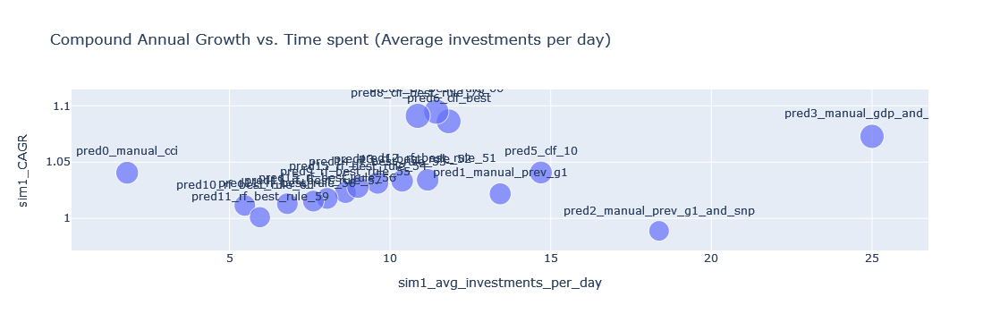

In [183]:
# Create the scatter plot
fig = px.scatter(
    df_sim1_results.dropna(),
    x='sim1_avg_investments_per_day',
    y='sim1_CAGR',
    size='sim1_growth_capital_4y',  # Use the 'size' parameter for sim1_CAGR
    text='prediction',
    title='Compound Annual Growth vs. Time spent (Average investments per day)',
    labels={'sim1_capital': 'Initial Capital Requirement', 'growth_capital_4y': '4-Year Capital Growth'}
)

# Update the layout to improve readability of the annotations
fig.update_traces(textposition='top center')

# Show the plot
fig.show()

## 3.2. Advanced Simulation
* to_predict = 'is_positive_growth_5d_future'
* invest ~20% of capital each day (sell positions from 5 days ago), REINVEST PREVIOUS GAINS
* use predict_proba predictions
* select top1..3..x predictions > threshold (0.53)
* invest proportionally the prediction
* stop loss y%
* take profit z%
* Not included: portfolio optimization

## 3.2.1) [Code Snippet 1] Define rank of prediction (pred_14_rf_best_rule_53)

    Current best prediction pred7_clf_best_rule_66, with CAGR = 1.094837 (9.48% average capital growth with simple simulation)

In [185]:
# https://stackoverflow.com/questions/17775935/sql-like-window-functions-in-pandas-row-numbering-in-python-pandas-dataframe
# rank of prediction

new_df["pred7_rank"] = new_df.groupby("Date")["proba_pred7"].rank(method="first", ascending=False)

C:\TEMP\ipykernel_65208\2217385611.py:4: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [186]:
# CHECK RANK FOR 1 DAY:
  # we have predictions for all 25 stocks
first_trading_day_2024 = new_df[new_df.Date>='2024-01-04'].Date.unique().astype(str)[0]
first_trading_day_2024
print(f'First trading day in 2024: {first_trading_day_2024}, count predictions = {len(new_df[new_df.Date==first_trading_day_2024])}')

First trading day in 2024: 2024-01-04, count predictions = 25


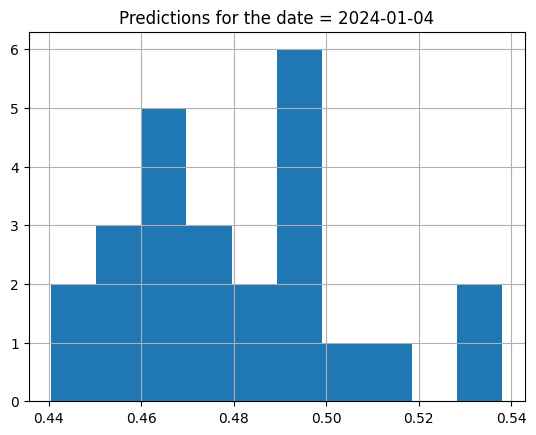

In [187]:
new_df[new_df.Date==first_trading_day_2024].proba_pred14.hist()
plt.title(f'Predictions for the date = {first_trading_day_2024}')
# Show the plot
plt.show()

In [189]:
new_df[new_df.Date==first_trading_day_2024][['Date','Ticker','proba_pred7','pred7_rank']].sort_values(by='pred7_rank').head(5)

,Date,Ticker,proba_pred7,pred7_rank
9529,2024-01-04,MSFT,1.000000,1.0
5441,2024-01-04,NFLX,1.000000,2.0
4207,2024-01-04,TMUS,1.000000,3.0
5924,2024-01-04,ISRG,1.000000,4.0
2140,2024-01-04,PYPL,0.965116,5.0


## 3.2.2 Define Min(Low) for the next 5 days and Max(High) for the next 5 days

    Assymetric! distributions for Max_High_Next_5 / Adj_close_today vs. Min_Low_Next_5/Adj_close_today

In [190]:
# Sort the DataFrame by Ticker and Date
new_df = new_df.sort_values(by=['Ticker', 'Date'])

In [191]:
new_df['growth_future_5d'].describe().T

count    138231.000000
mean          1.004356
std           0.056119
min           0.412383
25%           0.978835
50%           1.003939
75%           1.028951
max           2.551286
Name: growth_future_5d, dtype: float64

In [192]:
# take profit if growth >=8%
new_df['growth_future_5d'].quantile(0.95)

1.0874297229082377

In [193]:
# stop loss when -5%
new_df['growth_future_5d'].quantile(0.1)

0.9470826800445168

In [194]:
new_df[['Date','High','Low','Adj Close_x','Ticker']].tail(10)

,Date,High,Low,Adj Close_x,Ticker
13125,2024-06-21,197.479996,193.720001,195.529999,TXN
13126,2024-06-24,196.559998,193.350006,193.910004,TXN
13127,2024-06-25,194.940002,192.820007,194.470001,TXN
13128,2024-06-26,194.990005,192.179993,193.100006,TXN
13129,2024-06-27,193.899994,191.800003,193.429993,TXN
13130,2024-06-28,197.889999,193.500000,194.529999,TXN
13131,2024-07-01,194.979996,192.740005,194.600006,TXN
13132,2024-07-02,199.050003,194.449997,198.419998,TXN
13133,2024-07-03,199.570007,196.100006,198.940002,TXN
13134,2024-07-05,200.149994,197.240005,198.490005,TXN


In [195]:
# Define a function to get the rolling max High and min Low for the next 5 days

# Sort the DataFrame: Sorting by Ticker and Date ensures that we are looking at each ticker's data in chronological order.
# Rolling window calculation: We use the rolling method with a window of 5 to calculate the maximum high and minimum low over the next 5 days.
# The shift method is used to align these values correctly with the current row.

def rolling_max_min(df, window=5):
    # high/low in 5 days
    df['Max_High_Next_5'] = df['High'].rolling(window=window, min_periods=1).max().shift(-window+1)
    df['Min_Low_Next_5'] = df['Low'].rolling(window=window, min_periods=1).min().shift(-window+1)

    # low in 1 day (for lower entry)
    df['Min_Low_Next_1'] = df['Low'].rolling(window=1, min_periods=1).min().shift(-1)
    return df

In [196]:
# Apply the function to each group of Ticker
# Important!: need to drop index from groupby operation (reset_index) - so that you can merge that afterwards
result = new_df[['Date','High','Low','Adj Close_x','Ticker']].groupby('Ticker').apply(rolling_max_min).reset_index(drop=True)
result.tail(10)

,Date,High,Low,Adj Close_x,Ticker,Max_High_Next_5,Min_Low_Next_5,Min_Low_Next_1
138346,2024-06-21,197.479996,193.720001,195.529999,TXN,197.479996,191.800003,193.350006
138347,2024-06-24,196.559998,193.350006,193.910004,TXN,197.889999,191.800003,192.820007
138348,2024-06-25,194.940002,192.820007,194.470001,TXN,197.889999,191.800003,192.179993
138349,2024-06-26,194.990005,192.179993,193.100006,TXN,199.050003,191.800003,191.800003
138350,2024-06-27,193.899994,191.800003,193.429993,TXN,199.570007,191.800003,193.500000
138351,2024-06-28,197.889999,193.500000,194.529999,TXN,200.149994,192.740005,192.740005
138352,2024-07-01,194.979996,192.740005,194.600006,TXN,NaN,NaN,194.449997
138353,2024-07-02,199.050003,194.449997,198.419998,TXN,NaN,NaN,196.100006
138354,2024-07-03,199.570007,196.100006,198.940002,TXN,NaN,NaN,197.240005
138355,2024-07-05,200.149994,197.240005,198.490005,TXN,NaN,NaN,NaN


In [198]:
result[result.Ticker=='NFLX'].tail(10)

,Date,High,Low,Adj Close_x,Ticker,Max_High_Next_5,Min_Low_Next_5,Min_Low_Next_1
97394,2024-06-21,686.900024,678.099976,686.119995,NFLX,688.570007,662.299988,664.500000
97395,2024-06-24,685.500000,664.500000,669.020020,NFLX,688.570007,662.299988,662.299988
97396,2024-06-25,673.669983,662.299988,672.409973,NFLX,688.570007,662.299988,670.020020
97397,2024-06-26,682.960022,670.020020,677.690002,NFLX,688.570007,663.780029,678.140015
97398,2024-06-27,688.570007,678.140015,684.340027,NFLX,688.570007,663.780029,673.080017
97399,2024-06-28,687.000000,673.080017,674.880005,NFLX,697.469971,663.780029,663.780029
97400,2024-07-01,675.020020,663.780029,673.609985,NFLX,NaN,NaN,670.070007
97401,2024-07-02,681.739990,670.070007,679.580017,NFLX,NaN,NaN,675.500000
97402,2024-07-03,683.750000,675.500000,682.510010,NFLX,NaN,NaN,677.229980
97403,2024-07-05,697.469971,677.229980,696.059998,NFLX,NaN,NaN,NaN


In [199]:
# Calculate the ratios + safe divide
result['Ratio_MaxHighNext5_to_AdjClose'] = np.where(result['Adj Close_x'] == 0, np.nan, result['Max_High_Next_5']/result['Adj Close_x'])
result['Ratio_MinLowNext5_to_AdjClose'] =  np.where(result['Adj Close_x'] == 0, np.nan,  result['Min_Low_Next_5']/result['Adj Close_x'])

result['Ratio_MinLowNext1_to_AdjClose'] =  np.where(result['Adj Close_x'] == 0, np.nan,  result['Min_Low_Next_1']/result['Adj Close_x'])

In [200]:
result[result.Ticker=='NFLX'].tail(10)

,Date,High,Low,Adj Close_x,Ticker,Max_High_Next_5,Min_Low_Next_5,Min_Low_Next_1,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose
97394,2024-06-21,686.900024,678.099976,686.119995,NFLX,688.570007,662.299988,664.500000,1.003571,0.965283,0.968489
97395,2024-06-24,685.500000,664.500000,669.020020,NFLX,688.570007,662.299988,662.299988,1.029222,0.989955,0.989955
97396,2024-06-25,673.669983,662.299988,672.409973,NFLX,688.570007,662.299988,670.020020,1.024033,0.984965,0.996446
97397,2024-06-26,682.960022,670.020020,677.690002,NFLX,688.570007,663.780029,678.140015,1.016055,0.979474,1.000664
97398,2024-06-27,688.570007,678.140015,684.340027,NFLX,688.570007,663.780029,673.080017,1.006181,0.969956,0.983546
97399,2024-06-28,687.000000,673.080017,674.880005,NFLX,697.469971,663.780029,663.780029,1.033473,0.983553,0.983553
97400,2024-07-01,675.020020,663.780029,673.609985,NFLX,NaN,NaN,670.070007,NaN,NaN,0.994745
97401,2024-07-02,681.739990,670.070007,679.580017,NFLX,NaN,NaN,675.500000,NaN,NaN,0.993996
97402,2024-07-03,683.750000,675.500000,682.510010,NFLX,NaN,NaN,677.229980,NaN,NaN,0.992264
97403,2024-07-05,697.469971,677.229980,696.059998,NFLX,NaN,NaN,NaN,NaN,NaN,NaN


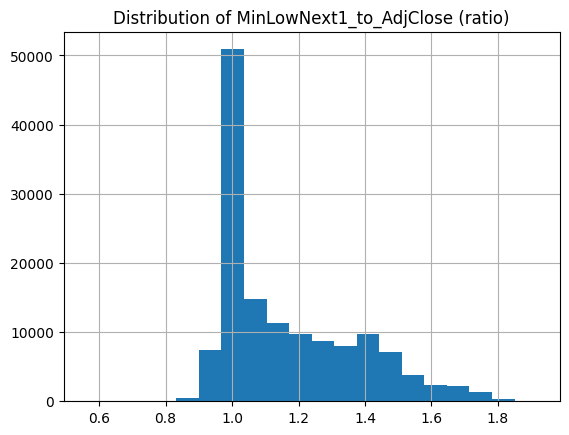

In [201]:
result.Ratio_MinLowNext1_to_AdjClose.hist(bins=20)
plt.title(f'Distribution of MinLowNext1_to_AdjClose (ratio)')
# Show the plot
plt.show()

In [202]:
result.Ratio_MinLowNext1_to_AdjClose.describe().T

count    138331.000000
mean          1.163130
std           0.204766
min           0.561000
25%           0.995305
50%           1.083978
75%           1.310429
max           1.917693
Name: Ratio_MinLowNext1_to_AdjClose, dtype: float64

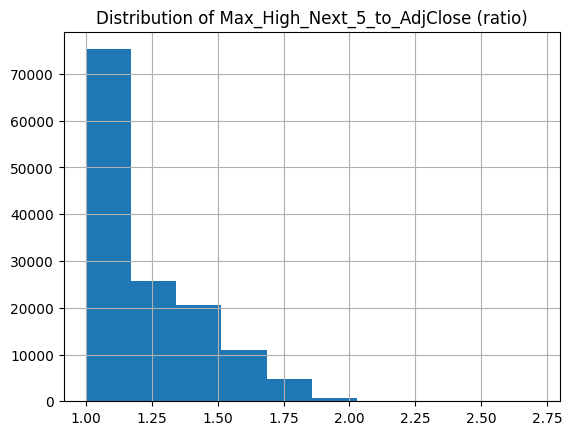

In [203]:
result.Ratio_MaxHighNext5_to_AdjClose.hist()
plt.title(f'Distribution of Max_High_Next_5_to_AdjClose (ratio)')
# Show the plot
plt.show()

In [204]:
result.Ratio_MaxHighNext5_to_AdjClose.describe().T

count    138256.000000
mean          1.222682
std           0.215080
min           1.000000
25%           1.043458
50%           1.141270
75%           1.369001
max           2.712613
Name: Ratio_MaxHighNext5_to_AdjClose, dtype: float64

In [205]:
result[result.Ratio_MaxHighNext5_to_AdjClose>=1.5].tail()

,Date,High,Low,Adj Close_x,Ticker,Max_High_Next_5,Min_Low_Next_5,Min_Low_Next_1,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose
135185,2011-11-25,28.209999,27.790001,19.853001,TXN,30.389999,27.790001,28.410000,1.530751,1.399788,1.431018
135216,2012-01-11,30.780001,30.290001,21.953325,TXN,33.830002,30.290001,30.639999,1.540997,1.379745,1.395688
135217,2012-01-12,31.440001,30.639999,22.410532,TXN,34.099998,30.639999,30.809999,1.521606,1.367214,1.374800
135218,2012-01-13,31.360001,30.809999,22.110487,TXN,34.099998,30.809999,31.000000,1.542255,1.393456,1.402050
135219,2012-01-17,31.379999,31.000000,22.196215,TXN,34.099998,31.000000,31.959999,1.536298,1.396635,1.439885


<Axes: >

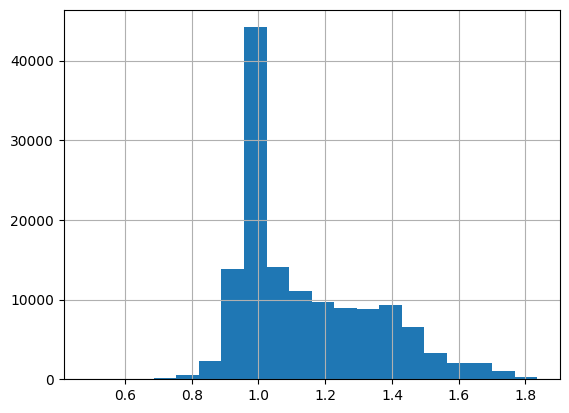

In [206]:
# High intra-day volatility, especially on earlier days after the IPO
result.Ratio_MinLowNext5_to_AdjClose.hist(bins=20)

In [207]:
result.Ratio_MinLowNext5_to_AdjClose.describe().T

count    138256.000000
mean          1.138519
std           0.204459
min           0.483621
25%           0.980415
50%           1.063528
75%           1.283265
max           1.834788
Name: Ratio_MinLowNext5_to_AdjClose, dtype: float64

In [208]:
result[result.Ratio_MinLowNext5_to_AdjClose<=0.9]

,Date,High,Low,Adj Close_x,Ticker,Max_High_Next_5,Min_Low_Next_5,Min_Low_Next_1,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose
184,2000-09-25,0.991071,0.929688,0.807709,AAPL,0.991071,0.453125,0.917411,1.227014,0.561000,1.135818
185,2000-09-26,0.977679,0.917411,0.776571,AAPL,0.977679,0.419643,0.861607,1.258969,0.540379,1.109502
186,2000-09-27,0.941964,0.861607,0.738828,AAPL,0.960938,0.396205,0.859375,1.300625,0.536262,1.163160
187,2000-09-28,0.960938,0.859375,0.807709,AAPL,0.960938,0.390625,0.453125,1.189708,0.483621,0.561000
2597,2010-05-03,9.567143,9.388571,8.042368,AAPL,9.567143,7.116071,9.169643,1.189593,0.884823,1.140167
...,...,...,...,...,...,...,...,...,...,...,...
132131,2024-04-10,174.929993,170.009995,171.759995,TSLA,175.880005,153.750000,168.509995,1.023987,0.895144,0.981078
132132,2024-04-11,175.880005,168.509995,174.600006,TSLA,175.880005,153.750000,170.360001,1.007331,0.880584,0.975716
132133,2024-04-12,173.809998,170.360001,171.050003,TSLA,173.809998,148.699997,161.380005,1.016136,0.869336,0.943467
132135,2024-04-16,158.190002,153.750000,157.110001,TSLA,158.330002,138.800003,153.779999,1.007765,0.883457,0.978805


In [209]:
# ~0.8% STOP LOSS
len(result[result.Ratio_MinLowNext5_to_AdjClose<=0.9])/len(result)

0.028679638035213506

In [210]:
# Merge the results back with the original dataframe
new_df = new_df.merge(result[['Date', 'Ticker', 'Max_High_Next_5', 'Min_Low_Next_5','Ratio_MaxHighNext5_to_AdjClose','Ratio_MinLowNext5_to_AdjClose','Ratio_MinLowNext1_to_AdjClose']], on=['Date', 'Ticker'])

In [211]:
new_df.tail()

,Open,High,Low,Close,Adj Close_x,Volume,Ticker,Year,Month,Weekday,...,sim1_net_rev_pred15,sim1_gross_rev_pred11,sim1_fees_pred11,sim1_net_rev_pred11,pred7_rank,Max_High_Next_5,Min_Low_Next_5,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose
138351,194.149994,197.889999,193.500000,194.529999,194.529999,8861000.0,TXN,2024,June,4,...,NaN,NaN,0.0,NaN,21.0,200.149994,192.740005,1.02889,0.990798,0.990798
138352,193.630005,194.979996,192.740005,194.600006,194.600006,2873600.0,TXN,2024,July,0,...,NaN,NaN,0.0,NaN,3.0,NaN,NaN,NaN,NaN,0.999229
138353,194.990005,199.050003,194.449997,198.419998,198.419998,4168700.0,TXN,2024,July,1,...,NaN,NaN,0.0,NaN,2.0,NaN,NaN,NaN,NaN,0.988308
138354,198.130005,199.570007,196.100006,198.940002,198.940002,2454800.0,TXN,2024,July,2,...,NaN,NaN,0.0,NaN,7.0,NaN,NaN,NaN,NaN,0.991455
138355,199.800003,200.149994,197.240005,198.490005,198.490005,698014.0,TXN,2024,July,4,...,NaN,NaN,0.0,NaN,18.0,NaN,NaN,NaN,NaN,NaN


## 3.2.3) Generate fin.result for one date

In [212]:
from dataclasses import dataclass

@dataclass
class SimulationParams:
    initial_capital: float
    threshold: float
    fees: float
    top_k: int
    portfolio_optimization: bool
    stop_loss: float
    take_profit: float
    lower_entry: float

In [213]:
# Example of initializing with some values
sim_params = SimulationParams(
    initial_capital=10000,        # initial capital = $10k
    threshold=0.53,               # select all binary predictions with probability>=0.53
    fees=0.002,                   # trading fees = 0.2% (buy+sell)
    top_k=10,                     # select top_k predictions
    portfolio_optimization=False, # no portfolio optimizaiton
    stop_loss=0.9,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
    take_profit=1.2,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
    lower_entry= 0.995                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
)

print(sim_params)

SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=10, portfolio_optimization=False, stop_loss=0.9, take_profit=1.2, lower_entry=0.995)


In [214]:
# sorted array of dates for Simulation
DATES = new_df[new_df.split=='test'].sort_values(by='Date').Date.unique()
print(f' Min date {DATES.min()}, max date {DATES.max()}')

 Min date 2020-11-02 00:00:00, max date 2024-07-05 00:00:00


In [215]:
date = DATES[0]
date

Timestamp('2020-11-02 00:00:00')

In [216]:
# 1. get TOP_K predictions from pred7_clf_best_rule_66, that are higher than THE THRESHOLD
if sim_params.top_k is None:
  one_day_predictions_df = new_df[(new_df.Date==date)&(new_df.proba_pred7 > sim_params.threshold)]
else:
  one_day_predictions_df = new_df[(new_df.Date==date)&(new_df.proba_pred7 > sim_params.threshold)&(new_df.pred7_rank<=sim_params.top_k)]

In [217]:
one_day_predictions_df[['Date','Ticker',to_predict,'growth_future_5d','proba_pred7','pred7_rank']]

,Date,Ticker,is_positive_growth_5d_future,growth_future_5d,proba_pred7,pred7_rank
5242,2020-11-02,AAPL,1,1.071257,0.994334,7.0
29902,2020-11-02,AMZN,1,1.046351,0.994334,9.0
45985,2020-11-02,COST,1,1.001674,1.000000,4.0
57153,2020-11-02,GOOGL,1,1.084404,1.000000,1.0
63318,2020-11-02,HON,1,1.134670,1.000000,6.0
84749,2020-11-02,META,1,1.066613,1.000000,3.0
90914,2020-11-02,MSFT,1,1.079375,0.994334,8.0
102646,2020-11-02,NVDA,1,1.083461,0.994334,10.0
117242,2020-11-02,QCOM,1,1.150359,1.000000,5.0
131268,2020-11-02,TSLA,1,1.051809,1.000000,2.0


In [218]:
# 2. Get non-normalized weights: probability-threshold + 0.01
one_day_predictions_df['weight'] = one_day_predictions_df.proba_pred7 - sim_params.threshold +0.01

C:\TEMP\ipykernel_65208\980208930.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [219]:
one_day_predictions_df[['Date','Ticker','Adj Close_x', to_predict,'growth_future_5d','proba_pred7','pred7_rank','weight']]

,Date,Ticker,Adj Close_x,is_positive_growth_5d_future,growth_future_5d,proba_pred7,pred7_rank,weight
5242,2020-11-02,AAPL,106.417961,1,1.071257,0.994334,7.0,0.474334
29902,2020-11-02,AMZN,150.223999,1,1.046351,0.994334,9.0,0.474334
45985,2020-11-02,COST,338.659729,1,1.001674,1.000000,4.0,0.480000
57153,2020-11-02,GOOGL,81.122902,1,1.084404,1.000000,1.0,0.480000
63318,2020-11-02,HON,161.114212,1,1.134670,1.000000,6.0,0.480000
84749,2020-11-02,META,260.824005,1,1.066613,1.000000,3.0,0.480000
90914,2020-11-02,MSFT,195.807907,1,1.079375,0.994334,8.0,0.474334
102646,2020-11-02,NVDA,12.547132,1,1.083461,0.994334,10.0,0.474334
117242,2020-11-02,QCOM,114.496277,1,1.150359,1.000000,5.0,0.480000
131268,2020-11-02,TSLA,133.503326,1,1.051809,1.000000,2.0,0.480000


In [220]:
# 3. Get normalized weights
one_day_predictions_df['weight_norm'] = one_day_predictions_df['weight']/one_day_predictions_df['weight'].sum()

C:\TEMP\ipykernel_65208\652482825.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [222]:
one_day_predictions_df[['Date','Ticker','Adj Close_x', to_predict,'growth_future_5d','proba_pred7','pred7_rank','weight','weight_norm']]

,Date,Ticker,Adj Close_x,is_positive_growth_5d_future,growth_future_5d,proba_pred7,pred7_rank,weight,weight_norm
5242,2020-11-02,AAPL,106.417961,1,1.071257,0.994334,7.0,0.474334,0.099288
29902,2020-11-02,AMZN,150.223999,1,1.046351,0.994334,9.0,0.474334,0.099288
45985,2020-11-02,COST,338.659729,1,1.001674,1.000000,4.0,0.480000,0.100474
57153,2020-11-02,GOOGL,81.122902,1,1.084404,1.000000,1.0,0.480000,0.100474
63318,2020-11-02,HON,161.114212,1,1.134670,1.000000,6.0,0.480000,0.100474
84749,2020-11-02,META,260.824005,1,1.066613,1.000000,3.0,0.480000,0.100474
90914,2020-11-02,MSFT,195.807907,1,1.079375,0.994334,8.0,0.474334,0.099288
102646,2020-11-02,NVDA,12.547132,1,1.083461,0.994334,10.0,0.474334,0.099288
117242,2020-11-02,QCOM,114.496277,1,1.150359,1.000000,5.0,0.480000,0.100474
131268,2020-11-02,TSLA,133.503326,1,1.051809,1.000000,2.0,0.480000,0.100474


In [223]:
# 4. Capital: either 1/5 of initial, or everything that you can sell from 5 days ago
one_day_predictions_df['investment'] = one_day_predictions_df['weight_norm'] * sim_params.initial_capital/5

C:\TEMP\ipykernel_65208\2746186703.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [224]:
# See the allocation of an 'investment' at a price = 'Adj.Close' * sim_params.lower_entry (e.g. 0.995 - try to buy cheaper)
one_day_predictions_df[['Date','Ticker','Adj Close_x', to_predict,'growth_future_5d','proba_pred7','pred7_rank','weight','weight_norm', 'investment']]

,Date,Ticker,Adj Close_x,is_positive_growth_5d_future,growth_future_5d,proba_pred7,pred7_rank,weight,weight_norm,investment
5242,2020-11-02,AAPL,106.417961,1,1.071257,0.994334,7.0,0.474334,0.099288,198.576850
29902,2020-11-02,AMZN,150.223999,1,1.046351,0.994334,9.0,0.474334,0.099288,198.576850
45985,2020-11-02,COST,338.659729,1,1.001674,1.000000,4.0,0.480000,0.100474,200.948767
57153,2020-11-02,GOOGL,81.122902,1,1.084404,1.000000,1.0,0.480000,0.100474,200.948767
63318,2020-11-02,HON,161.114212,1,1.134670,1.000000,6.0,0.480000,0.100474,200.948767
84749,2020-11-02,META,260.824005,1,1.066613,1.000000,3.0,0.480000,0.100474,200.948767
90914,2020-11-02,MSFT,195.807907,1,1.079375,0.994334,8.0,0.474334,0.099288,198.576850
102646,2020-11-02,NVDA,12.547132,1,1.083461,0.994334,10.0,0.474334,0.099288,198.576850
117242,2020-11-02,QCOM,114.496277,1,1.150359,1.000000,5.0,0.480000,0.100474,200.948767
131268,2020-11-02,TSLA,133.503326,1,1.051809,1.000000,2.0,0.480000,0.100474,200.948767


In [225]:
# 5. Lower Entry: the trade is executed only is Low price for next day is lower than bet
one_day_predictions_df['lower_entry'] = (one_day_predictions_df['Ratio_MinLowNext1_to_AdjClose']<=sim_params.lower_entry).astype(int)

C:\TEMP\ipykernel_65208\3376549460.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [226]:
one_day_predictions_df.tail(10)

,Open,High,Low,Close,Adj Close_x,Volume,Ticker,Year,Month,Weekday,...,pred7_rank,Max_High_Next_5,Min_Low_Next_5,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry
5242,109.110001,110.680000,107.320000,108.769997,106.417961,122866900.0,AAPL,2020,November,0,...,7.0,119.620003,107.320000,1.124058,1.008476,1.021726,0.474334,0.099288,198.576850,0
29902,153.087006,153.985504,147.505997,150.223999,150.223999,145148000.0,AMZN,2020,November,0,...,9.0,168.339996,147.505997,1.120593,0.981907,0.992178,0.474334,0.099288,198.576850,1
45985,362.220001,365.660004,360.709991,364.390015,338.659729,1646300.0,COST,2020,November,0,...,4.0,386.799988,360.709991,1.142149,1.065110,1.086312,0.480000,0.100474,200.948767,0
57153,81.177002,82.912003,80.711998,81.216003,81.122902,44228000.0,GOOGL,2020,November,0,...,1.0,89.591003,80.605499,1.104386,0.993622,0.993622,0.480000,0.100474,200.948767,1
63318,169.199997,174.500000,168.110001,173.610001,161.114212,4198300.0,HON,2020,November,0,...,6.0,186.000000,168.110001,1.154461,1.043421,1.081531,0.480000,0.100474,200.948767,0
84749,264.600006,270.470001,257.339996,261.359985,260.824005,27165700.0,META,2020,November,0,...,3.0,297.380005,257.339996,1.140156,0.986642,1.000215,0.480000,0.100474,200.948767,0
90914,204.289993,205.279999,200.119995,202.330002,195.807907,30842200.0,MSFT,2020,November,0,...,8.0,224.360001,200.119995,1.145817,1.022022,1.037343,0.474334,0.099288,198.576850,0
102646,12.657750,12.836750,12.395000,12.580750,12.547132,299652000.0,NVDA,2020,November,0,...,10.0,14.588750,12.395000,1.162716,0.987875,1.004433,0.474334,0.099288,198.576850,0
117242,124.500000,126.169998,122.410004,123.970001,114.496277,5860300.0,QCOM,2020,November,0,...,5.0,148.800003,122.410004,1.299606,1.069118,1.089031,0.480000,0.100474,200.948767,0
131268,131.333328,135.660004,130.766663,133.503326,133.503326,87063300.0,TSLA,2020,November,0,...,2.0,146.666672,130.766663,1.098599,0.979501,1.015430,0.480000,0.100474,200.948767,0


In [227]:
# 6. Stop Loss: happens if the current price (or Low price) goes below stop loss threshold during one of the next 5 periods (1 week)
one_day_predictions_df['stop_loss'] = (one_day_predictions_df['Ratio_MinLowNext5_to_AdjClose'] <= sim_params.stop_loss).astype(int)

C:\TEMP\ipykernel_65208\3722244846.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [228]:
# 7. Take Profit: take the money if the current Price (or Max_price) goes higher than sim_params.take_profit
one_day_predictions_df['take_profit'] = (one_day_predictions_df['Ratio_MaxHighNext5_to_AdjClose'] >= sim_params.take_profit).astype(int)

C:\TEMP\ipykernel_65208\352334423.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [229]:
one_day_predictions_df.tail(10)

,Open,High,Low,Close,Adj Close_x,Volume,Ticker,Year,Month,Weekday,...,Min_Low_Next_5,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit
5242,109.110001,110.680000,107.320000,108.769997,106.417961,122866900.0,AAPL,2020,November,0,...,107.320000,1.124058,1.008476,1.021726,0.474334,0.099288,198.576850,0,0,0
29902,153.087006,153.985504,147.505997,150.223999,150.223999,145148000.0,AMZN,2020,November,0,...,147.505997,1.120593,0.981907,0.992178,0.474334,0.099288,198.576850,1,0,0
45985,362.220001,365.660004,360.709991,364.390015,338.659729,1646300.0,COST,2020,November,0,...,360.709991,1.142149,1.065110,1.086312,0.480000,0.100474,200.948767,0,0,0
57153,81.177002,82.912003,80.711998,81.216003,81.122902,44228000.0,GOOGL,2020,November,0,...,80.605499,1.104386,0.993622,0.993622,0.480000,0.100474,200.948767,1,0,0
63318,169.199997,174.500000,168.110001,173.610001,161.114212,4198300.0,HON,2020,November,0,...,168.110001,1.154461,1.043421,1.081531,0.480000,0.100474,200.948767,0,0,0
84749,264.600006,270.470001,257.339996,261.359985,260.824005,27165700.0,META,2020,November,0,...,257.339996,1.140156,0.986642,1.000215,0.480000,0.100474,200.948767,0,0,0
90914,204.289993,205.279999,200.119995,202.330002,195.807907,30842200.0,MSFT,2020,November,0,...,200.119995,1.145817,1.022022,1.037343,0.474334,0.099288,198.576850,0,0,0
102646,12.657750,12.836750,12.395000,12.580750,12.547132,299652000.0,NVDA,2020,November,0,...,12.395000,1.162716,0.987875,1.004433,0.474334,0.099288,198.576850,0,0,0
117242,124.500000,126.169998,122.410004,123.970001,114.496277,5860300.0,QCOM,2020,November,0,...,122.410004,1.299606,1.069118,1.089031,0.480000,0.100474,200.948767,0,0,1
131268,131.333328,135.660004,130.766663,133.503326,133.503326,87063300.0,TSLA,2020,November,0,...,130.766663,1.098599,0.979501,1.015430,0.480000,0.100474,200.948767,0,0,0


In [230]:
# future_gross_return, depending on lower_entry, take_profit, stop_loss

import random

def get_future_gross_return(row, sim_params:SimulationParams):
  if row['lower_entry']==0: # no trade, investment is untouched, no fees
    return row['investment']

  # buy trade is filled for ALL next cases:
  if row['take_profit']==1 and row['stop_loss']==1:
    if random.random()>0.5: #assume take_profit event was first
      return  row['investment']*(sim_params.take_profit+(1-sim_params.lower_entry))
    else: #assume stop_loss event was first
      return row['investment']*(sim_params.stop_loss+(1-sim_params.lower_entry))

  if row['take_profit']==1: # take some good profit, pay fees
    return  row['investment']*(sim_params.take_profit+(1-sim_params.lower_entry))

  if row['stop_loss']==1: # fix the loss, pay fees
      return row['investment']*(sim_params.stop_loss+(1-sim_params.lower_entry))

  # no stop_loss and no take_profit
  if pd.isna(row['growth_future_5d']):
    return row['investment'] # no information on growth in 5 days --> return the same investment in 5 days
  else:
    return row['investment']*(row['growth_future_5d']+(1-sim_params.lower_entry))

In [231]:
# fees, depending on lower_entry, take_profit, stop_loss

def get_fees(row, sim_params:SimulationParams):
  if row['lower_entry']==0: # no trade ==> no fees
    return 0

  # pay fees in all other cases
  return -row['investment']*sim_params.fees


In [232]:
# 8. calculate future returns (when the order is executed + stop_loss True/False + take_profit True/False)
one_day_predictions_df['future_gross_return'] = one_day_predictions_df.apply(lambda row: get_future_gross_return(row,sim_params=sim_params), axis=1)
one_day_predictions_df['fees'] =  one_day_predictions_df.apply(lambda row: get_fees(row,sim_params=sim_params), axis=1)
one_day_predictions_df['future_net_return'] = one_day_predictions_df['future_gross_return'] + one_day_predictions_df['fees']

# OLD code when no stop_loss, take_profit, and if order executed
# one_day_predictions_df['investment'] * one_day_predictions_df['growth_future_5d']
# one_day_predictions_df['fees'] =   - one_day_predictions_df['investment'] * sim_params.fees


C:\TEMP\ipykernel_65208\3285038461.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\TEMP\ipykernel_65208\3285038461.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\TEMP\ipykernel_65208\3285038461.py:4: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [233]:
# result
one_day_predictions_df

,Open,High,Low,Close,Adj Close_x,Volume,Ticker,Year,Month,Weekday,...,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
5242,109.110001,110.680000,107.320000,108.769997,106.417961,122866900.0,AAPL,2020,November,0,...,1.021726,0.474334,0.099288,198.576850,0,0,0,198.576850,0.000000,198.576850
29902,153.087006,153.985504,147.505997,150.223999,150.223999,145148000.0,AMZN,2020,November,0,...,0.992178,0.474334,0.099288,198.576850,1,0,0,208.773923,-0.397154,208.376770
45985,362.220001,365.660004,360.709991,364.390015,338.659729,1646300.0,COST,2020,November,0,...,1.086312,0.480000,0.100474,200.948767,0,0,0,200.948767,0.000000,200.948767
57153,81.177002,82.912003,80.711998,81.216003,81.122902,44228000.0,GOOGL,2020,November,0,...,0.993622,0.480000,0.100474,200.948767,1,0,0,218.914489,-0.401898,218.512592
63318,169.199997,174.500000,168.110001,173.610001,161.114212,4198300.0,HON,2020,November,0,...,1.081531,0.480000,0.100474,200.948767,0,0,0,200.948767,0.000000,200.948767
84749,264.600006,270.470001,257.339996,261.359985,260.824005,27165700.0,META,2020,November,0,...,1.000215,0.480000,0.100474,200.948767,0,0,0,200.948767,0.000000,200.948767
90914,204.289993,205.279999,200.119995,202.330002,195.807907,30842200.0,MSFT,2020,November,0,...,1.037343,0.474334,0.099288,198.576850,0,0,0,198.576850,0.000000,198.576850
102646,12.657750,12.836750,12.395000,12.580750,12.547132,299652000.0,NVDA,2020,November,0,...,1.004433,0.474334,0.099288,198.576850,0,0,0,198.576850,0.000000,198.576850
117242,124.500000,126.169998,122.410004,123.970001,114.496277,5860300.0,QCOM,2020,November,0,...,1.089031,0.480000,0.100474,200.948767,0,0,1,200.948767,0.000000,200.948767
131268,131.333328,135.660004,130.766663,133.503326,133.503326,87063300.0,TSLA,2020,November,0,...,1.015430,0.480000,0.100474,200.948767,0,0,0,200.948767,0.000000,200.948767


## 3.2.4 Wrap up one day simulation into a function

In [252]:
# Simulation Parameters
sim_params = SimulationParams(
    initial_capital=10000,                 # initial capital = $10k
    threshold=0.53,                        # select all binary predictions with probability>=0.53
    fees=0.002,                            # trading fees = 0.2% (buy+sell)
    top_k=10,                              # select top_k predictions
    portfolio_optimization=False,          # no portfolio optimizaiton
    stop_loss=0.9,                         # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
    take_profit=1.2,                       # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
    lower_entry= 0.995                     # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
)

In [253]:
def one_date_simulation(date:str, invest_sum:float, df:pd.DataFrame, sim_params:SimulationParams, predictor:str='proba_pred7'):
  # 1. get TOP_K (or ALL) predictions from the predictor (pred7_clf_best_rule_66 by default), that are higher than THE THRESHOLD
  if sim_params.top_k is None:
    one_day_predictions_df = df[(df.Date==date)&(df[predictor] > sim_params.threshold)]
  else:
    one_day_predictions_df = df[(df.Date==date)&(df[predictor] > sim_params.threshold)&(df.pred7_rank<=sim_params.top_k)]

  FIELDS = ['Adj Close_x', 'Ticker', 'Date', predictor, 'pred7_rank', 'growth_future_5d', 'Ratio_MaxHighNext5_to_AdjClose','Ratio_MinLowNext5_to_AdjClose','Ratio_MinLowNext1_to_AdjClose']
  result_df = one_day_predictions_df[FIELDS].copy()

  # 2. Get non-normalized weights: probability-threshold + 0.01
  result_df['weight'] = result_df[predictor] - sim_params.threshold +0.01

  # 3. Get normalized weights
  result_df['weight_norm'] = result_df['weight']/result_df['weight'].sum()

  # 4. Make bets to allocate 'invest_sum' across all suitable predictions
  result_df['investment'] = result_df['weight_norm'] * invest_sum

  # 5. Lower Entry: the trade is executed only is Low price for next day is lower than the bet (Adj_Close_today * sim_params.lower_entry)
    # [ONLY TRADES with lower_entry==1 are filled by the exchange]
  result_df['lower_entry'] = (result_df['Ratio_MinLowNext1_to_AdjClose'] <= sim_params.lower_entry).astype(int)

  # 6. Stop Loss: happens if the current price (or Low price) goes below stop loss threshold during one of the next 5 periods (1 week)
  result_df['stop_loss'] = (result_df['Ratio_MinLowNext5_to_AdjClose'] <= sim_params.stop_loss).astype(int)

  # 7. Take Profit: take the money if the current Price (or Max_price) goes higher than sim_params.take_profit
  result_df['take_profit'] = (result_df['Ratio_MaxHighNext5_to_AdjClose'] >= sim_params.take_profit).astype(int)

  # 8. Calculate future returns (when the order is executed + stop_loss True/False + take_profit True/False)
  result_df['future_gross_return'] = result_df.apply(lambda row: get_future_gross_return(row,sim_params=sim_params), axis=1)
  result_df['fees'] =  result_df.apply(lambda row: get_fees(row,sim_params=sim_params), axis=1)
  result_df['future_net_return'] = result_df['future_gross_return'] + result_df['fees']

  return result_df

In [254]:
r = one_date_simulation(date='2020-09-14', invest_sum=sim_params.initial_capital/5, df=new_df, sim_params=sim_params, predictor='proba_pred7')

In [255]:
r

,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
17537,77.900002,AMD,2020-09-14,1.0,3.0,1.000513,1.031194,0.948010,0.975225,0.48,0.333333,666.666667,1,0,0,670.342327,-1.333333,669.008994
96446,476.260010,NFLX,2020-09-14,1.0,2.0,1.023286,1.059631,0.962919,1.011275,0.48,0.333333,666.666667,0,0,0,666.666667,0.000000,666.666667
131233,139.873337,TSLA,2020-09-14,1.0,1.0,1.070945,1.100853,0.889614,1.026405,0.48,0.333333,666.666667,0,1,0,666.666667,0.000000,666.666667


In [256]:
# initial investment
r.investment.sum()

2000.0

In [257]:
# result in 5 days (returns+fees)
r.future_net_return.sum()

2002.3423270410253

## 3.2.5 Generate fin result for ALL days

In [258]:
all_dates = new_df[new_df.split=='test'].sort_values(by='Date').Date.unique()
all_dates

<DatetimeArray>
['2020-11-02 00:00:00', '2020-11-03 00:00:00', '2020-11-04 00:00:00',
 '2020-11-05 00:00:00', '2020-11-06 00:00:00', '2020-11-09 00:00:00',
 '2020-11-10 00:00:00', '2020-11-11 00:00:00', '2020-11-12 00:00:00',
 '2020-11-13 00:00:00',
 ...
 '2024-06-21 00:00:00', '2024-06-24 00:00:00', '2024-06-25 00:00:00',
 '2024-06-26 00:00:00', '2024-06-27 00:00:00', '2024-06-28 00:00:00',
 '2024-07-01 00:00:00', '2024-07-02 00:00:00', '2024-07-03 00:00:00',
 '2024-07-05 00:00:00']
Length: 923, dtype: datetime64[ns]

In [259]:
# simulate for all dates but last 5
all_dates[0:-5]

<DatetimeArray>
['2020-11-02 00:00:00', '2020-11-03 00:00:00', '2020-11-04 00:00:00',
 '2020-11-05 00:00:00', '2020-11-06 00:00:00', '2020-11-09 00:00:00',
 '2020-11-10 00:00:00', '2020-11-11 00:00:00', '2020-11-12 00:00:00',
 '2020-11-13 00:00:00',
 ...
 '2024-06-13 00:00:00', '2024-06-14 00:00:00', '2024-06-17 00:00:00',
 '2024-06-18 00:00:00', '2024-06-20 00:00:00', '2024-06-21 00:00:00',
 '2024-06-24 00:00:00', '2024-06-25 00:00:00', '2024-06-26 00:00:00',
 '2024-06-27 00:00:00']
Length: 918, dtype: datetime64[ns]

In [260]:
# these last days we only "sell" the positions
all_dates[-5:]

<DatetimeArray>
['2024-06-28 00:00:00', '2024-07-01 00:00:00', '2024-07-02 00:00:00',
 '2024-07-03 00:00:00', '2024-07-05 00:00:00']
Length: 5, dtype: datetime64[ns]

In [261]:
capital= 5 * [sim_params.initial_capital/5]
capital[-5]

2000.0

In [262]:
def simulate(df:pd.DataFrame, sim_params:SimulationParams):

  simulation_df = None

  # all dates for simulation
  all_dates = df[df.split=='test'].sort_values(by='Date').Date.unique()

  # arrays of dates and capital available (capital for the first 5 days)
  dates = []
  capital= 5 * [sim_params.initial_capital/5]  # first 5 periods trade with 1/5 of the initial_capital. e.g. [2000,2000,2000,2000,2000]

  for current_date in all_dates[0:-5]:  #growth_future_5d is not defined for the last 5 days : ALL, but last 5 dates

    current_invest_sum = capital[-5]    # take the value or everything that you can sell from 5 days ago

    one_day_simulation_results = one_date_simulation(date = current_date,  # one day simulation result
                                    invest_sum = current_invest_sum,
                                    df = df,
                                    sim_params=sim_params,
                                    predictor='proba_pred7')

    # add capital available in 5 days
    if len(one_day_simulation_results)==0:  #no predictions -> no trades
      capital.append(current_invest_sum)
    else:
      capital.append(one_day_simulation_results.future_net_return.sum())
    dates.append(current_date)

    if simulation_df is None:
      simulation_df = one_day_simulation_results
    else:
      simulation_df = pd.concat([simulation_df, one_day_simulation_results], ignore_index=True)

  # add last 5 days to make the count of data points equal for dates/capital arrays
  dates.extend(all_dates[-5:])
  capital_df = pd.DataFrame({'capital':capital}, index=pd.to_datetime(dates))

  # results:
  print(f'============================================================================================')
  print(f'SIMULATION STARTED')
  print(f'Simulations params: {sim_params}')
  print(f' Count bids {len(simulation_df)} in total, avg.bids per day {len(simulation_df)/simulation_df.Date.nunique()},  filled bids {len(simulation_df[simulation_df.lower_entry==1])}, fill bids percent = {len(simulation_df[simulation_df.lower_entry==1])/len(simulation_df)}')
  stop_loss_filter = (simulation_df.lower_entry==1)&(simulation_df.stop_loss==1)
  print(f'  Stop loss events: count = {len(simulation_df[stop_loss_filter])}, net loss = {simulation_df[stop_loss_filter].future_net_return.sum()-simulation_df[stop_loss_filter].investment.sum()} ')
  take_profit_filter = (simulation_df.lower_entry==1)&(simulation_df.take_profit==1)
  print(f'  Take profit events: count = {len(simulation_df[take_profit_filter])}, net profit = {simulation_df[take_profit_filter].future_net_return.sum()-simulation_df[take_profit_filter].investment.sum()} ')
  print(f'  Start capital = {sim_params.initial_capital}, Resulting capital: {capital_df[-5:].capital.sum()} ')
  print(f'  CAGR in 4 years: {np.round((capital_df[-5:].capital.sum()/sim_params.initial_capital)**(1/4),3)} or {np.round(((capital_df[-5:].capital.sum()/sim_params.initial_capital)**(1/4)-1)*100.0,2)} % of avg. growth per year')
  print(f'============================================================================================')
  return simulation_df,capital_df

In [263]:
# One initial simulation
sim_params = SimulationParams(
    initial_capital = 10000,        # initial capital = $10k
    threshold = 0.53,               # select all binary predictions with probability>=0.53
    fees = 0.002,                   # trading fees = 0.2% (buy+sell)
    top_k = 5,                      # select top_k=5 predictions
    portfolio_optimization = False, # no portfolio optimization
    stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -20% from Adj.Close
    take_profit = 1.3,              # automatic sell (with profit) if price (any of next 5 days) is higher than +30% from Adj.Close
    lower_entry = 0.99               # buy next day with the price = [Adj.Close] * 0.99 (try to buy cheaper)
)

res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3, lower_entry=0.99)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 1307, fill bids percent = 0.3126046400382684
  Stop loss events: count = 5, net loss = -324.9116224986142 
  Take profit events: count = 1, net profit = 77.34816237096999 
  Start capital = 10000, Resulting capital: 6871.813756019637 
  CAGR in 4 years: 0.91 or -8.95 % of avg. growth per year


## 3.2.5 Find optimal parameters of simulation

In [264]:
# BEST PREVIOUS CAGR is -8.95%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3, lower_entry=0.99)
# iterate over lower_entry
  # best lower_entry ==0.98
for lower_entry in [0.97,0.98,0.99,1,1.01,1.02,1.03]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.3,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -332.3558682546293 
  Take profit events: count = 0, net profit = 0.0 
  Start capital = 10000, Resulting capital: 9219.609589017746 
  CAGR in 4 years: 0.98 or -2.01 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3, lower_entry=0.98)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 740, fill bids percent = 0.17699115044247787
  Stop loss events: count = 5, net loss = -336.6495879001998 
  Take profit events: count = 1, net profit = 83.3416546851052 
  S

In [265]:
# BEST PREVIOUS is CAGR -2.01%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3, lower_entry=0.99 ==> lower_entry=0.98)

# iterate over lower_entry ++ take profit of 5%
  # best lower_entry ==0.98
for lower_entry in [0.97,0.98,0.99,1,1.01,1.02,1.03]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.05,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.05, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -360.8030951903745 
  Take profit events: count = 79, net profit = 2634.531001759773 
  Start capital = 10000, Resulting capital: 10479.727787178537 
  CAGR in 4 years: 1.012 or 1.18 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.05, lower_entry=0.98)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 740, fill bids percent = 0.17699115044247787
  Stop loss events: count = 5, net loss = -368.06520481077155 
  Take profit events: count = 153, net profit = 

In [267]:
# BEST PREVIOUS is CAGR 1.18%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.3 ==> 1.05, lower_entry=0.97)

# iterate over lower_entry ++ take profit of 4%
  # best lower_entry ==0.97
for lower_entry in [0.96,0.97,0.98,0.99,1]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.04,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.04, lower_entry=0.96)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 223, fill bids percent = 0.053336522363071036
  Stop loss events: count = 5, net loss = -150.40751747827562 
  Take profit events: count = 70, net profit = 2552.949524921456 
  Start capital = 10000, Resulting capital: 11497.654430477618 
  CAGR in 4 years: 1.036 or 3.55 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.04, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -276.780026248133 
  Take profit events: count = 121, net profit = 

In [268]:
# BEST PREVIOUS is CAGR 3.85%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.05 ==> 1.04, lower_entry=0.97)
# BEST PREVIOUS is CAGR 3.55%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.05 ==> 1.04, lower_entry=0.96)

# iterate over lower_entry ++ take profit of 2.5%
  # best lower_entry ==0.96
for lower_entry in [0.95,0.96,0.97,0.98,0.99,1,1.01,1.02,1.03]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.025,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.025, lower_entry=0.95)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 135, fill bids percent = 0.03228892609423583
  Stop loss events: count = 3, net loss = -96.3274200704086 
  Take profit events: count = 76, net profit = 2667.9735352032585 
  Start capital = 10000, Resulting capital: 12002.99690851204 
  CAGR in 4 years: 1.047 or 4.67 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.025, lower_entry=0.96)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 223, fill bids percent = 0.053336522363071036
  Stop loss events: count = 5, net loss = -277.4791775454364 
  Take profit events: count = 114, net profit =

In [269]:
# BEST PREVIOUS is CAGR 6.56%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.04 ==> 1.025, lower_entry=0.97)
# BEST PREVIOUS is CAGR 6.95%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.04 ==> 1.025, lower_entry=0.98)

# iterate over lower_entry ++ take profit of 2%
  # best lower_entry ==0.97
for lower_entry in [0.96,0.97,0.98,0.99,1, 1.005]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.02,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02, lower_entry=0.96)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 223, fill bids percent = 0.053336522363071036
  Stop loss events: count = 5, net loss = -268.3730709739855 
  Take profit events: count = 131, net profit = 3476.064090335669 
  Start capital = 10000, Resulting capital: 12415.32036432108 
  CAGR in 4 years: 1.056 or 5.56 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -309.4951627294213 
  Take profit events: count = 241, net profit = 

In [270]:
# BEST PREVIOUS is CAGR 9.63%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.025 ==> 1.02, lower_entry=0.98)
# BEST PREVIOUS is CAGR 8.44%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.025 ==> 1.02, lower_entry=0.99)

# iterate over lower_entry ++ take profit of 1.5%
  # best lower_entry ==0.98 , take_profit= 1.015
for lower_entry in [0.97,0.98,0.99,1, 1.005]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.015,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -215.50656754143756 
  Take profit events: count = 287, net profit = 6196.269564330403 
  Start capital = 10000, Resulting capital: 14498.24746287607 
  CAGR in 4 years: 1.097 or 9.73 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.98)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 740, fill bids percent = 0.17699115044247787
  Stop loss events: count = 5, net loss = -241.35857027588145 
  Take profit events: count = 524, net profit

In [271]:
# BEST PREVIOUS is CAGR 12.1%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02 ==> 1.015, lower_entry=0.98)
# BEST PREVIOUS is CAGR 11.78%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02 ==> 1.015, lower_entry=0.99)

# iterate over lower_entry ++ take profit of 1% ==> not optimal, as there are no data points with CAGR >12.1%
for lower_entry in [0.97,0.98,0.99,1, 1.005]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 5,                     # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = 0.8,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.01,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = lower_entry                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.01, lower_entry=0.97)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 407, fill bids percent = 0.09734513274336283
  Stop loss events: count = 5, net loss = -219.64107370768716 
  Take profit events: count = 323, net profit = 6275.726747753215 
  Start capital = 10000, Resulting capital: 14780.512357588495 
  CAGR in 4 years: 1.103 or 10.26 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.01, lower_entry=0.98)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 740, fill bids percent = 0.17699115044247787
  Stop loss events: count = 5, net loss = -252.1551289843369 
  Take profit events: count = 607, net profit 

In [272]:
# BEST PREVIOUS is CAGR 12.25%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02 ==> 1.015, lower_entry=0.99)
# BEST PREVIOUS is CAGR 13.65%  (top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.02 ==> 1.015, lower_entry=0.98)

# iterate over stop_loss AND lower_entry
for stop_loss in [0.8,0.85,0.9,0.95]:
  for lower_entry in [0.98,0.99]:
    # One simulation
    sim_params = SimulationParams(
        initial_capital = 10000,        # initial capital = $10k
        threshold = 0.53,               # select all binary predictions with probability>=0.53
        fees = 0.002,                   # trading fees = 0.2% (buy+sell)
        top_k = 5,                     # select top_k predictions
        portfolio_optimization = False, # no portfolio optimization
        stop_loss = stop_loss,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
        take_profit = 1.015,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
        lower_entry = 0.99                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
    )

    res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.99)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 1307, fill bids percent = 0.3126046400382684
  Stop loss events: count = 5, net loss = -354.0979468351454 
  Take profit events: count = 957, net profit = 10882.426632452582 
  Start capital = 10000, Resulting capital: 15433.964013421892 
  CAGR in 4 years: 1.115 or 11.46 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=5, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.99)
 Count bids 4181 in total, avg.bids per day 4.6301218161683275,  filled bids 1307, fill bids percent = 0.3126046400382684
  Stop loss events: count = 5, net loss = -445.5009194222919 
  Take profit events: count = 957, net profi

In [273]:
# BEST PREVIOUS is CAGR 11.46%  (top_k=5, portfolio_optimization=False, stop_loss=0.85, take_profit = 1.015, lower_entry=0.99)

# iterate over top_k
for top_k in [1,2,4,6,8,10,20,33]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                     # trading fees = 0.2% (buy+sell)
      top_k = top_k,                    # select top_k predictions
      portfolio_optimization = False,   # no portfolio optimization
      stop_loss = 0.8,                 # automatic sell (with loss) if price (any of next 5 days) is lower than
      take_profit = 1.015,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = 0.99                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.99)
 Count bids 903 in total, avg.bids per day 1.0,  filled bids 301, fill bids percent = 0.3333333333333333
  Stop loss events: count = 1, net loss = -430.2386210462755 
  Take profit events: count = 217, net profit = 12236.238280937308 
  Start capital = 10000, Resulting capital: 16039.096274430543 
  CAGR in 4 years: 1.125 or 12.54 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=2, portfolio_optimization=False, stop_loss=0.8, take_profit=1.015, lower_entry=0.99)
 Count bids 1774 in total, avg.bids per day 1.964562569213732,  filled bids 590, fill bids percent = 0.33258173618940245
  Stop loss events: count = 2, net loss = -440.4191258759238 
  Take profit events: count = 419, net profit = 11305.40347511

In [275]:
# only 1 investment
# BEST PREVIOUS CAGR is 12.54%:  lower_entry == 0.99 , take_profit= 1.015, stop_loss=0.8, top_k=1 (invest in max 1 position DAILY)
# BEST PREVIOUS CAGR is 12.44%:   lower_entry == 0.99 , take_profit= 1.015, stop_loss=0.8, top_k=2 (invest in max 2 positions DAILY)

# iterate over lower_entry
for stop_loss in [0.86, 0.88, 0.9,0.94]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 1,                      # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = stop_loss,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.015,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = 0.99                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)
 Count bids 903 in total, avg.bids per day 1.0,  filled bids 301, fill bids percent = 0.3333333333333333
  Stop loss events: count = 7, net loss = -1644.2307149840199 
  Take profit events: count = 217, net profit = 12215.65897500678 
  Start capital = 10000, Resulting capital: 16318.201345385183 
  CAGR in 4 years: 1.13 or 13.02 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.88, take_profit=1.015, lower_entry=0.99)
 Count bids 903 in total, avg.bids per day 1.0,  filled bids 301, fill bids percent = 0.3333333333333333
  Stop loss events: count = 15, net loss = -1784.0828829628226 
  Take profit events: count = 217, net profit = 10902.91926561878 
  Start 

In [276]:
# max 6 investments
# BEST PREVIOUS CAGR is 12.63%:  lower_entry == 0.99 , take_profit= 1.015, stop_loss=0.86, top_k=1 (invest in max 1 position DAILY)
# BEST PREVIOUS CAGR is 10.29%:   lower_entry == 0.99 , take_profit= 1.015, stop_loss=0.88, top_k=1 (invest in max 1 positions DAILY)

# iterate over lower_entry
for stop_loss in [0.86, 0.88, 0.9,0.94]:
  # One simulation
  sim_params = SimulationParams(
      initial_capital = 10000,        # initial capital = $10k
      threshold = 0.53,               # select all binary predictions with probability>=0.53
      fees = 0.002,                   # trading fees = 0.2% (buy+sell)
      top_k = 6,                      # select top_k predictions
      portfolio_optimization = False, # no portfolio optimization
      stop_loss = stop_loss,                # automatic sell (with loss) if price (any of next 5 days) is lower than -5% from Adj.Close
      take_profit = 1.015,              # automatic sell (with profit) if price (any of next 5 days) is higher than +20% from Adj.Close
      lower_entry = 0.99                # buy next day with the price = [Adj.Close] * 0.995 (try to buy cheaper)
  )

  res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=6, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)
 Count bids 4902 in total, avg.bids per day 5.428571428571429,  filled bids 1497, fill bids percent = 0.3053855569155447
  Stop loss events: count = 36, net loss = -1435.9040168589909 
  Take profit events: count = 1099, net profit = 10039.98549346492 
  Start capital = 10000, Resulting capital: 15031.09765607987 
  CAGR in 4 years: 1.107 or 10.73 % of avg. growth per year
SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=6, portfolio_optimization=False, stop_loss=0.88, take_profit=1.015, lower_entry=0.99)
 Count bids 4902 in total, avg.bids per day 5.428571428571429,  filled bids 1497, fill bids percent = 0.3053855569155447
  Stop loss events: count = 76, net loss = -2186.9289808713984 
  Take profit events: count = 1099, net p

## 3.2.6 Explore the best simulation params (top_k=1)

In [277]:
sim_params = SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.88, take_profit=1.015, lower_entry=0.99)

res, capital = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.88, take_profit=1.015, lower_entry=0.99)
 Count bids 903 in total, avg.bids per day 1.0,  filled bids 301, fill bids percent = 0.3333333333333333
  Stop loss events: count = 15, net loss = -2430.07426578999 
  Take profit events: count = 217, net profit = 9934.763489932055 
  Start capital = 10000, Resulting capital: 14481.997633443449 
  CAGR in 4 years: 1.097 or 9.7 % of avg. growth per year


In [278]:
res[res.Date=='2024-04-30']
# .future_net_return.sum()

,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
862,170.099289,AAPL,2024-04-30,1.0,1.0,1.070862,1.099358,0.994184,0.994184,0.48,1.0,1534.864412,0,0,1,1534.864412,0.0,1534.864412


In [279]:
# number of bids (out of 900+ trading days)
len(res)

903

In [280]:
# filled deals
res.lower_entry.sum()

301

In [281]:
# stop loss (regardless of a filled bid)

res.stop_loss.sum()

16

In [282]:
# take profit (regardless of a filled bid)
res.take_profit.sum()

778

In [283]:
res[(res.stop_loss==1)&(res.lower_entry==1)]

,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
79,239.476669,TSLA,2021-03-01,1.000000,1.0,0.783653,1.003730,0.750929,0.953468,0.480000,1.0,2240.826151,1,1,0,1994.335275,-4.481652,1989.853622
80,13.374375,NVDA,2021-03-02,1.000000,1.0,0.934234,1.040834,0.864825,0.956961,0.480000,1.0,1992.363331,1,1,1,1773.203365,-3.984727,1769.218638
254,229.419998,PYPL,2021-11-08,0.869565,1.0,0.926423,1.006756,0.874728,0.874728,0.349565,1.0,2071.788366,1,1,0,1843.891646,-4.143577,1839.748069
293,29.245884,NVDA,2022-01-04,1.000000,1.0,0.949710,1.041788,0.876841,0.941432,0.480000,1.0,2389.845353,1,1,1,2126.962364,-4.779691,2122.182673
365,103.660004,PYPL,2022-04-19,1.000000,1.0,0.807447,1.011576,0.814393,0.910959,0.480000,1.0,1590.095843,1,1,0,1415.185301,-3.180192,1412.005109
376,317.540009,TSLA,2022-05-04,1.000000,1.0,0.770507,1.003023,0.812759,0.900359,0.480000,1.0,2515.414323,1,1,0,2238.718748,-5.030829,2233.687919
377,85.430000,PYPL,2022-05-05,1.000000,1.0,0.869601,1.062039,0.878146,0.946974,0.480000,1.0,2360.634982,1,1,1,2419.650857,-4.721270,2414.929587
378,81.680000,PYPL,2022-05-06,1.000000,1.0,0.965108,1.045176,0.879420,0.965353,0.480000,1.0,2472.675319,1,1,1,2534.492202,-4.945351,2529.546851
399,87.510002,PYPL,2022-06-08,1.000000,1.0,0.866530,1.020683,0.816535,0.960690,0.480000,1.0,1325.780401,1,1,1,1358.924911,-2.651561,1356.273350
400,84.110001,PYPL,2022-06-09,1.000000,1.0,0.846867,1.047795,0.849542,0.930329,0.480000,1.0,2391.384425,1,1,1,2128.332139,-4.782769,2123.549370


In [284]:
res[(res.take_profit==1) &(res.lower_entry==1)]

,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
4,470.500000,NFLX,2020-11-09,1.0,1.0,1.018278,1.055303,0.984931,0.984931,0.48,1.0,2000.000000,1,0,1,2050.000000,-4.000000,2046.000000
15,185.126663,TSLA,2020-11-24,1.0,1.0,1.024200,1.094386,0.947459,0.981976,0.48,1.0,2000.000000,1,0,1,2050.000000,-4.000000,2046.000000
17,159.766998,AMZN,2020-11-27,1.0,1.0,0.989748,1.016778,0.978159,0.978159,0.48,1.0,2000.000000,1,0,1,2050.000000,-4.000000,2046.000000
18,13.365689,NVDA,2020-11-30,1.0,1.0,1.015615,1.023030,0.970563,0.989717,0.48,1.0,2000.000000,1,0,1,2050.000000,-4.000000,2046.000000
36,12.962855,NVDA,2020-12-24,1.0,1.0,1.009216,1.019355,0.984602,0.984602,0.48,1.0,2000.000000,1,0,1,2050.000000,-4.000000,2046.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
888,176.527390,GOOGL,2024-06-06,1.0,1.0,0.992254,1.021994,0.978658,0.987382,0.48,1.0,2527.581854,1,0,1,2590.771401,-5.055164,2585.716237
896,214.289993,AAPL,2024-06-18,1.0,1.0,0.995147,1.020253,0.964067,0.974614,0.48,1.0,3302.978624,1,0,1,3385.553090,-6.605957,3378.947133
897,209.679993,AAPL,2024-06-20,1.0,1.0,1.021080,1.024704,0.985263,0.987743,0.48,1.0,1468.454679,1,0,1,1505.166046,-2.936909,1502.229136
900,510.600006,META,2024-06-25,1.0,1.0,0.997846,1.024050,0.965864,0.988406,0.48,1.0,3915.686999,1,0,1,4013.579174,-7.831374,4005.747800


In [285]:
res[res.Date=='2024-04-30'].future_net_return.sum()

1534.8644119098228

In [286]:
# last 20 days
capital[-20:]

,capital
2024-06-06,2527.581854
2024-06-07,2974.806058
2024-06-10,4024.660069
2024-06-11,3302.978624
2024-06-12,1469.013813
2024-06-13,2585.716237
2024-06-14,2974.806058
2024-06-17,4024.660069
2024-06-18,3302.978624
2024-06-20,1468.454679


capital    14481.997633
dtype: float64


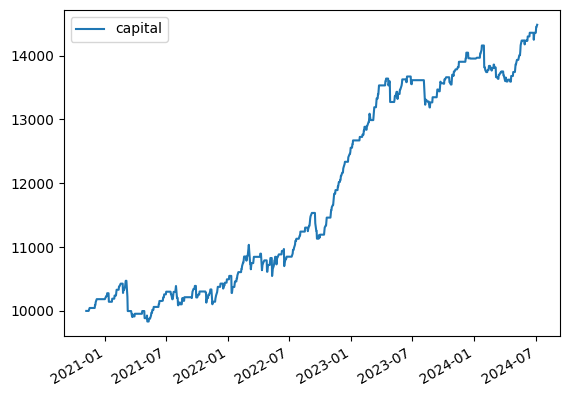

In [287]:
capital.rolling(5).sum().plot.line()
print(capital[-5:].sum())

## Debug optimal strategy with k=6 max trades per day

In [288]:
sim_params = SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=6, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)

res, capital_6trades = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=6, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)
 Count bids 4902 in total, avg.bids per day 5.428571428571429,  filled bids 1497, fill bids percent = 0.3053855569155447
  Stop loss events: count = 36, net loss = -1612.6325948300437 
  Take profit events: count = 1099, net profit = 9644.152015316591 
  Start capital = 10000, Resulting capital: 14677.021851022128 
  CAGR in 4 years: 1.101 or 10.07 % of avg. growth per year


In [289]:
# actual loss if wait till the end (0.848) vs. stop_loss (0.86) --> only a very slight defence
filter_stop_loss = (res.lower_entry==1) & (res.stop_loss==1)
print(f'Average real close price if not stop_loss: {res[filter_stop_loss].growth_future_5d.mean()}')
res[filter_stop_loss].head(10)

Average real close price if not stop_loss: 0.8628197710342068


,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
443,13.808842,NVDA,2021-03-01,1.000000,2.0,0.837557,1.008412,0.845781,0.970103,0.480000,0.250000,522.042756,1,1,0,454.177197,-1.044086,453.133112
445,239.476669,TSLA,2021-03-01,1.000000,1.0,0.783653,1.003730,0.750929,0.953468,0.480000,0.250000,522.042756,1,1,0,454.177197,-1.044086,453.133112
1470,387.646667,TSLA,2021-11-08,0.758621,6.0,0.871403,1.029288,0.848978,0.869796,0.238621,0.154680,340.120896,1,1,1,348.623919,-0.680242,347.943677
1560,381.586670,TSLA,2021-11-30,1.000000,5.0,0.918752,1.024529,0.830305,0.952829,0.480000,0.166667,369.739496,1,1,1,321.673361,-0.739479,320.933882
1594,31.778069,NVDA,2021-12-08,0.821678,5.0,0.957048,1.016110,0.857510,0.957516,0.301678,0.154411,296.375569,1,1,1,303.784958,-0.592751,303.192207
1688,399.926666,TSLA,2022-01-03,1.000000,3.0,0.881928,1.006851,0.841821,0.936047,0.480000,0.166667,335.385097,1,1,0,291.785035,-0.670770,291.114265
1739,25.863985,NVDA,2022-01-18,1.000000,2.0,0.861831,1.029926,0.807610,0.968606,0.480000,0.333333,640.900721,1,1,1,557.583627,-1.281801,556.301826
1741,128.270004,AMD,2022-01-19,1.000000,3.0,0.863101,1.049115,0.838076,0.946519,0.480000,0.250000,543.179121,1,1,1,472.565836,-1.086358,471.479477
1743,25.029243,NVDA,2022-01-19,1.000000,2.0,0.908445,1.060479,0.834544,0.961995,0.480000,0.250000,543.179121,1,1,1,472.565836,-1.086358,471.479477
1762,310.000000,TSLA,2022-01-24,0.970760,5.0,1.007226,1.062032,0.851624,0.971194,0.450760,0.166667,359.450077,1,1,1,312.721567,-0.718900,312.002667


In [290]:
filter_take_profit = (res.lower_entry==1) & (res.take_profit==1) & (res.stop_loss==0)
print(f'Average real close price if not take_profit: {res[filter_take_profit].growth_future_5d.mean()}')
res[filter_take_profit].head(10)

Average real close price if not take_profit: 0.9989594430916795


,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
14,88.023979,GOOGL,2020-11-05,1.000000,3.0,0.988834,1.032043,0.974803,0.986481,0.480000,0.166667,333.333333,1,0,1,341.666667,-0.666667,341.000000
17,146.029999,TSLA,2020-11-05,1.000000,5.0,0.939898,1.032893,0.903992,0.968477,0.480000,0.166667,333.333333,1,0,1,341.666667,-0.666667,341.000000
23,143.316666,TSLA,2020-11-06,1.000000,5.0,0.950111,1.052448,0.921107,0.979184,0.480000,0.166667,333.333333,1,0,1,341.666667,-0.666667,341.000000
26,352.400574,INTU,2020-11-09,1.000000,3.0,0.991448,1.070231,0.962967,0.962967,0.480000,0.202247,404.494382,1,0,1,414.606742,-0.808989,413.797753
27,470.500000,NFLX,2020-11-09,1.000000,1.0,1.018278,1.055303,0.984931,0.984931,0.480000,0.202247,404.494382,1,0,1,414.606742,-0.808989,413.797753
35,156.869507,AMZN,2020-11-11,0.986667,2.0,0.989823,1.016530,0.972146,0.983636,0.466667,0.166667,333.333333,1,0,1,341.666667,-0.666667,341.000000
40,139.043335,TSLA,2020-11-11,0.986667,3.0,1.166639,1.107568,0.962913,0.981756,0.466667,0.166667,333.333333,1,0,1,341.666667,-0.666667,341.000000
45,13.420794,NVDA,2020-11-12,0.991736,6.0,0.998774,1.025722,0.973061,0.973061,0.471736,0.166181,328.582494,1,0,1,336.797056,-0.657165,336.139891
46,137.253326,TSLA,2020-11-12,0.991736,5.0,1.212527,1.204585,0.975471,0.975471,0.471736,0.166181,328.582494,1,0,1,336.797056,-0.657165,336.139891
47,156.440506,AMZN,2020-11-13,0.986667,4.0,0.990600,1.019317,0.982063,0.982063,0.466667,0.165094,324.520378,1,0,1,332.633387,-0.649041,331.984346


In [291]:
# predicted growth is -2..-3% negative on mean and median, realised growth is -1..-2% negative
filter_no_stop_loss_no_take_profit = (res.lower_entry==1) & (res.take_profit==0) & (res.stop_loss==0)
print(f'Average real close price if no take_profit or stop loss: {res[filter_no_stop_loss_no_take_profit].growth_future_5d.mean()}')
res['realised_profit'] = res.future_net_return/res.investment
res[filter_no_stop_loss_no_take_profit][['growth_future_5d','realised_profit']].describe().T

Average real close price if no take_profit or stop loss: 0.965395090146133


,count,mean,std,min,25%,50%,75%,max
growth_future_5d,383.0,0.965395,0.038812,0.836326,0.94028,0.972265,0.992988,1.076831
realised_profit,383.0,0.973395,0.038812,0.844326,0.94828,0.980265,1.000988,1.084831


capital    14677.021851
dtype: float64


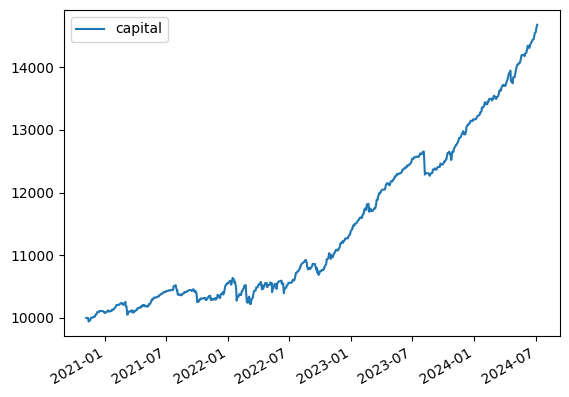

In [292]:
capital_6trades.rolling(5).sum().plot.line()
print(capital_6trades[-5:].sum())

## Debug optimal strategy with k=1 max trades per day

In [293]:
sim_params = SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)

res, capital_1_trade = simulate(new_df, sim_params)

SIMULATION STARTED
Simulations params: SimulationParams(initial_capital=10000, threshold=0.53, fees=0.002, top_k=1, portfolio_optimization=False, stop_loss=0.86, take_profit=1.015, lower_entry=0.99)
 Count bids 903 in total, avg.bids per day 1.0,  filled bids 301, fill bids percent = 0.3333333333333333
  Stop loss events: count = 7, net loss = -1669.7728728640432 
  Take profit events: count = 217, net profit = 11795.668495416758 
  Start capital = 10000, Resulting capital: 16090.600097653412 
  CAGR in 4 years: 1.126 or 12.63 % of avg. growth per year


In [294]:
# NO STOP LOSS events
filter_stop_loss = (res.lower_entry==1) & (res.stop_loss==1)
print(f'Average real close price if not stop_loss: {res[filter_stop_loss].growth_future_5d.mean()}')
res[filter_stop_loss].head(10)

Average real close price if not stop_loss: 0.8306567425093182


,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
79,239.476669,TSLA,2021-03-01,1.000000,1.0,0.783653,1.003730,0.750929,0.953468,0.480000,1.0,2240.826151,1,1,0,1949.518752,-4.481652,1945.037099
365,103.660004,PYPL,2022-04-19,1.000000,1.0,0.807447,1.011576,0.814393,0.910959,0.480000,1.0,1590.095843,1,1,0,1383.383384,-3.180192,1380.203192
376,317.540009,TSLA,2022-05-04,1.000000,1.0,0.770507,1.003023,0.812759,0.900359,0.480000,1.0,2515.414323,1,1,0,2188.410461,-5.030829,2183.379633
399,87.510002,PYPL,2022-06-08,1.000000,1.0,0.866530,1.020683,0.816535,0.960690,0.480000,1.0,1295.920482,1,1,1,1127.450819,-2.591841,1124.858978
400,84.110001,PYPL,2022-06-09,1.000000,1.0,0.846867,1.047795,0.849542,0.930329,0.480000,1.0,2337.524416,1,1,1,2033.646242,-4.675049,2028.971193
676,75.820000,PYPL,2023-07-31,0.666667,1.0,0.849644,1.009496,0.826418,0.983382,0.146667,1.0,3122.797005,1,1,0,2716.833395,-6.245594,2710.587801
858,493.010498,META,2024-04-24,1.000000,1.0,0.889949,1.034461,0.840753,0.840753,0.480000,1.0,2598.584882,1,1,1,2663.549504,-5.197170,2658.352335


In [295]:
# actual growth of 0.4% if no take profit vs. take_profit 1.5% (+1% from lower entry)
filter_take_profit = (res.lower_entry==1) & (res.take_profit==1) & (res.stop_loss==0)
print(f'Average real close price if not take_profit: {res[filter_take_profit].growth_future_5d.mean()}')
res[filter_take_profit].head(5)

Average real close price if not take_profit: 0.9944983825128083


,Adj Close_x,Ticker,Date,proba_pred7,pred7_rank,growth_future_5d,Ratio_MaxHighNext5_to_AdjClose,Ratio_MinLowNext5_to_AdjClose,Ratio_MinLowNext1_to_AdjClose,weight,weight_norm,investment,lower_entry,stop_loss,take_profit,future_gross_return,fees,future_net_return
4,470.500000,NFLX,2020-11-09,1.0,1.0,1.018278,1.055303,0.984931,0.984931,0.48,1.0,2000.0,1,0,1,2050.0,-4.0,2046.0
15,185.126663,TSLA,2020-11-24,1.0,1.0,1.024200,1.094386,0.947459,0.981976,0.48,1.0,2000.0,1,0,1,2050.0,-4.0,2046.0
17,159.766998,AMZN,2020-11-27,1.0,1.0,0.989748,1.016778,0.978159,0.978159,0.48,1.0,2000.0,1,0,1,2050.0,-4.0,2046.0
18,13.365689,NVDA,2020-11-30,1.0,1.0,1.015615,1.023030,0.970563,0.989717,0.48,1.0,2000.0,1,0,1,2050.0,-4.0,2046.0
36,12.962855,NVDA,2020-12-24,1.0,1.0,1.009216,1.019355,0.984602,0.984602,0.48,1.0,2000.0,1,0,1,2050.0,-4.0,2046.0


In [296]:
# predicted growth is -2..-3% negative on mean and median, realised growth is -1..-2% negative
filter_no_stop_loss_no_take_profit = (res.lower_entry==1) & (res.take_profit==0) & (res.stop_loss==0)
print(f'Average real close price if no take_profit or stop loss: {res[filter_no_stop_loss_no_take_profit].growth_future_5d.mean()}')
res['realised_profit'] = res.future_net_return/res.investment
res[filter_no_stop_loss_no_take_profit][['growth_future_5d','realised_profit']].describe().T

Average real close price if no take_profit or stop loss: 0.9667218307465084


,count,mean,std,min,25%,50%,75%,max
growth_future_5d,80.0,0.966722,0.031812,0.852006,0.953471,0.972849,0.988213,1.025062
realised_profit,80.0,0.974722,0.031812,0.860006,0.961471,0.980849,0.996213,1.033062


capital    16090.600098
dtype: float64


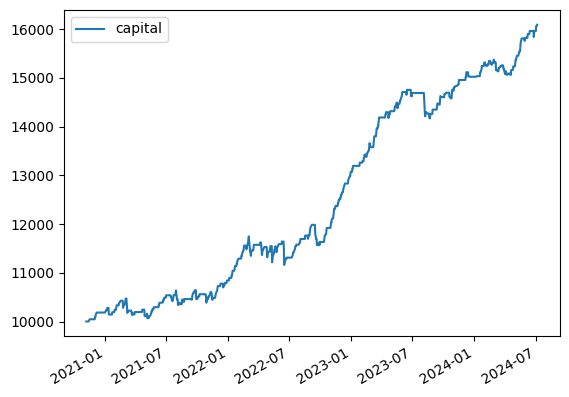

In [297]:
capital_1_trade.rolling(5).sum().plot.line()
print(capital_1_trade[-5:].sum())

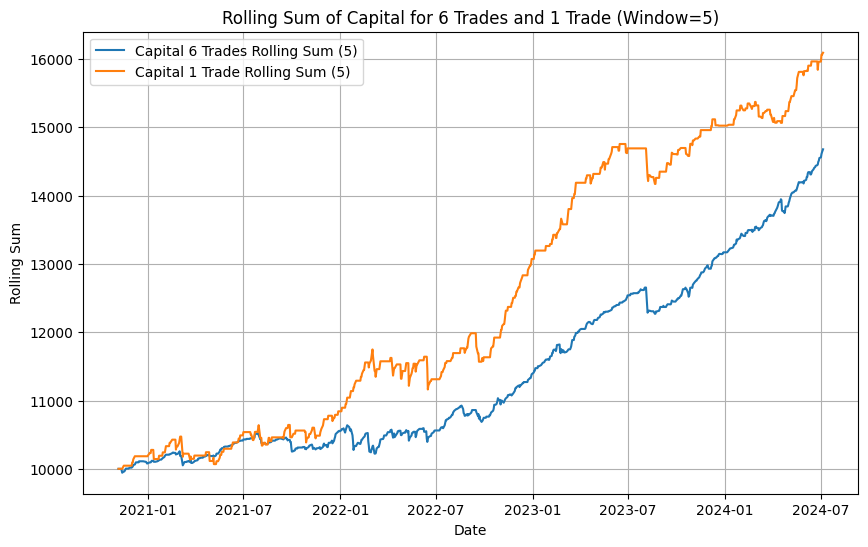

Capital 6 Trades Ending Sum: capital    14677.021851
dtype: float64
Capital 1 Trade Ending Sum: capital    16090.600098
dtype: float64


In [298]:
import matplotlib.pyplot as plt

# Assuming capital_6trades and capital_1_trade are defined and have the same index
capital_6trades_rolling = capital_6trades.rolling(5).sum()
capital_1_trade_rolling = capital_1_trade.rolling(5).sum()

# Plot the rolling sums on the same graph
plt.figure(figsize=(10, 6))
plt.plot(capital_6trades_rolling, label='Capital 6 Trades Rolling Sum (5)')
plt.plot(capital_1_trade_rolling, label='Capital 1 Trade Rolling Sum (5)')
plt.legend(loc='best')
plt.title('Rolling Sum of Capital for 6 Trades and 1 Trade (Window=5)')
plt.xlabel('Date')
plt.ylabel('Rolling Sum')
plt.grid(True)
plt.show()

# Print the ending values
print(f"Capital 6 Trades Ending Sum: {capital_6trades[-5:].sum()}")
print(f"Capital 1 Trade Ending Sum: {capital_1_trade[-5:].sum()}")